#Predicao Nowcastig Pib

Este trabalho tem como objetivo a predicao do PIB brasileiro atraves da tecnica de nowcasting. O Nowcasting é uma abordagem moderna para monitorar as condições econômicas em tempo real.
Diferentemente das técnicas de previsão tradicionais, o nowcasting está preocupado em prever
os indicadores enquanto estamos dentro do período de referência, ou logo após eles. O método
mais utilizado por trás dessas previsões é o modelo de fator dinâmico, que condensa a informação
de numerosas séries de dados em um pequeno número de fatores.



In [1]:
pip install --upgrade xlrd

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.5/96.5 KB 4.0 MB/s eta 0:00:00
  Attempting uninstall: xlrd
    Found existing installation: xlrd 1.2.0
    Uninstalling xlrd-1.2.0:
      Successfully uninstalled xlrd-1.2.0


In [2]:
!pip install --upgrade pandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.2/12.2 MB 38.9 MB/s eta 0:00:00
  Attempting uninstall: pandas
    Found existing installation: pandas 1.3.5
    Uninstalling pandas-1.3.5:
      Successfully uninstalled pandas-1.3.5


In [3]:
!pip install python-bcb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.5/71.5 KB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 KB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.6/69.6 KB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.6/80.6 KB 10.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 KB 2.1 MB/s eta 0:00:00
  Attempting uninstall: requests
    Found existing installation: requests 2.25.1
    Uninstalling requests-2.25.1:
      Successfully uninstalled requests-2.25.1


In [ ]:
!pip install pmdarima
##Solucao https://blog.csdn.net/qq_49821869/article/details/128540436
import os
os.kill(os.getpid(),9)


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 47.2 MB/s eta 0:00:00


#Importacao das bibliotecas

In [1]:
!pip install sidrapy
import sidrapy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import date
from pmdarima import arima
import plotly.express as ploty
from datetime import datetime
from datetime import timedelta
import plotly.express as px
import plotly.graph_objs as go
import random

In [3]:
## testes de aderencia e estacionaridades
#https://www.statsmodels.org/dev/examples/notebooks/generated/stationarity_detrending_adf_kpss.html
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import kpss

In [4]:
pd.options.display.float_format = '{:.2f}'.format

In [5]:
%matplotlib inline
sns.set(rc={'figure.figsize':(20,10)})

#Importando dados

In [6]:
data_inicio = '2000-03-01'

##Dados IPEADATA
Rendimento bruto real médio - PNADC; Pessoas
na força de trabalho - PNADC; Taxa de desocupação - PNADC; CAGED; Ibovespa; LTN - 12
meses; Exportações; Importações; Meio de Pagamento(M1); Taxa de câmbio; Índice de Atividade
Econômica do Banco Central.

In [7]:
!pip install ipeadatapy
import ipeadatapy as ip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


###Dados de Rendimento Bruto Medio 
codigo PNADC12_RRTH12

In [8]:
rendimento_real_medio = ip.timeseries('PNADC12_RRTH12')
rendimento_real_medio

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE (R$ Penúltimo mês da série)
DATE,,,,,,
2012-03-01,PNADC12_RRTH12,2012-03-01T00:00:00-03:00,1,3,2012,2667.00
2012-04-01,PNADC12_RRTH12,2012-04-01T00:00:00-03:00,1,4,2012,2677.00
2012-05-01,PNADC12_RRTH12,2012-05-01T00:00:00-03:00,1,5,2012,2670.00
2012-06-01,PNADC12_RRTH12,2012-06-01T00:00:00-03:00,1,6,2012,2676.00
2012-07-01,PNADC12_RRTH12,2012-07-01T00:00:00-03:00,1,7,2012,2689.00
...,...,...,...,...,...,...
2022-08-01,PNADC12_RRTH12,2022-08-01T00:00:00-03:00,1,8,2022,2721.00
2022-09-01,PNADC12_RRTH12,2022-09-01T00:00:00-03:00,1,9,2022,2757.00
2022-10-01,PNADC12_RRTH12,2022-10-01T00:00:00-03:00,1,10,2022,2775.00


###Pessoas na força de trabalho
codigo PNADC12_FT12

In [9]:
pessoas_forca_trabalho = ip.timeseries('PNADC12_FT12')
pessoas_forca_trabalho

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE (Pessoa)
DATE,,,,,,
2012-03-01,PNADC12_FT12,2012-03-01T00:00:00-03:00,1,3,2012,95664.00
2012-04-01,PNADC12_FT12,2012-04-01T00:00:00-03:00,1,4,2012,96380.00
2012-05-01,PNADC12_FT12,2012-05-01T00:00:00-03:00,1,5,2012,96823.00
2012-06-01,PNADC12_FT12,2012-06-01T00:00:00-03:00,1,6,2012,97010.00
2012-07-01,PNADC12_FT12,2012-07-01T00:00:00-03:00,1,7,2012,97076.00
...,...,...,...,...,...,...
2022-08-01,PNADC12_FT12,2022-08-01T00:00:00-03:00,1,8,2022,108706.00
2022-09-01,PNADC12_FT12,2022-09-01T00:00:00-03:00,1,9,2022,108729.00
2022-10-01,PNADC12_FT12,2022-10-01T00:00:00-03:00,1,10,2022,108684.00


###Taxa de desocupação

codigo PNADC12_TDESOC12

In [10]:
taxa_desocupacao = ip.timeseries('PNADC12_TDESOC12')
taxa_desocupacao

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE ((%))
DATE,,,,,,
2012-03-01,PNADC12_TDESOC12,2012-03-01T00:00:00-03:00,1,3,2012,8.00
2012-04-01,PNADC12_TDESOC12,2012-04-01T00:00:00-03:00,1,4,2012,7.80
2012-05-01,PNADC12_TDESOC12,2012-05-01T00:00:00-03:00,1,5,2012,7.70
2012-06-01,PNADC12_TDESOC12,2012-06-01T00:00:00-03:00,1,6,2012,7.60
2012-07-01,PNADC12_TDESOC12,2012-07-01T00:00:00-03:00,1,7,2012,7.50
...,...,...,...,...,...,...
2022-08-01,PNADC12_TDESOC12,2022-08-01T00:00:00-03:00,1,8,2022,8.90
2022-09-01,PNADC12_TDESOC12,2022-09-01T00:00:00-03:00,1,9,2022,8.70
2022-10-01,PNADC12_TDESOC12,2022-10-01T00:00:00-03:00,1,10,2022,8.30


###Caged

In [11]:
caged_novo = ip.timeseries('CAGED12_SALDON12')
caged_novo

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE (Pessoa)
DATE,,,,,,
2020-01-01,CAGED12_SALDON12,2020-01-01T00:00:00-03:00,1,1,2020,92678.00
2020-02-01,CAGED12_SALDON12,2020-02-01T00:00:00-03:00,1,2,2020,198368.00
2020-03-01,CAGED12_SALDON12,2020-03-01T00:00:00-03:00,1,3,2020,-232316.00
2020-04-01,CAGED12_SALDON12,2020-04-01T00:00:00-03:00,1,4,2020,-902317.00
2020-05-01,CAGED12_SALDON12,2020-05-01T00:00:00-03:00,1,5,2020,-352790.00
2020-06-01,CAGED12_SALDON12,2020-06-01T00:00:00-03:00,1,6,2020,-23111.00
2020-07-01,CAGED12_SALDON12,2020-07-01T00:00:00-03:00,1,7,2020,123297.00
2020-08-01,CAGED12_SALDON12,2020-08-01T00:00:00-03:00,1,8,2020,238125.00
2020-09-01,CAGED12_SALDON12,2020-09-01T00:00:00-03:00,1,9,2020,313564.00


In [12]:
caged_antigo = ip.timeseries('CAGED12_SALDO12')
caged_antigo

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE (Pessoa)
DATE,,,,,,
1999-05-01,CAGED12_SALDO12,1999-05-01T00:00:00-03:00,1,5,1999,97182.00
1999-06-01,CAGED12_SALDO12,1999-06-01T00:00:00-03:00,1,6,1999,58109.00
1999-07-01,CAGED12_SALDO12,1999-07-01T00:00:00-03:00,1,7,1999,8057.00
1999-08-01,CAGED12_SALDO12,1999-08-01T00:00:00-03:00,1,8,1999,13306.00
1999-09-01,CAGED12_SALDO12,1999-09-01T00:00:00-03:00,1,9,1999,7207.00
...,...,...,...,...,...,...
2019-08-01,CAGED12_SALDO12,2019-08-01T00:00:00-03:00,1,8,2019,121387.00
2019-09-01,CAGED12_SALDO12,2019-09-01T00:00:00-03:00,1,9,2019,157213.00
2019-10-01,CAGED12_SALDO12,2019-10-01T00:00:00-03:00,1,10,2019,70852.00


In [13]:
caged = pd.concat([caged_antigo,caged_novo],axis=0)
caged

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE (Pessoa)
DATE,,,,,,
1999-05-01,CAGED12_SALDO12,1999-05-01T00:00:00-03:00,1,5,1999,97182.00
1999-06-01,CAGED12_SALDO12,1999-06-01T00:00:00-03:00,1,6,1999,58109.00
1999-07-01,CAGED12_SALDO12,1999-07-01T00:00:00-03:00,1,7,1999,8057.00
1999-08-01,CAGED12_SALDO12,1999-08-01T00:00:00-03:00,1,8,1999,13306.00
1999-09-01,CAGED12_SALDO12,1999-09-01T00:00:00-03:00,1,9,1999,7207.00
...,...,...,...,...,...,...
2022-08-01,CAGED12_SALDON12,2022-08-01T00:00:00-03:00,1,8,2022,278639.00
2022-09-01,CAGED12_SALDON12,2022-09-01T00:00:00-03:00,1,9,2022,278085.00
2022-10-01,CAGED12_SALDON12,2022-10-01T00:00:00-03:00,1,10,2022,159454.00


###Ibovespa 
codigo ANBIMA12_IBVSP12

In [14]:
ibovespa = ip.timeseries('ANBIMA12_IBVSP12')
ibovespa

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE ((% a.m.))
DATE,,,,,,
1968-02-01,ANBIMA12_IBVSP12,1968-02-01T00:00:00-02:00,1,2,1968,14.09
1968-03-01,ANBIMA12_IBVSP12,1968-03-01T00:00:00-03:00,1,3,1968,9.50
1968-04-01,ANBIMA12_IBVSP12,1968-04-01T00:00:00-03:00,1,4,1968,22.11
1968-05-01,ANBIMA12_IBVSP12,1968-05-01T00:00:00-03:00,1,5,1968,8.63
1968-06-01,ANBIMA12_IBVSP12,1968-06-01T00:00:00-03:00,1,6,1968,-8.72
...,...,...,...,...,...,...
2022-08-01,ANBIMA12_IBVSP12,2022-08-01T00:00:00-03:00,1,8,2022,0.19
2022-09-01,ANBIMA12_IBVSP12,2022-09-01T00:00:00-03:00,1,9,2022,0.47
2022-10-01,ANBIMA12_IBVSP12,2022-10-01T00:00:00-03:00,1,10,2022,5.74


###Letra Tesouro Nacional 12 meses

codigo = ANBIMA12_TJTLN1212

In [15]:
ltn = ip.timeseries('ANBIMA12_TJTLN1212')
ltn

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE ((% a.a.))
DATE,,,,,,
2000-04-01,ANBIMA12_TJTLN1212,2000-04-01T00:00:00-03:00,1,4,2000,19.47
2000-05-01,ANBIMA12_TJTLN1212,2000-05-01T00:00:00-03:00,1,5,2000,21.68
2000-06-01,ANBIMA12_TJTLN1212,2000-06-01T00:00:00-03:00,1,6,2000,19.54
2000-07-01,ANBIMA12_TJTLN1212,2000-07-01T00:00:00-03:00,1,7,2000,18.29
2000-08-01,ANBIMA12_TJTLN1212,2000-08-01T00:00:00-03:00,1,8,2000,17.25
...,...,...,...,...,...,...
2022-10-01,ANBIMA12_TJTLN1212,2022-10-01T00:00:00-03:00,1,10,2022,13.10
2022-11-01,ANBIMA12_TJTLN1212,2022-11-01T00:00:00-03:00,1,11,2022,13.82
2022-12-01,ANBIMA12_TJTLN1212,2022-12-01T00:00:00-03:00,1,12,2022,13.73


###Exportações
CODIGO PAN12_XTV12

In [16]:
exportacoes = ip.timeseries('PAN12_XTV12')
exportacoes

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE (US$)
DATE,,,,,,
1995-01-01,PAN12_XTV12,1995-01-01T00:00:00-02:00,1,1,1995,2970.12
1995-02-01,PAN12_XTV12,1995-02-01T00:00:00-02:00,1,2,1995,2945.83
1995-03-01,PAN12_XTV12,1995-03-01T00:00:00-03:00,1,3,1995,3786.86
1995-04-01,PAN12_XTV12,1995-04-01T00:00:00-03:00,1,4,1995,3382.44
1995-05-01,PAN12_XTV12,1995-05-01T00:00:00-03:00,1,5,1995,4200.08
...,...,...,...,...,...,...
2022-10-01,PAN12_XTV12,2022-10-01T00:00:00-03:00,1,10,2022,27558.40
2022-11-01,PAN12_XTV12,2022-11-01T00:00:00-03:00,1,11,2022,28376.47
2022-12-01,PAN12_XTV12,2022-12-01T00:00:00-03:00,1,12,2022,27059.75


###Importacoes 
Codigo PAN12_MTV12

In [17]:
importacoes = ip.timeseries('PAN12_MTV12')
importacoes

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE (US$)
DATE,,,,,,
1995-01-01,PAN12_MTV12,1995-01-01T00:00:00-02:00,1,1,1995,3368.85
1995-02-01,PAN12_MTV12,1995-02-01T00:00:00-02:00,1,2,1995,4097.46
1995-03-01,PAN12_MTV12,1995-03-01T00:00:00-03:00,1,3,1995,4806.34
1995-04-01,PAN12_MTV12,1995-04-01T00:00:00-03:00,1,4,1995,3948.13
1995-05-01,PAN12_MTV12,1995-05-01T00:00:00-03:00,1,5,1995,4981.78
...,...,...,...,...,...,...
2022-09-01,PAN12_MTV12,2022-09-01T00:00:00-03:00,1,9,2022,28184.70
2022-10-01,PAN12_MTV12,2022-10-01T00:00:00-03:00,1,10,2022,25549.05
2022-11-01,PAN12_MTV12,2022-11-01T00:00:00-03:00,1,11,2022,23707.81


###Meio de Pagamento(M1)
Codigo BM12_M1MN12

In [18]:
m_1 = ip.timeseries('BM12_M1MN12')
m_1

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE (R$)
DATE,,,,,,
1980-01-01,BM12_M1MN12,1980-01-01T00:00:00-02:00,1,1,1980,0.00
1980-02-01,BM12_M1MN12,1980-02-01T00:00:00-02:00,1,2,1980,0.00
1980-03-01,BM12_M1MN12,1980-03-01T00:00:00-03:00,1,3,1980,0.00
1980-04-01,BM12_M1MN12,1980-04-01T00:00:00-03:00,1,4,1980,0.00
1980-05-01,BM12_M1MN12,1980-05-01T00:00:00-03:00,1,5,1980,0.00
...,...,...,...,...,...,...
2022-09-01,BM12_M1MN12,2022-09-01T00:00:00-03:00,1,9,2022,593585.62
2022-10-01,BM12_M1MN12,2022-10-01T00:00:00-03:00,1,10,2022,588230.10
2022-11-01,BM12_M1MN12,2022-11-01T00:00:00-03:00,1,11,2022,588079.72


###Taxa de câmbio
Codigo PAN12_ERV12

In [19]:
taxa_cambio = ip.timeseries('PAN12_ERV12')
taxa_cambio

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE (R$)
DATE,,,,,,
1930-01-01,PAN12_ERV12,1930-01-01T00:00:00-02:00,1,1,1930,0.00
1930-02-01,PAN12_ERV12,1930-02-01T00:00:00-02:00,1,2,1930,0.00
1930-03-01,PAN12_ERV12,1930-03-01T00:00:00-03:00,1,3,1930,0.00
1930-04-01,PAN12_ERV12,1930-04-01T00:00:00-03:00,1,4,1930,0.00
1930-05-01,PAN12_ERV12,1930-05-01T00:00:00-03:00,1,5,1930,0.00
...,...,...,...,...,...,...
2022-10-01,PAN12_ERV12,2022-10-01T00:00:00-03:00,1,10,2022,5.25
2022-11-01,PAN12_ERV12,2022-11-01T00:00:00-03:00,1,11,2022,5.27
2022-12-01,PAN12_ERV12,2022-12-01T00:00:00-03:00,1,12,2022,5.24


###Indice de Atividade Economica do Banco do Brasil

Codigo SGS12_IBCBR12

In [20]:
atividade_economica = ip.timeseries('SGS12_IBCBR12')
atividade_economica

,CODE,RAW DATE,DAY,MONTH,YEAR,VALUE (-)
DATE,,,,,,
1990-01-01,SGS12_IBCBR12,1990-01-01T00:00:00-02:00,1,1,1990,NaN
1990-02-01,SGS12_IBCBR12,1990-02-01T00:00:00-02:00,1,2,1990,NaN
1990-03-01,SGS12_IBCBR12,1990-03-01T00:00:00-03:00,1,3,1990,NaN
1990-04-01,SGS12_IBCBR12,1990-04-01T00:00:00-03:00,1,4,1990,NaN
1990-05-01,SGS12_IBCBR12,1990-05-01T00:00:00-03:00,1,5,1990,NaN
...,...,...,...,...,...,...
2022-09-01,SGS12_IBCBR12,2022-09-01T00:00:00-03:00,1,9,2022,144.64
2022-10-01,SGS12_IBCBR12,2022-10-01T00:00:00-03:00,1,10,2022,142.79
2022-11-01,SGS12_IBCBR12,2022-11-01T00:00:00-03:00,1,11,2022,141.55


##Seguro Desemprego (Google trends)
https://morioh.com/p/ba56e539c7c0

In [21]:
!pip install pytrends 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [22]:
from pytrends.request import TrendReq
import pandas as pd
import time

# Definindo os termos de pesquisa
kw_list = ['seguro desemprego']

# Definindo as datas de início e fim da pesquisa
start_date = '2004-01-01'
end_date = str(date.today())

# Dividindo a pesquisa em vários períodos de 5 anos
periods = pd.date_range(start=start_date, end=end_date, freq='5Y')
if periods[-1] < pd.to_datetime(end_date):
    periods = periods.append(pd.Index([pd.to_datetime(end_date)]))

# Criando uma instância do TrendReq
pytrends = TrendReq()

# Fazendo a pesquisa para cada período de 5 anos
data = pd.DataFrame()
for i in range(len(periods)-1):
    timeframe = f"{periods[i].strftime('%Y-%m-%d')} {periods[i+1].strftime('%Y-%m-%d')}"
    pytrends.build_payload(kw_list, timeframe=timeframe)
    temp_data = pytrends.interest_over_time()
    data = pd.concat([data, temp_data])

    # Aguardando alguns segundos para evitar sobrecarga no servidor do Google Trends
    time.sleep(5)

data = data.resample('MS').sum()
# Imprimindo os resultados em uma célula
print("Resultados da pesquisa para 'seguro desemprego':")
data


Resultados da pesquisa para 'seguro desemprego':


,seguro desemprego,isPartial
date,,
2005-01-01,75,0
2005-02-01,58,0
2005-03-01,60,0
2005-04-01,69,0
2005-05-01,89,0
...,...,...
2022-10-01,121,0
2022-11-01,90,0
2022-12-01,80,0


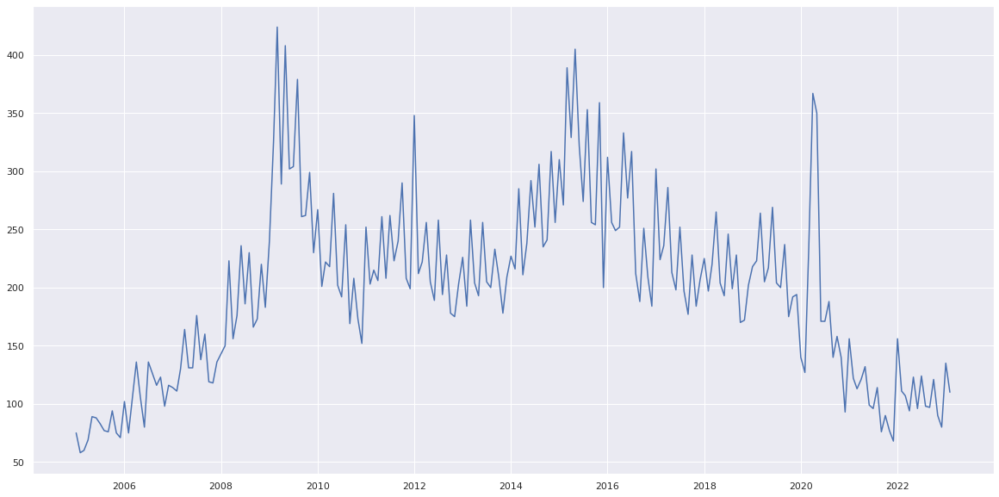

In [23]:
# plot it
plt.plot(data['seguro desemprego']);


##Dados do QUANDL


In [24]:
!pip install quandl


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [25]:
import quandl
quandl.ApiConfig.api_key = 'your Keys'

###Indices de Mercado Emergente

Codigo NASDAQOMX/NQEM

In [26]:
emergentes = quandl.get('NASDAQOMX/NQEM')
emergentes = emergentes.resample('MS').mean()
emergentes

,Index Value,High,Low,Total Market Value,Dividend Market Value
Trade Date,,,,,
2001-03-01,305.29,0.00,0.00,577751098517.00,0.00
2001-04-01,298.35,0.00,0.00,564617113991.00,0.00
2001-05-01,311.09,0.00,0.00,588716581263.09,0.00
2001-06-01,304.87,0.00,0.00,576951172662.48,0.00
2001-07-01,279.66,0.00,0.00,527146390930.14,0.00
...,...,...,...,...,...
2021-03-01,1316.47,1322.82,1309.99,6485209131057.78,476482347.09
2021-04-01,1330.19,1333.94,1325.33,6689115594604.77,463089629.55
2021-05-01,1326.31,1330.27,1319.82,6682868732695.48,776092645.38


###PIB trimestral do Brasil

In [27]:
pib = quandl.get('OECD/KEI_NAEXKP01_BRA_GP_Q')
pib

,Value
Date,
1996-06-30,1.14
1996-09-30,3.72
1996-12-31,-0.96
1997-03-31,1.05
1997-06-30,0.53
...,...
2021-09-30,0.44
2021-12-31,0.86
2022-03-31,1.35


In [28]:
import pandas as pd

def trimestral_para_mensal(df):
  """
   A função recebe um DataFrame df com valores trimestrais do PIB. Primeiro, ela aplica a interpolação para obter os valores mensais, usando o método resample com uma frequência de 'M' e o método interpolate para preencher os valores faltantes. 
   Em seguida, ela percorre os valores de cada trimestre e distribui a variação trimestral em cada um dos três meses dentro do trimestre, adicionando um terço do valor trimestral aos dois meses intermediários. Finalmente, ela retorna o DataFrame 
   interpolado e transformado em mensal.
   """
  
  # Primeiro, definimos uma nova frequência mensal e aplicamos a interpolação
  df_mensal = df.resample('M').interpolate()
    
  # Em seguida, distribuímos a variação trimestral em cada um dos três meses dentro do trimestre
  for i in range(1, len(df)):
    if i % 3 != 0:
        val = df.iloc[i].values[0]
        month_val = val / 3
        df_mensal.iloc[i*2-1] += month_val
        df_mensal.iloc[i*2] += month_val
    
  return df_mensal


In [29]:
import datetime
pib_mensal = trimestral_para_mensal(pib)
pib_mensal.index = pib_mensal.index +datetime.timedelta(days=1)
pib_mensal

,Value
Date,
1996-07-01,1.14
1996-08-01,3.24
1996-09-01,4.10
1996-10-01,3.40
1996-11-01,1.84
...,...
2022-06-01,1.10
2022-07-01,0.98
2022-08-01,0.79


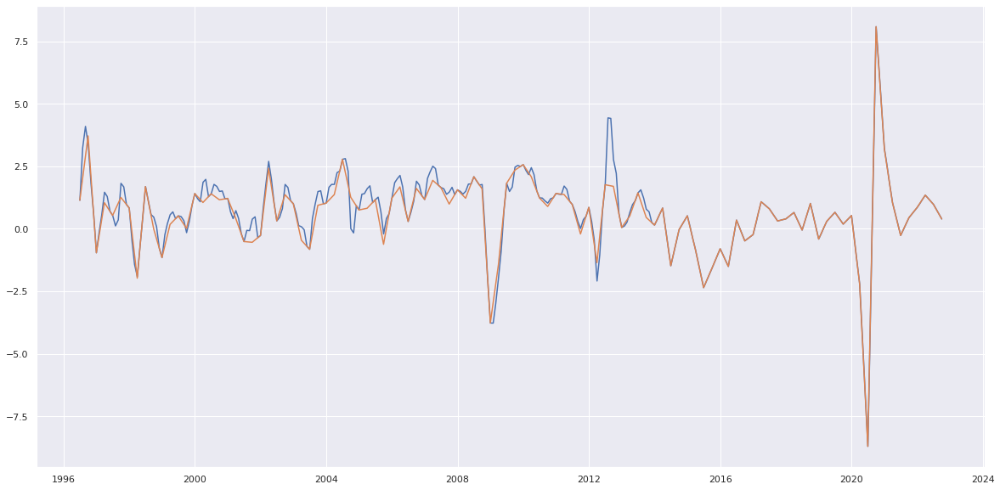

In [30]:
plt.plot(pib_mensal)
plt.plot(pib)

##Dados SIDRA

In [31]:
!pip install sidrapy
import sidrapy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [32]:
def transforme_data(data):
  from datetime import datetime

  months = {'janeiro': 'january', 'fevereiro': 'february', 'março': 'march',
          'abril': 'april', 'maio': 'may', 'junho': 'june',
          'julho': 'july', 'agosto': 'august', 'setembro': 'september',
          'outubro': 'october', 'novembro': 'november', 'dezembro': 'december'}

  lista_data = []
  for date in data.index:
      date_components = date.split(' ')
      formatted_month = months[date_components[0].lower()].capitalize()
      formatted_date = f"{formatted_month} {date_components[1]}"
      date_object = datetime.strptime(formatted_date, '%B %Y')
      lista_data.append(date_object.strftime('%Y-%m-%d'))
  data.index = lista_data
  return data

###Produção Física Industrial
/t/8159/n1/all/v/11599/p/all/c544/129314/d/v11599%205

In [33]:
#Covertendo datas
import pandas as pd
from datetime import datetime

def converter_mes_para_data(mes):
    mes_texto = str(mes)
    ano = int(mes_texto[:4])
    mes = int(mes_texto[4:])
    data = datetime(year=ano, month=mes, day=1)
    return data

In [34]:
producao_industrial = sidrapy.get_table(table_code = '8159',
                             territorial_level = '1',
                             ibge_territorial_code = 'all',
                             variable = '11599',
                             period = 'all')
producao_industrial.columns = producao_industrial.iloc[0]
producao_industrial = producao_industrial.iloc[1:]
producao_industrial['data'] = producao_industrial['Mês (Código)'].apply(converter_mes_para_data)
producao_industrial.index = producao_industrial['data']
producao_industrial.head()

,Nível Territorial (Código),Nível Territorial,Unidade de Medida (Código),Unidade de Medida,Valor,Brasil (Código),Brasil,Mês (Código),Mês,Variável (Código),Variável,Seções e atividades industriais (CNAE 2.0) (Código),Seções e atividades industriais (CNAE 2.0),data
data,,,,,,,,,,,,,,
2002-01-01,1,Brasil,30,Número-índice,72.39269,1,Brasil,200201,janeiro 2002,11599,PIMPF - Número-índice (2012=100),129314,1 Indústria geral,2002-01-01
2002-02-01,1,Brasil,30,Número-índice,69.71441,1,Brasil,200202,fevereiro 2002,11599,PIMPF - Número-índice (2012=100),129314,1 Indústria geral,2002-02-01
2002-03-01,1,Brasil,30,Número-índice,77.39979,1,Brasil,200203,março 2002,11599,PIMPF - Número-índice (2012=100),129314,1 Indústria geral,2002-03-01
2002-04-01,1,Brasil,30,Número-índice,79.59671,1,Brasil,200204,abril 2002,11599,PIMPF - Número-índice (2012=100),129314,1 Indústria geral,2002-04-01
2002-05-01,1,Brasil,30,Número-índice,80.44721,1,Brasil,200205,maio 2002,11599,PIMPF - Número-índice (2012=100),129314,1 Indústria geral,2002-05-01


###Produção indústrias de manufatureiras
t/8158/n1/all/v/11599/p/all/c543/129278/d/v11599%205

In [35]:
import pandas as pd

url = 'https://sidra.ibge.gov.br/geratabela?format=xlsx&name=tabela8158.xlsx&terr=N&rank=-&query=t/8158/n1/all/v/11599/p/all/c543/129278/d/v11599%205/l/v,p%2Bc543,t'

# carregar a tabela em um DataFrame
producao_industrial_manufatureira = pd.read_excel(url, header=3)

# exibir as primeiras linhas do DataFrame
producao_industrial_manufatureira = producao_industrial_manufatureira.T
producao_industrial_manufatureira = producao_industrial_manufatureira.iloc[1:]
producao_industrial_manufatureira = producao_industrial_manufatureira[[1]]
producao_industrial_manufatureira.columns = ['producao_industrial_manufatureira']
producao_industrial_manufatureira = transforme_data(producao_industrial_manufatureira)
producao_industrial_manufatureira = producao_industrial_manufatureira.astype(float)
producao_industrial_manufatureira.index = pd.to_datetime(producao_industrial_manufatureira.index)

In [36]:
producao_industrial_manufatureira.head()

,producao_industrial_manufatureira
2002-01-01,51.67
2002-02-01,50.39
2002-03-01,57.44
2002-04-01,61.18
2002-05-01,59.20


###Produção Física Industrial dos insumos típicos da construção civil
t/7980/n1/all/v/11599/p/all/d/v11599%205

In [37]:
construcao_cilvil=sidrapy.get_table(table_code = '7980',
                             territorial_level = '1',
                             ibge_territorial_code = 'all',
                             variable = '11599',
                             period = 'all')
construcao_cilvil.columns = construcao_cilvil.iloc[0]
construcao_cilvil = construcao_cilvil.iloc[1:]
construcao_cilvil['data'] = construcao_cilvil['Mês (Código)'].apply(converter_mes_para_data)
construcao_cilvil.index = pd.to_datetime(construcao_cilvil['data'])
construcao_cilvil = construcao_cilvil[['Valor']].astype(float)
construcao_cilvil.head()

,Valor
data,
2012-01-01,93.45
2012-02-01,93.61
2012-03-01,102.83
2012-04-01,95.05
2012-05-01,103.03


###Produção de Soja e Milho
#/t/6588/n1/all/v/35/p/all/c48/0,39441,39442,39443
https://sidra.ibge.gov.br/geratabela?format=xlsx&name=tabela6588.xlsx&terr=N&rank=-&query=t/6588/n1/all/v/35/p/all/c48/0,39441,39442,39443/l/v,p%2Bc48,t

In [38]:
def tratando(dados,nome):
  dados = dados.T
  dados = dados.iloc[1:]
  dados = dados[[1]]
  data = pd.DataFrame()
  data = dados.iloc[::2, :]
  data.loc[:, nome] = dados[dados.index.str.contains('Unnamed')].values.copy()
  data = transforme_data(data)
  data = data[[nome]]
  data.index = pd.to_datetime(data.index)
  return data

In [39]:
url_soja = 'https://sidra.ibge.gov.br/geratabela?format=xlsx&name=tabela6588.xlsx&terr=N&rank=-&query=t/6588/n1/all/v/35/p/all/c48/0,39443/l/v,p%2Bc48,t'
dados_soja = pd.read_excel(url_soja,header=3)
soja = tratando(dados_soja,'soja')
url_milho_1 = 'https://sidra.ibge.gov.br/geratabela?format=xlsx&name=tabela6588.xlsx&terr=N&rank=-&query=t/6588/n1/all/v/35/p/all/c48/0,39441/l/v,p%2Bc48,t'
milho_1=pd.read_excel(url_milho_1,header=3)
milho_1 = tratando(milho_1,'milho_primeira_safra')
url_milho_2 = 'https://sidra.ibge.gov.br/geratabela?format=xlsx&name=tabela6588.xlsx&terr=N&rank=-&query=t/6588/n1/all/v/35/p/all/c48/0,39442/l/v,p%2Bc48,t'
milho_2=pd.read_excel(url_milho_2,header=3)
milho_2 = tratando(milho_2,'milho_segunda_safra')
producao_agricola= soja.join([milho_1,milho_2])
producao_agricola['producao_agricola_total'] = producao_agricola.sum(axis=1)
producao_agricola.head()

<ipython-input-38-34216dd702dd>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.loc[:, nome] = dados[dados.index.str.contains('Unnamed')].values.copy()
<ipython-input-38-34216dd702dd>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.loc[:, nome] = dados[dados.index.str.contains('Unnamed')].values.copy()
<ipython-input-38-34216dd702dd>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cave

,soja,milho_primeira_safra,milho_segunda_safra,producao_agricola_total
2006-09-01,52381672,31477232,10595844,94454748.00
2006-10-01,52356720,31465468,10657512,94479700.00
2006-11-01,52223579,31414490,10657512,94295581.00
2006-12-01,52234589,31429528,11046437,94710554.00
2007-01-01,56395247,35477136,12219438,104091821.00


###Índice de preços da construção civíl

/t/2296/n1/all/v/1193/p/all/d/v1193%202

In [40]:
#/t/2296/n1/all/v/49/p/all/d/v49%202
preco_construcao = sidrapy.get_table(table_code = '2296',
                             territorial_level = '1',
                             ibge_territorial_code = 'all',
                             variable = '1198',
                             period = 'all')
preco_construcao.columns = preco_construcao.iloc[0]
preco_construcao = preco_construcao.iloc[1:]
preco_construcao['data'] = preco_construcao['Mês (Código)'].apply(converter_mes_para_data)
##Tirando dados faltantes
preco_construcao.index = pd.to_datetime(preco_construcao['data'])
preco_construcao = preco_construcao[preco_construcao.index >= '2012-09-01']
preco_construcao = preco_construcao[['Valor']].astype(float)
preco_construcao

,Valor
data,
2012-09-01,5.55
2012-10-01,5.51
2012-11-01,5.36
2012-12-01,5.68
2013-01-01,5.25
...,...
2022-09-01,13.11
2022-10-01,12.41
2022-11-01,11.38


###Volume de serviços - PMS

t/8162/n1/all/v/11621/p/all/c11046/56726/c12355/107071/d/v11621%205

In [41]:
url_pms = 'https://sidra.ibge.gov.br/geratabela?format=xlsx&name=tabela8162.xlsx&terr=N&rank=-&query=t/8162/n1/all/v/11622/p/all/c11046/56726/c12355/107071/d/v11622%205/l/v,p%2Bc11046,t%2Bc12355'
dados_pms = pd.read_excel(url_pms,header=3)
dados_pms = dados_pms.T
dados_pms = dados_pms.iloc[2:]
dados_pms = dados_pms[[1]]
dados_pms.columns = ['volume_servicos']
dados_pms = transforme_data(dados_pms)
dados_pms.index = pd.to_datetime(dados_pms.index)
dados_pms['volume_servicos'] = dados_pms['volume_servicos'].astype(float)
dados_pms

,volume_servicos
2011-01-01,88.58
2011-02-01,88.73
2011-03-01,88.34
2011-04-01,89.17
2011-05-01,89.80
...,...
2022-08-01,101.34
2022-09-01,102.05
2022-10-01,101.39
2022-11-01,101.01


###Inflacao

/t/118/n1/all/v/all/p/all/d/v306%202

In [42]:
inflacao = sidrapy.get_table(table_code = '118',
                             territorial_level = '1',
                             ibge_territorial_code = 'all',
                             variable = '306',
                             period = 'all')
inflacao.columns = inflacao.iloc[0]
inflacao = inflacao.iloc[1:]
inflacao['data'] = inflacao['Mês (Código)'].apply(converter_mes_para_data)
inflacao.index = inflacao['data']
inflacao = inflacao[['Valor']].astype(float)
inflacao.head()

,Valor
data,
1998-01-01,0.59
1998-02-01,0.44
1998-03-01,0.28
1998-04-01,0.17
1998-05-01,0.48


##Banco central 

Índice de Condições Econômicas Atuais - Fecomercio;  4394

Índice de Valores de
Garantia de Imóveis Residenciais Financiados; 21340

Vendas de veículos pelas concessionárias;;1378,

Indicador de Movimento do Comércio a Prazo; 1453

Índice volume de vendas no varejo.1455

In [43]:
!pip install python-bcb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [44]:
from bcb import sgs
dados_banco_central = sgs.get({'indice_condicoes_economicas':4394,'Garantia_Imóveis':21340,
                               'vendas_veilculos':1378,'indicador_comercio_prazo':1453,
                               'volume_varejo':1455}, start = data_inicio)
dados_banco_central.head()

,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo
Date,,,,,
2000-03-01,79.93,NaN,128760,1346106.00,48.54
2000-04-01,70.42,NaN,126873,1249781.00,48.54
2000-05-01,69.29,NaN,144805,1480989.00,50.53
2000-06-01,74.58,NaN,136402,1501091.00,48.10
2000-07-01,74.01,NaN,138177,1510096.00,49.83


##FRED



Taxa de câmbio efetiva real; Taxa de juros interbancária, Índice de atividade econômica
dos Estados Unidos e o survey da OCDE com os seguintes indicadores: Índice de confiança da
manufatura, Índice de confiança de exportadores, Índice de tendência de emprego, Índice de
confiança do consumidor e Capacidade instalada

In [45]:
!pip install fredapi

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [46]:
from fredapi import Fred
fred = Fred(api_key='your Keys')

###Taxa de câmbio efetiva real

"RBBRBIS"

In [47]:
taxa_cambio_efetiva = fred.get_series('RBBRBIS')
taxa_cambio_efetiva = taxa_cambio_efetiva.to_frame()
taxa_cambio_efetiva.columns = ['taxa_cambio_efetiva'] 
taxa_cambio_efetiva

,taxa_cambio_efetiva
1994-01-01,137.31
1994-02-01,135.46
1994-03-01,136.33
1994-04-01,135.43
1994-05-01,135.18
...,...
2022-09-01,108.65
2022-10-01,109.64
2022-11-01,108.00
2022-12-01,107.23


###Taxa de juros interbancária
IRSTCI01BRM156N

In [48]:
taxa_juros_interbancaria = fred.get_series('IRSTCI01BRM156N')
taxa_juros_interbancaria = taxa_juros_interbancaria.to_frame()
taxa_juros_interbancaria.columns = ['taxa_juros_interbancaria'] 
taxa_juros_interbancaria

,taxa_juros_interbancaria
1996-10-01,25.78
1996-11-01,25.34
1996-12-01,25.34
1997-01-01,25.05
1997-02-01,24.46
...,...
2022-09-01,13.75
2022-10-01,13.75
2022-11-01,13.75
2022-12-01,13.75


###Índice de atividade econômica dos Estados Unidos

USPHCI

In [49]:
atividade_economica_eua = fred.get_series('USPHCI')
atividade_economica_eua = atividade_economica_eua.to_frame()
atividade_economica_eua.columns = ['atividade_economica_eua'] 
atividade_economica_eua

,atividade_economica_eua
1979-01-01,45.34
1979-02-01,45.49
1979-03-01,45.74
1979-04-01,45.81
1979-05-01,46.04
...,...
2022-08-01,135.14
2022-09-01,135.61
2022-10-01,135.90
2022-11-01,136.34


###Índice de confiança da manufatura

BSCICP03BRM665S

In [50]:
indice_confianca_manufatura = fred.get_series('BSCICP03BRM665S')
indice_confianca_manufatura = indice_confianca_manufatura.to_frame()
indice_confianca_manufatura.columns = ['indice_confianca_manufatura'] 
indice_confianca_manufatura

,indice_confianca_manufatura
1995-04-01,101.67
1995-05-01,100.05
1995-06-01,98.53
1995-07-01,97.36
1995-08-01,97.00
...,...
2022-09-01,100.17
2022-10-01,99.76
2022-11-01,99.40
2022-12-01,99.25


###Índice de confiança de exportadores

BSXRLV02BRM086S

In [51]:
indice_confianca_exportadores = fred.get_series('BSXRLV02BRM086S')
indice_confianca_exportadores = indice_confianca_exportadores.to_frame()
indice_confianca_exportadores.columns = ['indice_confianca_exportadores'] 
indice_confianca_exportadores

,indice_confianca_exportadores
1980-01-01,3.60
1980-02-01,2.30
1980-03-01,0.00
1980-04-01,1.50
1980-05-01,-3.90
...,...
2022-09-01,-5.40
2022-10-01,-7.20
2022-11-01,-14.20
2022-12-01,-16.70


###Índice de tendência de emprego

BRABREMFT02STSAM

In [52]:
indice_tendencia_emprego = fred.get_series('BRABREMFT02STSAM')
indice_tendencia_emprego = indice_tendencia_emprego.to_frame()
indice_tendencia_emprego.columns = ['indice_tendencia_emprego'] 
indice_tendencia_emprego

,indice_tendencia_emprego
2010-03-01,24.70
2010-04-01,25.40
2010-05-01,23.10
2010-06-01,28.60
2010-07-01,26.60
...,...
2022-09-01,11.60
2022-10-01,12.30
2022-11-01,-0.80
2022-12-01,11.80


###Índice de confiança do consumidor

CSCICP03BRM665S

In [53]:
indice_confianca_consumidor = fred.get_series('CSCICP03BRM665S')
indice_confianca_consumidor = indice_confianca_consumidor.to_frame()
indice_confianca_consumidor.columns = ['indice_confianca_consumidor'] 
indice_confianca_consumidor

,indice_confianca_consumidor
1994-06-01,97.49
1994-07-01,98.40
1994-08-01,99.19
1994-09-01,99.68
1994-10-01,100.00
...,...
2022-09-01,100.02
2022-10-01,100.16
2022-11-01,100.10
2022-12-01,100.04


###Capacidade instalada
BSCURT02BRM160S

In [54]:
capacidade_instalada = fred.get_series('BSCURT02BRM160S')
capacidade_instalada = capacidade_instalada.to_frame()
capacidade_instalada.columns = ['capacidade_instalada'] 
capacidade_instalada

,capacidade_instalada
1980-01-01,85.00
1980-02-01,84.80
1980-03-01,84.70
1980-04-01,84.50
1980-05-01,84.70
...,...
2022-09-01,80.80
2022-10-01,80.70
2022-11-01,79.80
2022-12-01,79.60


##Juntando os dados

In [55]:
data_index = pd.date_range(start=ibovespa.index[0],end=datetime.today().strftime('%Y-%m-%d'),freq='MS')

In [56]:
dados_juntos = pd.DataFrame(index=data_index)
dados_juntos['rendimento_real_medio'] = rendimento_real_medio['VALUE (R$ Penúltimo mês da série)'].astype(float)
dados_juntos['pessoas_forca_trabalho'] = pessoas_forca_trabalho['VALUE (Pessoa)'].astype(float)
dados_juntos['taxa_desocupacao'] = taxa_desocupacao['VALUE ((%))'].astype(float)
dados_juntos['caged'] = caged['VALUE (Pessoa)'].astype(float)
dados_juntos['ibovespa'] = ibovespa['VALUE ((% a.m.))'].astype(float)
dados_juntos['ltn'] = ltn['VALUE ((% a.a.))'].astype(float)
dados_juntos['exportacoes'] = exportacoes['VALUE (US$)'].astype(float)
dados_juntos['importacoes'] = importacoes['VALUE (US$)'].astype(float)
dados_juntos['m_1'] = m_1['VALUE (R$)'].astype(float)
dados_juntos['taxa_cambio'] = taxa_cambio['VALUE (R$)'].astype(float)
dados_juntos['atividade_economica'] = atividade_economica['VALUE (-)'].astype(float)
dados_juntos['seguro_desemprego'] = data['seguro desemprego'].astype(int)
dados_juntos['emergentes'] = emergentes['Index Value'].astype(int)
dados_juntos['producao_industrial'] = producao_industrial['Valor'].astype(float)
dados_juntos['producao_industrial_manufatureira'] = producao_industrial_manufatureira['producao_industrial_manufatureira']
dados_juntos['construcao_cilvil'] = construcao_cilvil['Valor']
dados_juntos['producao_agricola'] = producao_agricola['producao_agricola_total']
dados_juntos['preco_construcao'] = preco_construcao['Valor']
dados_juntos['volume_servicos'] = dados_pms['volume_servicos']
dados_juntos['inflacao'] = inflacao['Valor']
dados_juntos['taxa_cambio_efetiva'] = taxa_cambio_efetiva['taxa_cambio_efetiva']
dados_juntos['taxa_juros_interbancaria'] = taxa_juros_interbancaria['taxa_juros_interbancaria']
dados_juntos['atividade_economica_eua'] = atividade_economica_eua['atividade_economica_eua']
dados_juntos['indice_confianca_manufatura'] = indice_confianca_manufatura['indice_confianca_manufatura']
dados_juntos['indice_confianca_exportadores'] = indice_confianca_exportadores['indice_confianca_exportadores']
dados_juntos['indice_tendencia_emprego'] = indice_tendencia_emprego['indice_tendencia_emprego']
dados_juntos['indice_confianca_consumidor'] = indice_confianca_consumidor['indice_confianca_consumidor']
dados_juntos['capacidade_instalada'] = capacidade_instalada['capacidade_instalada']
dados_juntos = dados_juntos.join(dados_banco_central)
dados_juntos['pib'] = pib_mensal['Value']
dados_juntos = dados_juntos[dados_juntos.index >= data_inicio]
dados_juntos.head()

,rendimento_real_medio,pessoas_forca_trabalho,taxa_desocupacao,caged,ibovespa,ltn,exportacoes,importacoes,m_1,taxa_cambio,...,indice_confianca_exportadores,indice_tendencia_emprego,indice_confianca_consumidor,capacidade_instalada,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo,pib
2000-03-01,NaN,NaN,NaN,39947.00,0.91,NaN,4457.32,4535.32,53464.76,1.74,...,-2.40,NaN,98.65,81.70,79.93,NaN,128760.00,1346106.00,48.54,1.09
2000-04-01,NaN,NaN,NaN,125071.00,-12.81,19.47,4172.62,4078.29,53758.83,1.77,...,-5.10,NaN,98.35,82.10,70.42,NaN,126873.00,1249781.00,48.54,1.86
2000-05-01,NaN,NaN,NaN,162837.00,-3.74,21.68,5084.23,4776.28,54017.92,1.83,...,-2.80,NaN,98.16,81.90,69.29,NaN,144805.00,1480989.00,50.53,1.98
2000-06-01,NaN,NaN,NaN,142884.00,11.84,19.54,4844.97,4681.71,54693.45,1.81,...,-1.50,NaN,98.18,81.80,74.58,NaN,136402.00,1501091.00,48.10,1.29
2000-07-01,NaN,NaN,NaN,105842.00,-1.63,18.29,5072.27,4960.41,56624.60,1.80,...,4.00,NaN,98.22,81.70,74.01,NaN,138177.00,1510096.00,49.83,1.40


In [57]:
#Colocando os dados trimestrais
dados_juntos_trimestrais = dados_juntos.resample('3M').mean()
dados_juntos_trimestrais['pib'] = pib[pib.index >= data_inicio]['Value']

In [58]:
dados_juntos_trimestrais

,rendimento_real_medio,pessoas_forca_trabalho,taxa_desocupacao,caged,ibovespa,ltn,exportacoes,importacoes,m_1,taxa_cambio,...,indice_confianca_exportadores,indice_tendencia_emprego,indice_confianca_consumidor,capacidade_instalada,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo,pib
2000-03-31,NaN,NaN,NaN,39947.00,0.91,NaN,4457.32,4535.32,53464.76,1.74,...,-2.40,NaN,98.65,81.70,79.93,NaN,128760.00,1346106.00,48.54,1.06
2000-06-30,NaN,NaN,NaN,143597.33,-1.57,20.23,4700.61,4512.09,54156.73,1.80,...,-3.13,NaN,98.23,81.93,71.43,NaN,136026.67,1410620.33,49.06,1.40
2000-09-30,NaN,NaN,NaN,92455.00,-1.46,17.57,5098.90,5201.99,57235.90,1.82,...,-1.40,NaN,98.20,81.67,71.93,NaN,142985.33,1486526.67,49.31,1.16
2000-12-31,NaN,NaN,NaN,-69960.33,-0.82,17.68,4556.48,5170.38,63766.55,1.93,...,-5.93,NaN,98.70,82.07,76.53,NaN,140021.67,1656001.33,56.32,1.22
2001-03-31,NaN,NaN,NaN,54507.67,-1.14,16.64,4586.00,4901.86,67924.05,2.02,...,-2.87,NaN,99.43,82.37,99.73,100.00,139693.00,1459302.67,46.95,0.42
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-03-31,2624.67,107316.33,11.17,206624.67,4.64,12.46,24469.42,21704.50,593447.25,5.23,...,1.73,9.33,98.22,80.27,68.21,645.60,154211.00,1669794.67,91.72,1.35
2022-06-30,2640.67,108119.00,9.87,250642.67,-6.13,13.30,30776.46,24933.56,599671.62,4.92,...,2.10,6.67,98.49,80.67,68.28,646.49,193999.33,1648585.33,97.02,0.98
2022-09-30,2725.33,108661.00,8.90,258542.00,1.78,13.60,30531.90,27618.27,596372.73,5.25,...,1.00,11.00,99.53,81.77,70.96,645.88,209936.67,1729444.67,97.48,0.40
2022-12-31,2795.00,108353.33,8.10,-45354.00,1.06,13.55,27664.88,24468.57,599195.74,5.26,...,-12.70,7.77,100.10,80.03,81.55,644.57,212488.00,2062831.00,109.18,NaN


#Tratando os dados

In [59]:
dados_juntos

,rendimento_real_medio,pessoas_forca_trabalho,taxa_desocupacao,caged,ibovespa,ltn,exportacoes,importacoes,m_1,taxa_cambio,...,indice_confianca_exportadores,indice_tendencia_emprego,indice_confianca_consumidor,capacidade_instalada,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo,pib
2000-03-01,NaN,NaN,NaN,39947.00,0.91,NaN,4457.32,4535.32,53464.76,1.74,...,-2.40,NaN,98.65,81.70,79.93,NaN,128760.00,1346106.00,48.54,1.09
2000-04-01,NaN,NaN,NaN,125071.00,-12.81,19.47,4172.62,4078.29,53758.83,1.77,...,-5.10,NaN,98.35,82.10,70.42,NaN,126873.00,1249781.00,48.54,1.86
2000-05-01,NaN,NaN,NaN,162837.00,-3.74,21.68,5084.23,4776.28,54017.92,1.83,...,-2.80,NaN,98.16,81.90,69.29,NaN,144805.00,1480989.00,50.53,1.98
2000-06-01,NaN,NaN,NaN,142884.00,11.84,19.54,4844.97,4681.71,54693.45,1.81,...,-1.50,NaN,98.18,81.80,74.58,NaN,136402.00,1501091.00,48.10,1.29
2000-07-01,NaN,NaN,NaN,105842.00,-1.63,18.29,5072.27,4960.41,56624.60,1.80,...,4.00,NaN,98.22,81.70,74.01,NaN,138177.00,1510096.00,49.83,1.40
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-01,2802.00,108434.00,8.10,135495.00,-3.06,13.82,28376.47,23707.81,588079.72,5.27,...,-14.20,-0.80,100.10,79.80,81.45,644.58,217446.00,NaN,105.44,NaN
2022-12-01,2808.00,107942.00,7.90,-431011.00,0.50,13.73,27059.75,24148.85,621277.42,5.24,...,-16.70,11.80,100.04,79.60,88.79,644.07,218387.00,NaN,121.90,NaN
2023-01-01,NaN,NaN,NaN,NaN,NaN,13.44,23271.90,22063.48,603695.33,5.20,...,-12.90,12.30,99.92,78.80,93.48,NaN,155458.00,NaN,NaN,NaN
2023-02-01,NaN,NaN,NaN,NaN,NaN,13.34,20559.61,NaN,NaN,5.17,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [60]:
dados_juntos.isnull().sum()

rendimento_real_medio                147
pessoas_forca_trabalho               147
taxa_desocupacao                     147
caged                                  3
ibovespa                               3
ltn                                    2
exportacoes                            1
importacoes                            2
m_1                                    2
taxa_cambio                            1
atividade_economica                   37
seguro_desemprego                     59
emergentes                            32
producao_industrial                   25
producao_industrial_manufatureira     25
construcao_cilvil                    145
producao_agricola                     80
preco_construcao                     152
volume_servicos                      133
inflacao                               2
taxa_cambio_efetiva                    2
taxa_juros_interbancaria               2
atividade_economica_eua                3
indice_confianca_manufatura            2
indice_confianca

##Criando dummy Covid para as 2020-04-01 e 2020-05-01

In [61]:
dados_juntos['dummy_covid'] = np.where((dados_juntos.index >= pd.to_datetime('2020-04-01')) & (dados_juntos.index <= pd.to_datetime('2020-05-01')), 1,0)
dados_juntos

,rendimento_real_medio,pessoas_forca_trabalho,taxa_desocupacao,caged,ibovespa,ltn,exportacoes,importacoes,m_1,taxa_cambio,...,indice_tendencia_emprego,indice_confianca_consumidor,capacidade_instalada,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo,pib,dummy_covid
2000-03-01,NaN,NaN,NaN,39947.00,0.91,NaN,4457.32,4535.32,53464.76,1.74,...,NaN,98.65,81.70,79.93,NaN,128760.00,1346106.00,48.54,1.09,0
2000-04-01,NaN,NaN,NaN,125071.00,-12.81,19.47,4172.62,4078.29,53758.83,1.77,...,NaN,98.35,82.10,70.42,NaN,126873.00,1249781.00,48.54,1.86,0
2000-05-01,NaN,NaN,NaN,162837.00,-3.74,21.68,5084.23,4776.28,54017.92,1.83,...,NaN,98.16,81.90,69.29,NaN,144805.00,1480989.00,50.53,1.98,0
2000-06-01,NaN,NaN,NaN,142884.00,11.84,19.54,4844.97,4681.71,54693.45,1.81,...,NaN,98.18,81.80,74.58,NaN,136402.00,1501091.00,48.10,1.29,0
2000-07-01,NaN,NaN,NaN,105842.00,-1.63,18.29,5072.27,4960.41,56624.60,1.80,...,NaN,98.22,81.70,74.01,NaN,138177.00,1510096.00,49.83,1.40,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-01,2802.00,108434.00,8.10,135495.00,-3.06,13.82,28376.47,23707.81,588079.72,5.27,...,-0.80,100.10,79.80,81.45,644.58,217446.00,NaN,105.44,NaN,0
2022-12-01,2808.00,107942.00,7.90,-431011.00,0.50,13.73,27059.75,24148.85,621277.42,5.24,...,11.80,100.04,79.60,88.79,644.07,218387.00,NaN,121.90,NaN,0
2023-01-01,NaN,NaN,NaN,NaN,NaN,13.44,23271.90,22063.48,603695.33,5.20,...,12.30,99.92,78.80,93.48,NaN,155458.00,NaN,NaN,NaN,0
2023-02-01,NaN,NaN,NaN,NaN,NaN,13.34,20559.61,NaN,NaN,5.17,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0


##Fazendo Backcasting nos valores faltantes com arvores de decisao

In [62]:
dados_interpolacao = dados_juntos.copy()

In [63]:
from sklearn.tree import DecisionTreeRegressor
from xgboost import XGBRegressor

In [65]:
colunas=dados_juntos.columns.tolist()

In [66]:
np.random.seed(0)
dados_bac = dados_juntos.copy()
for i in colunas:
    dados_interpolacao = dados_juntos.copy()

    dados_interpolacao = dados_interpolacao.loc[:dados_interpolacao[i].last_valid_index()]


    # Separate values not NaN and NaN in two different dataframes
    treino_interpolacao = dados_interpolacao[dados_interpolacao[i].notnull()]
    predicao_interpolacao = dados_interpolacao[dados_interpolacao[i].isnull()]
  
    # Create Y_treino column and remove from treino_interpolacao
    Y_treino = treino_interpolacao[i]
    treino_interpolacao = treino_interpolacao.drop(i,axis=1)

    predicao_interpolacao = predicao_interpolacao.drop(i,axis=1)
    
    # Remove columns with more than 10 NaN values
    predicao_interpolacao = predicao_interpolacao.dropna(thresh=len(predicao_interpolacao) - 4, axis=1)

    Y_treino = Y_treino[Y_treino.index.isin(treino_interpolacao.index)]

    treino_interpolacao = treino_interpolacao.loc[:, predicao_interpolacao.columns]

   # Fill NaN values in remaining columns with the mean
    treino_interpolacao = treino_interpolacao.fillna(treino_interpolacao.mean())
    predicao_interpolacao = predicao_interpolacao.fillna(predicao_interpolacao.mean())
   # Filter prediction dataframe to include only columns present in training dataframe
   # Create the model
    model = XGBRegressor(random_state=0)
   
   # Train the model
    model.fit(treino_interpolacao.values,Y_treino.values.reshape(-1,1))
    predicao = model.predict(predicao_interpolacao.values)
    interpolados= pd.DataFrame(predicao,index=predicao_interpolacao.index)
    try:
      interpolados.columns = [i]
      dados_bac.fillna(interpolados,inplace=True)
    except:
      dados_bac[i] = dados_juntos[i]

In [67]:
dados_bac

,rendimento_real_medio,pessoas_forca_trabalho,taxa_desocupacao,caged,ibovespa,ltn,exportacoes,importacoes,m_1,taxa_cambio,...,indice_tendencia_emprego,indice_confianca_consumidor,capacidade_instalada,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo,pib,dummy_covid
2000-03-01,2674.19,97511.29,7.32,39947.00,0.91,22.70,4457.32,4535.32,53464.76,1.74,...,18.53,98.65,81.70,79.93,100.07,128760.00,1346106.00,48.54,1.09,0
2000-04-01,2681.39,96112.16,7.52,125071.00,-12.81,19.47,4172.62,4078.29,53758.83,1.77,...,16.89,98.35,82.10,70.42,101.21,126873.00,1249781.00,48.54,1.86,0
2000-05-01,2681.89,96080.77,7.56,162837.00,-3.74,21.68,5084.23,4776.28,54017.92,1.83,...,18.73,98.16,81.90,69.29,101.41,144805.00,1480989.00,50.53,1.98,0
2000-06-01,2679.32,96116.58,7.34,142884.00,11.84,19.54,4844.97,4681.71,54693.45,1.81,...,18.53,98.18,81.80,74.58,101.76,136402.00,1501091.00,48.10,1.29,0
2000-07-01,2669.52,96121.19,7.39,105842.00,-1.63,18.29,5072.27,4960.41,56624.60,1.80,...,16.41,98.22,81.70,74.01,100.91,138177.00,1510096.00,49.83,1.40,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-01,2802.00,108434.00,8.10,135495.00,-3.06,13.82,28376.47,23707.81,588079.72,5.27,...,-0.80,100.10,79.80,81.45,644.58,217446.00,NaN,105.44,NaN,0
2022-12-01,2808.00,107942.00,7.90,-431011.00,0.50,13.73,27059.75,24148.85,621277.42,5.24,...,11.80,100.04,79.60,88.79,644.07,218387.00,NaN,121.90,NaN,0
2023-01-01,NaN,NaN,NaN,NaN,NaN,13.44,23271.90,22063.48,603695.33,5.20,...,12.30,99.92,78.80,93.48,NaN,155458.00,NaN,NaN,NaN,0
2023-02-01,NaN,NaN,NaN,NaN,NaN,13.34,20559.61,NaN,NaN,5.17,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0


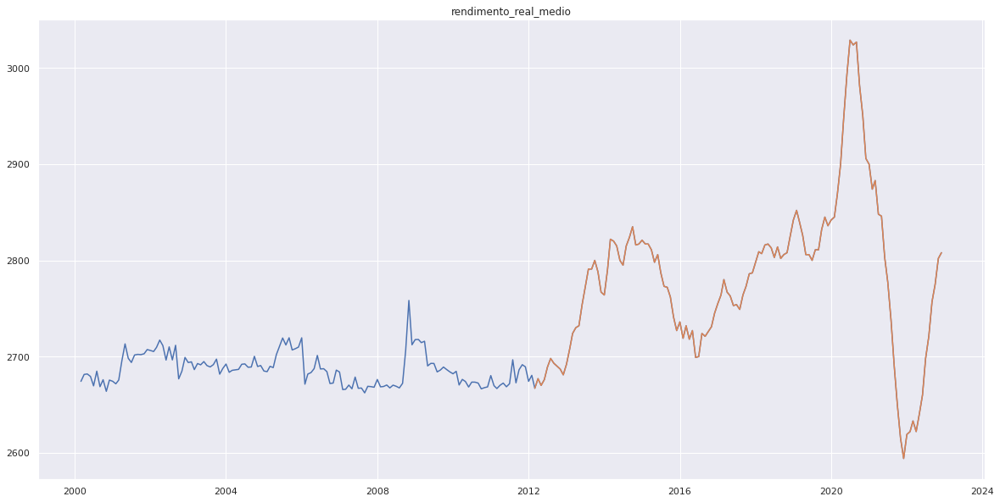

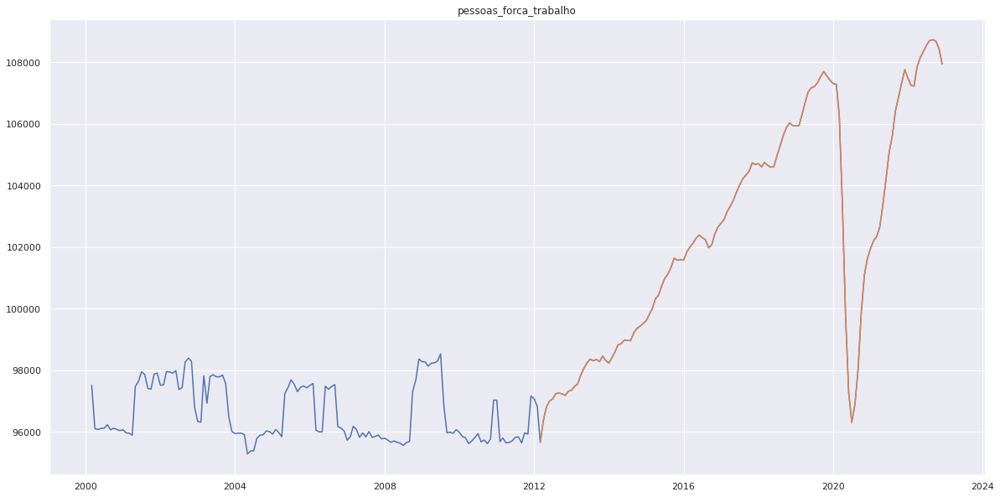

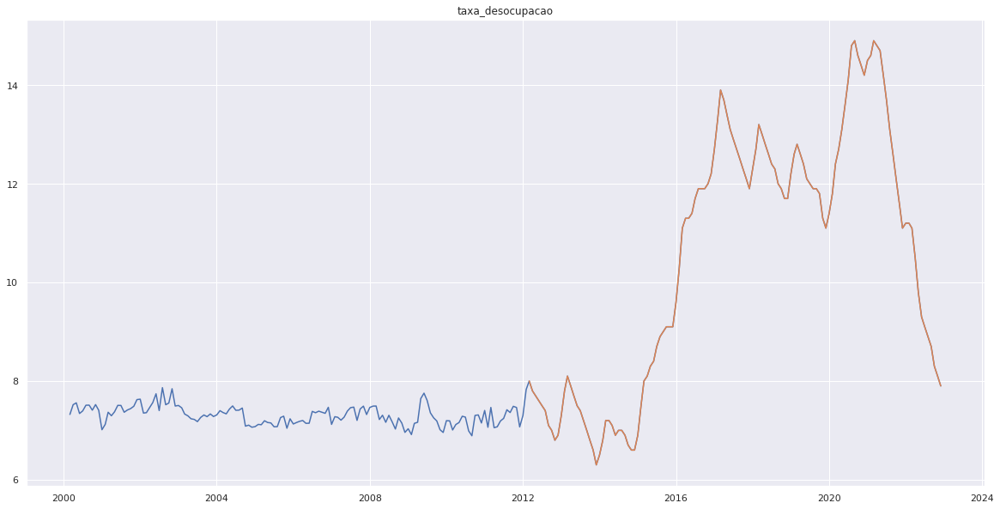

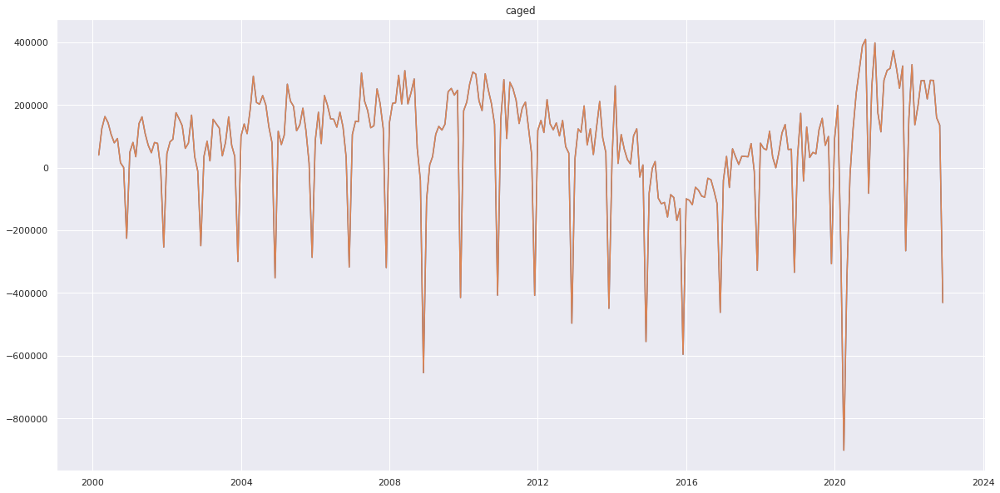

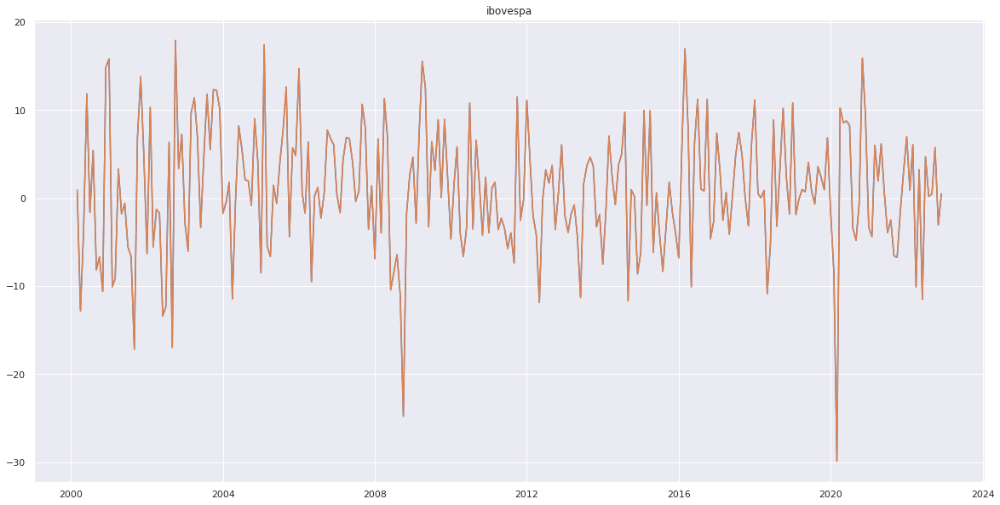

...

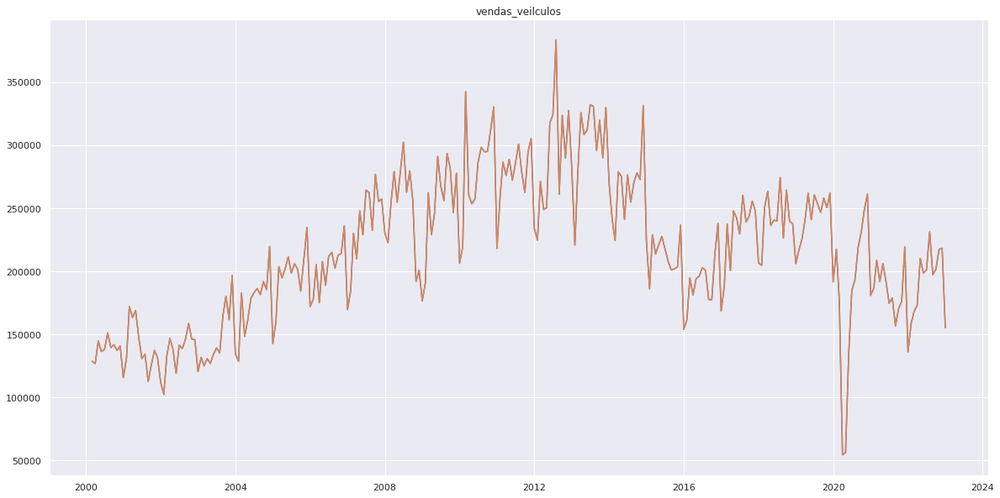

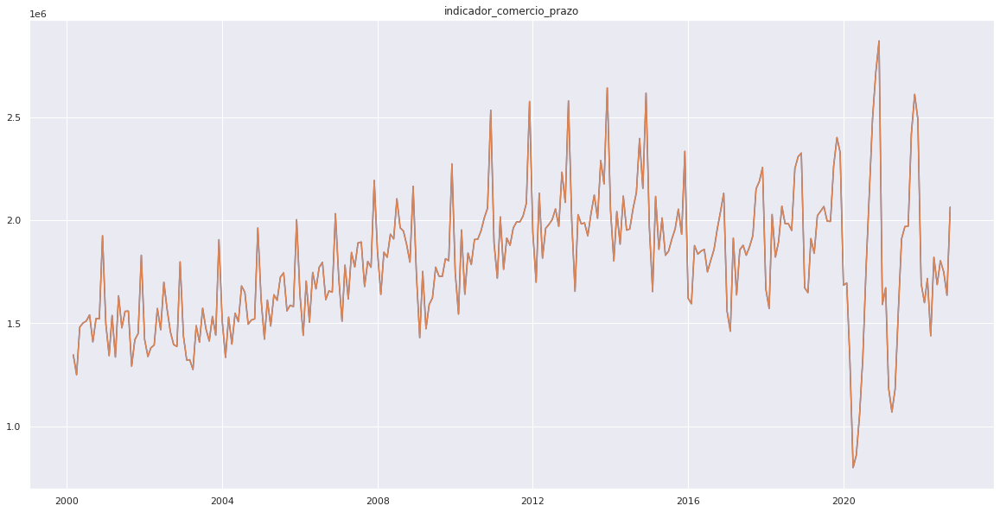

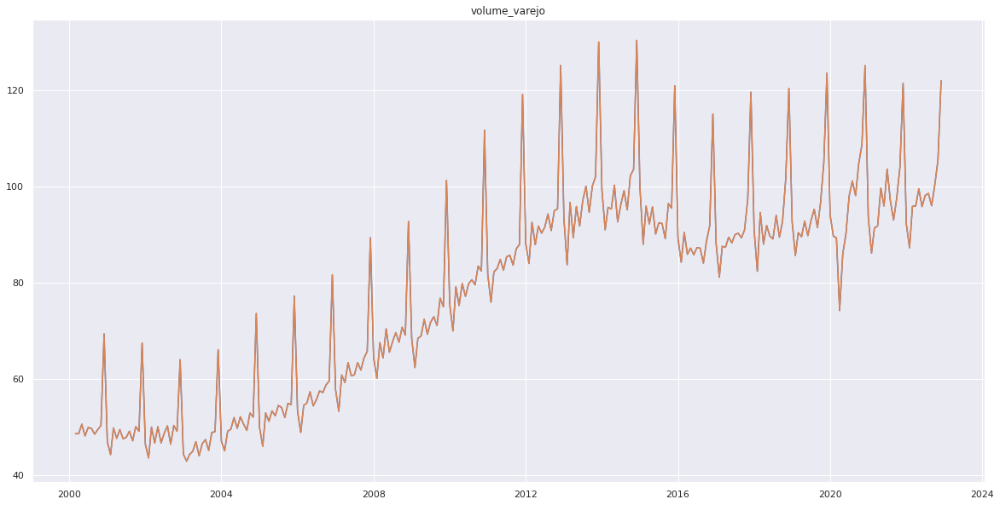

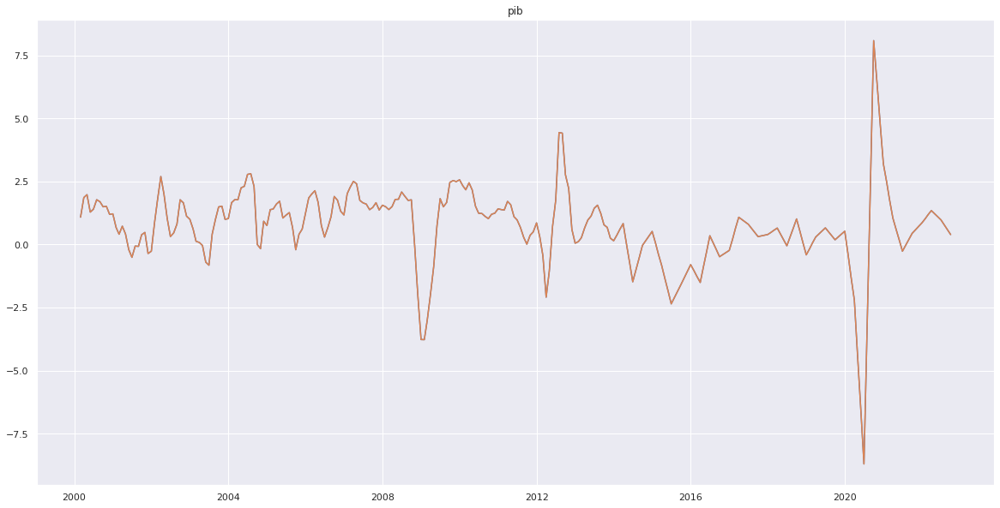

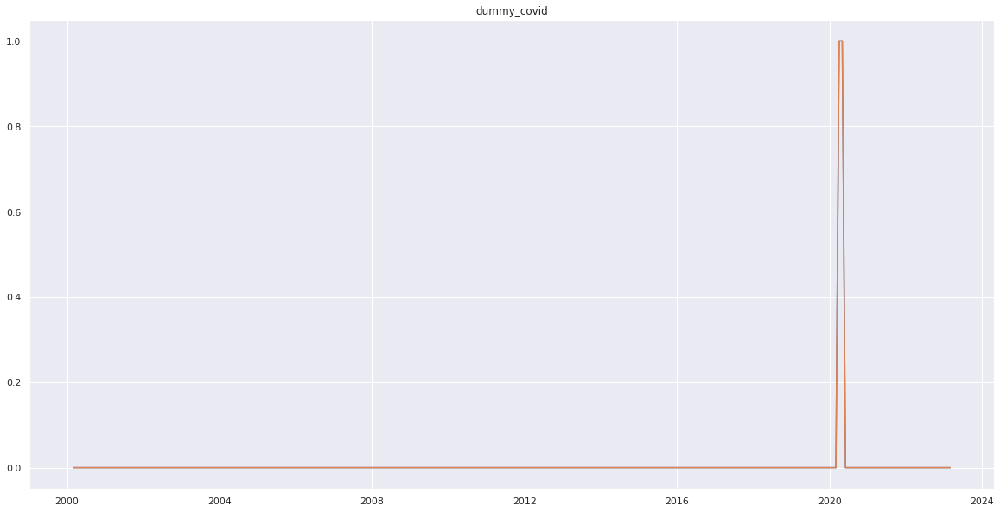

In [68]:
for i in dados_juntos.columns:
  plt.plot(dados_bac[i])
  plt.plot(dados_juntos[i])
  plt.title(i)
  plt.show()

##Estacionaridade
A TS é dita estacionária se as suas propriedades estatísticas, tais como a média e variância permanecem constantes ao longo do tempo. Mas por que isso é importante? A maioria dos modelos TS trabalha com o pressuposto de que a TS é estacionária. Intuitivamente, podemos entender que se uma TS tem um comportamento particular ao longo de um tempo, há uma probabilidade muito elevada de que seguirá o mesmo comportamento no futuro. Além disso, as teorias relacionadas com séries estacionárias são mais maduras e mais fáceis de implementar, em comparação com séries não-estacionárias.

https://www.vooo.pro/insights/guia-completo-para-criar-time-series-com-codigo-em-python/

In [69]:
def plotar(dados):
  for i in range(len(dados.columns)):
    fig, ax = plt.subplots(dpi=120)
    ax.plot(dados.iloc[:,i],label=dados.columns[i])
    plt.legend()
    plt.show()

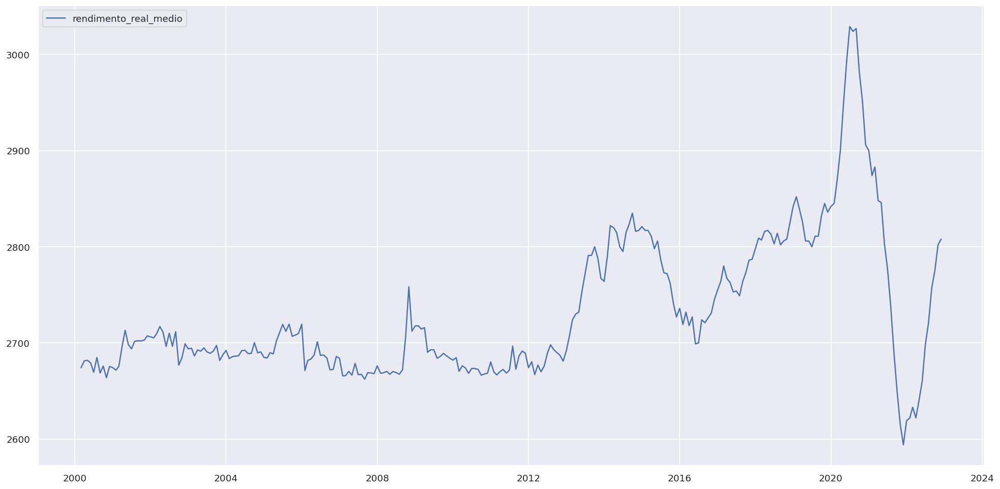

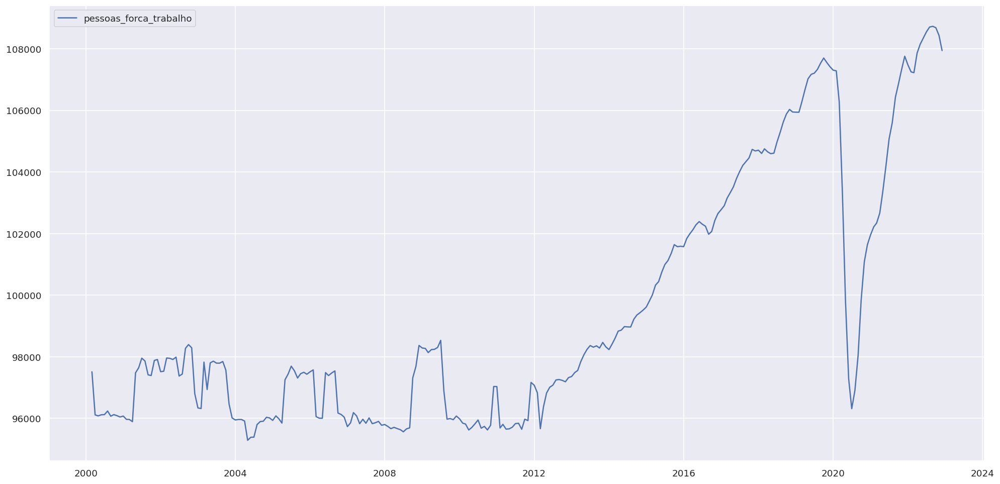

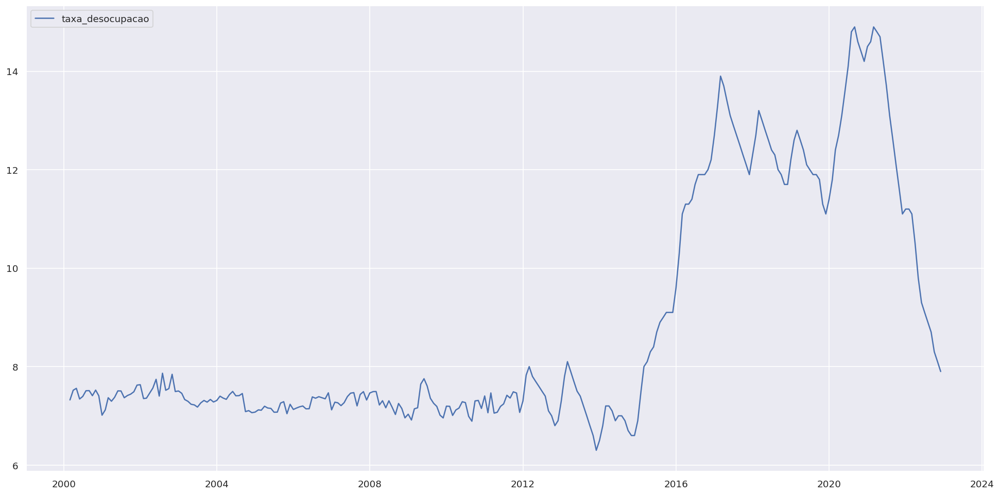

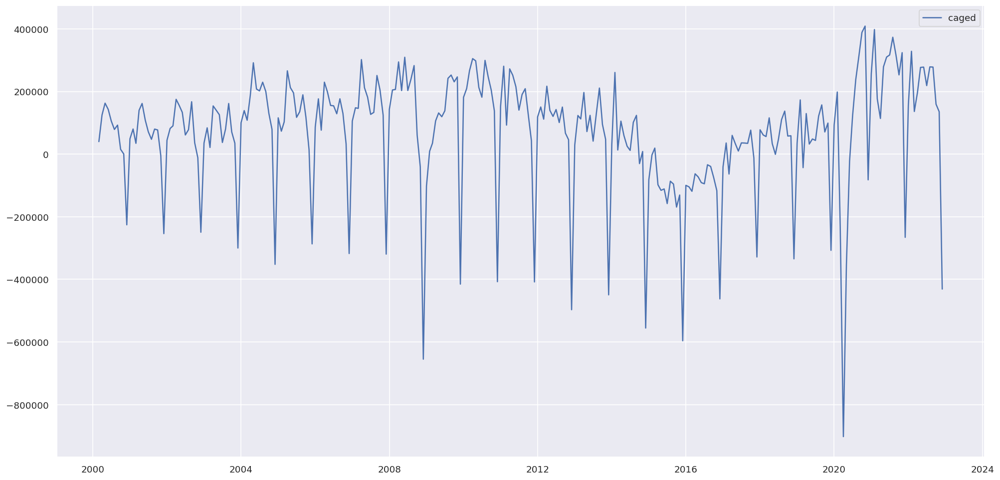

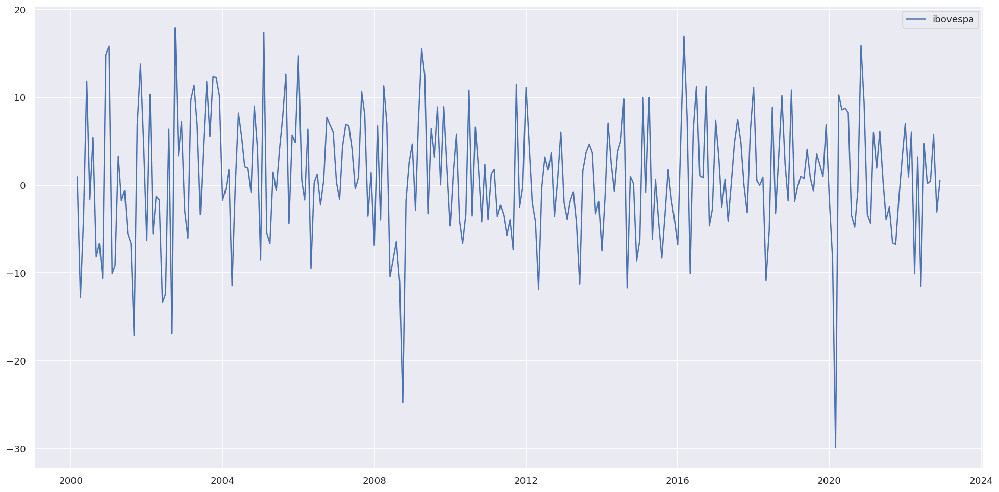

...

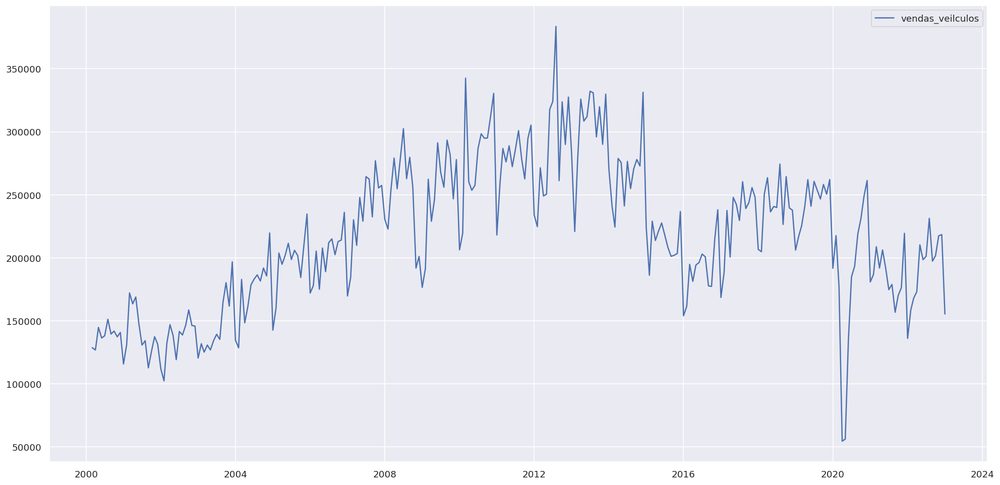

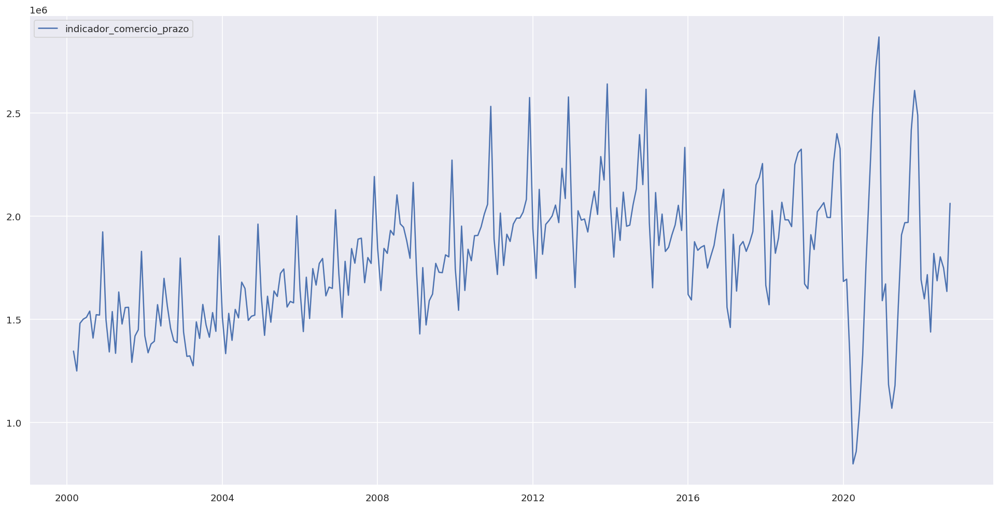

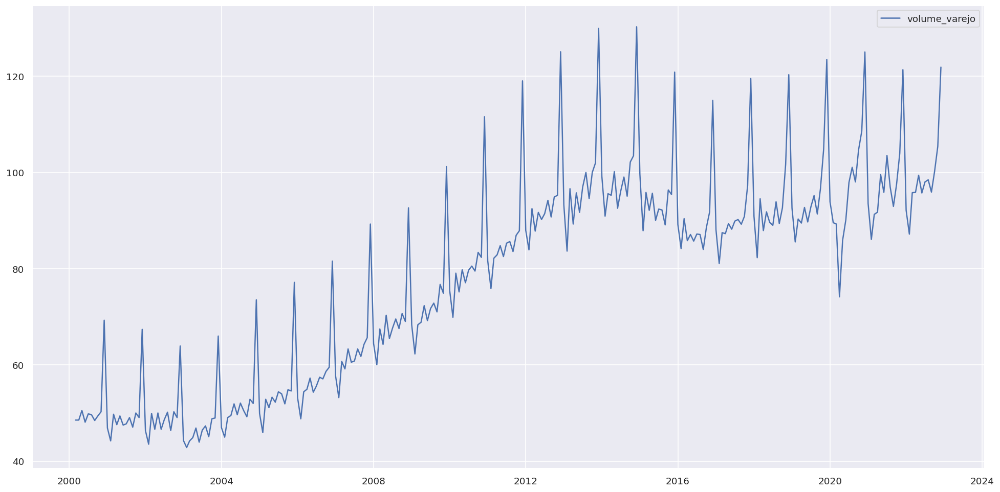

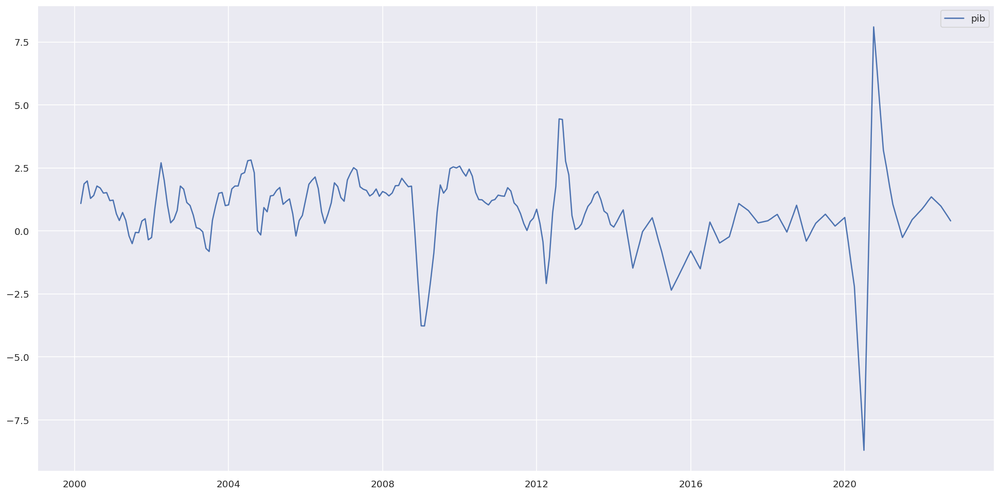

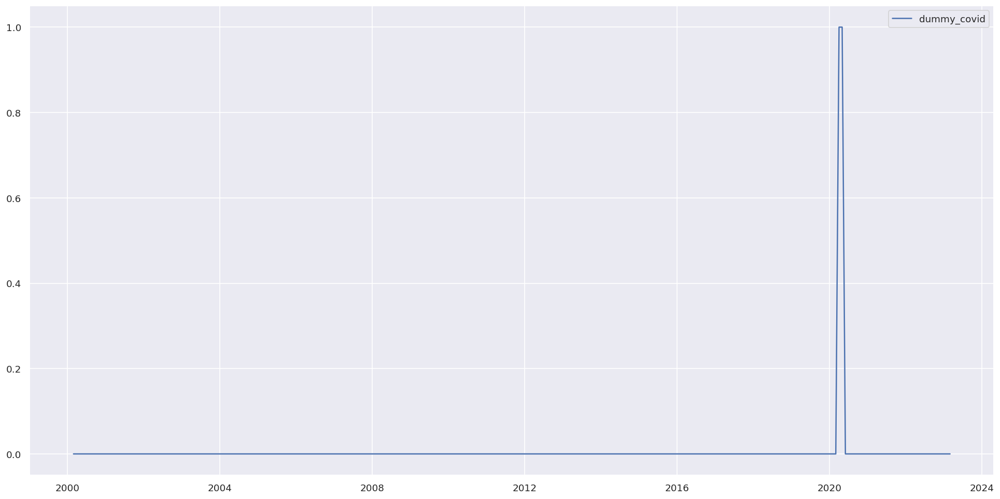

In [70]:
plotar(dados_bac)

###Teste de estacionaridade Dickey-Fuller
Dickey-Fuller teste: esse é um dos testes estatísticos para verificar Estacionaridade. Aqui, a hipótese nula é que o TS é não-estacionária. Os resultados do teste são compostos por uma estatística de teste e alguns valores críticos para os níveis de confiança da diferença. Se o ‘teste estatístico’ é menor do que o “valor crítico”, podemos rejeitar a hipótese nula e dizer que a série é estacionária. Consulte este artigo para obter detalhes.

In [71]:
def test_kpss_adf(dados):
  #https://www.statsmodels.org/dev/examples/notebooks/generated/stationarity_detrending_adf_kpss.html
  def kpss_test(timeseries):
    """
    O KPSS é outro teste para verificar a estacionaridade de uma série temporal. As hipóteses nula e alternativa para o teste KPSS são opostas às do teste ADF.

    Hipótese Nula: O processo é estacionário de tendência.

    Hipótese Alternativa: A série tem raiz unitária (a série não é estacionária).

    Uma função é criada para realizar o teste KPSS em uma série temporal.
    """
    #print("Results of KPSS Test:")
    kpsstest = kpss(timeseries, regression="c", nlags="auto")
    kpss_output = pd.Series(
      kpsstest[0:3], index=["Test Statistic", "p-value", "Lags Used"]
    )
    for key, value in kpsstest[3].items():
        kpss_output["Critical Value (%s)" % key] = value
    return kpss_output

  def adf_test(timeseries):

    """
    O teste ADF é usado para determinar a presença de raiz unitária na série e, portanto, ajuda a entender se a série é estacionária ou não. As hipóteses nula e 
    alternativa deste teste são:
    Hipótese Nula: A série tem raiz unitária.
    Hipótese alternativa: A série não tem raiz unitária.
    Se a hipótese nula não for rejeitada, este teste pode fornecer evidências de que a série é não estacionária.
   Uma função é criada para realizar o teste ADF em uma série temporal.
    """
    #print("Results of Dickey-Fuller Test:")
    dftest = adfuller(timeseries, autolag="AIC")
    dfoutput = pd.Series(
      dftest[0:4],
      index=[
            "Test Statistic",
            "p-value",
            "#Lags Used",
            "Number of Observations Used",
        ],
    )
    for key, value in dftest[4].items():
      dfoutput["Critical Value (%s)" % key] = value
    return dfoutput


  test_est = pd.DataFrame(index=dados.columns,columns = ['Teste_kpss', 'Estacionaria_ou_nâo_kpss','Teste_adf','Estacionaria_ou_nâo_adf'])
  for k in dados.columns:
    tes_kpss = kpss_test(dados[k].dropna())
    test_est.loc[k,test_est.columns[0]] = tes_kpss[1]
    tes_adf = adf_test(dados[k].dropna())
    test_est.loc[k,test_est.columns[2]] = tes_adf[1]
  test_est['Estacionaria_ou_nâo_kpss']=np.where(test_est['Teste_kpss'] >= 0.05,'Estacionaria','Nâo estacionaria')
  test_est['Estacionaria_ou_nâo_adf']=np.where(test_est['Teste_adf'] <= 0.05,'Estacionaria','Nâo estacionaria')
  return test_est
  

In [72]:
from statsmodels.tsa.stattools import adfuller
def test_stationarity(timeseries):
    from statsmodels.tsa.stattools import adfuller
    import pandas as pd
    import matplotlib.pylab as plt
    import seaborn as sns
    import numpy as np
    for i in range(len(timeseries.columns)):
     #Determing rolling statistics
      rolmean = pd.Series(timeseries.iloc[:,i]).rolling(window=12).mean().dropna()
      rolstd = pd.Series(timeseries.iloc[:,i]).rolling(window=12).std().dropna()

      #Plot rolling statistics:
      if type(timeseries[timeseries.columns[i]][0]) != str:
        orig = plt.plot(timeseries.iloc[:,i], color='blue',label='Original')
        mean = plt.plot(rolmean, color='red', label='Rolling Mean')
        std = plt.plot(rolstd, color='black', label = 'Rolling Std')
        plt.legend(loc='best')
        plt.title(f'Rolling Mean & Standard Deviation na variavel {timeseries.columns[i]}')
        plt.show(block=False)
    
        #Perform Dickey-Fuller test:
        print (f'Results of Dickey-Fuller Test:Coluna {timeseries.columns[i]}')
        dftest = adfuller(timeseries.iloc[:,i].dropna(), autolag='AIC')
        dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
        for key,value in dftest[4].items():
          dfoutput['Critical Value (%s)'%key] = value
        print(dfoutput)
      else:
        try:
          timeseries.iloc[:,i] = timeseries.iloc[:,i].astype(int)
          orig = plt.plot(timeseries.iloc[:,i], color='blue',label='Original')
          mean = plt.plot(rolmean, color='red', label='Rolling Mean')
          std = plt.plot(rolstd, color='black', label = 'Rolling Std')
          plt.legend(loc='best')
          plt.title(f'Rolling Mean & Standard Deviation na variavel {timeseries.columns[i]}')
          plt.show(block=False)
    
          #Perform Dickey-Fuller test:
          print (f'Results of Dickey-Fuller Test:Coluna {timeseries.columns[i]}')
          dftest = adfuller(timeseries.iloc[:,i].dropna(), autolag='AIC')
          dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
          for key,value in dftest[4].items():
           dfoutput['Critical Value (%s)'%key] = value
          print(dfoutput)
        except:
          timeseries.iloc[:,i] = timeseries.iloc[:,i].astype(float)
          orig = plt.plot(timeseries.iloc[:,i], color='blue',label='Original')
          mean = plt.plot(rolmean, color='red', label='Rolling Mean')
          std = plt.plot(rolstd, color='black', label = 'Rolling Std')
          plt.legend(loc='best')
          plt.title(f'Rolling Mean & Standard Deviation na variavel {timeseries.columns[i]}')
          plt.show(block=False)
    
          #Perform Dickey-Fuller test:
          print (f'Results of Dickey-Fuller Test:Coluna {timeseries.columns[i]}')
          dftest = adfuller(timeseries.iloc[:,i].dropna(), autolag='AIC')
          dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
          for key,value in dftest[4].items():
           dfoutput['Critical Value (%s)'%key] = value
          print(dfoutput)
        
    return test_kpss_adf(timeseries)
          

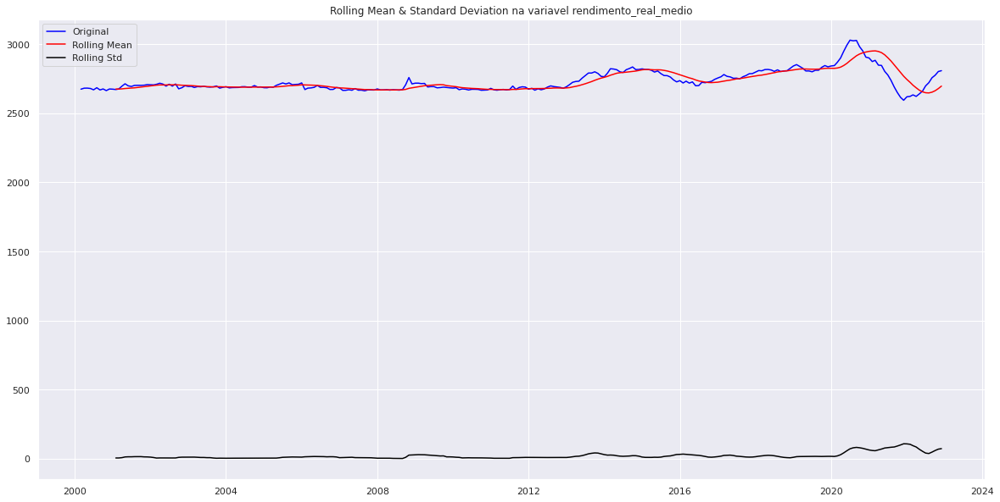

Results of Dickey-Fuller Test:Coluna rendimento_real_medio
Test Statistic                 -2.98
p-value                         0.04
#Lags Used                      2.00
Number of Observations Used   271.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


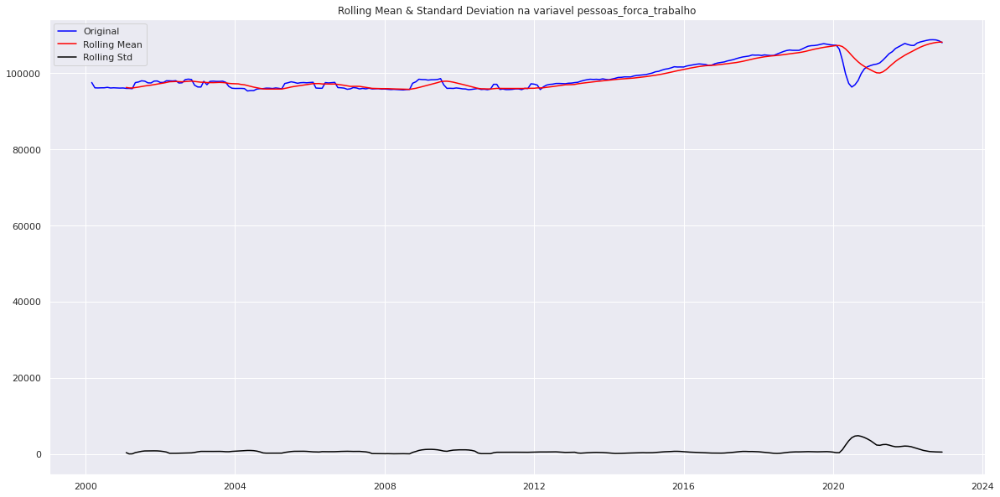

Results of Dickey-Fuller Test:Coluna pessoas_forca_trabalho
Test Statistic                 -0.99
p-value                         0.76
#Lags Used                      3.00
Number of Observations Used   270.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


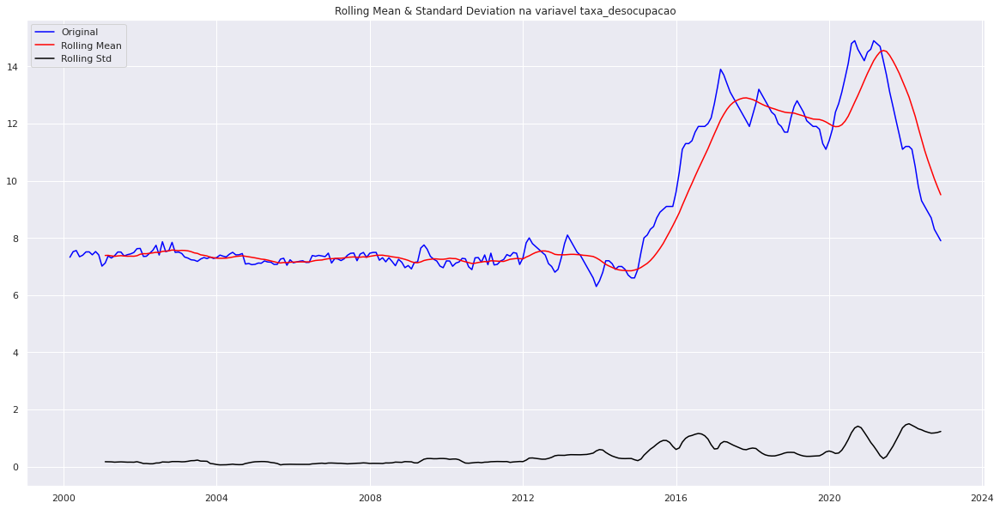

Results of Dickey-Fuller Test:Coluna taxa_desocupacao
Test Statistic                 -1.64
p-value                         0.46
#Lags Used                     15.00
Number of Observations Used   258.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


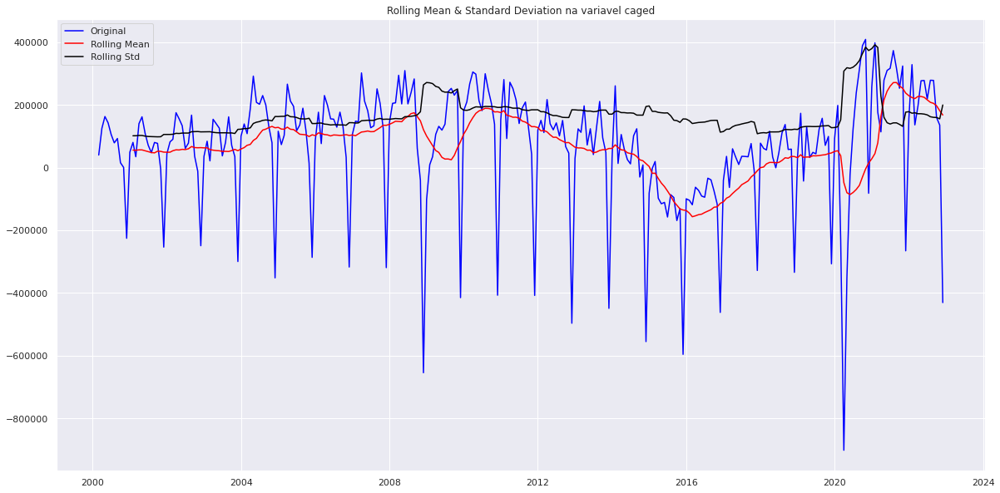

Results of Dickey-Fuller Test:Coluna caged
Test Statistic                 -2.65
p-value                         0.08
#Lags Used                     12.00
Number of Observations Used   261.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


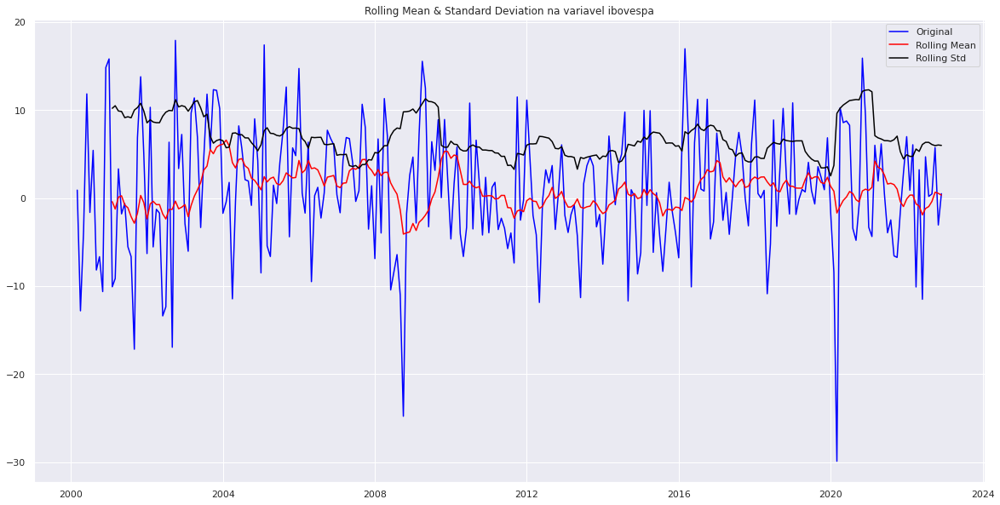

Results of Dickey-Fuller Test:Coluna ibovespa
Test Statistic                -14.84
p-value                         0.00
#Lags Used                      0.00
Number of Observations Used   273.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


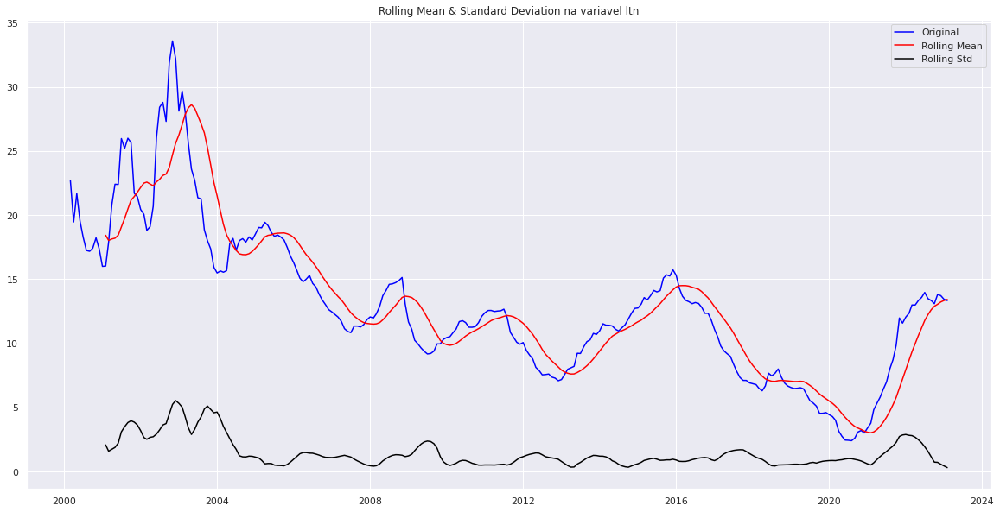

Results of Dickey-Fuller Test:Coluna ltn
Test Statistic                 -1.63
p-value                         0.47
#Lags Used                     10.00
Number of Observations Used   265.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


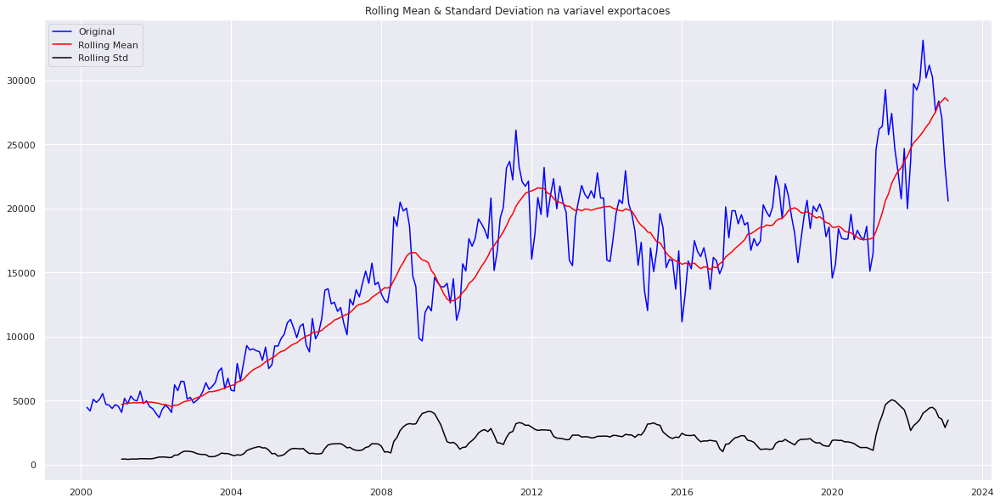

Results of Dickey-Fuller Test:Coluna exportacoes
Test Statistic                 -1.29
p-value                         0.64
#Lags Used                     16.00
Number of Observations Used   259.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


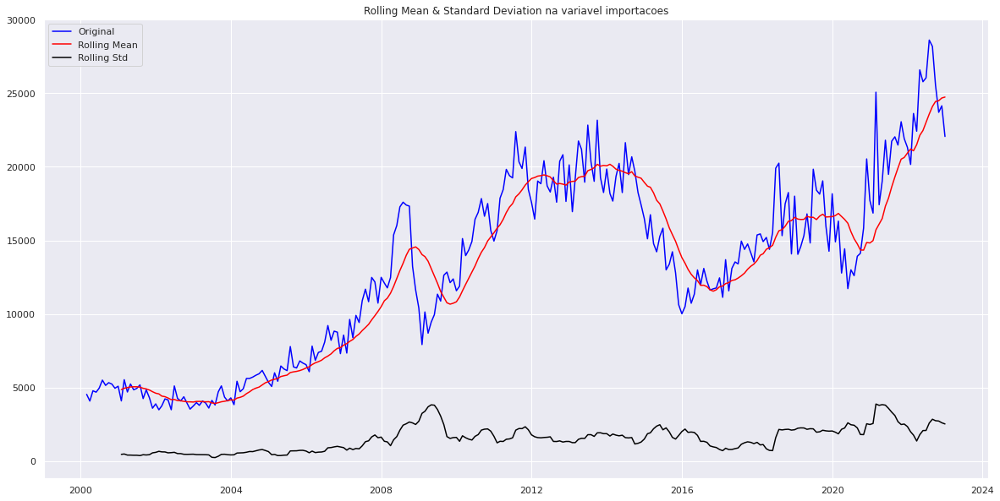

Results of Dickey-Fuller Test:Coluna importacoes
Test Statistic                 -0.95
p-value                         0.77
#Lags Used                     16.00
Number of Observations Used   258.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


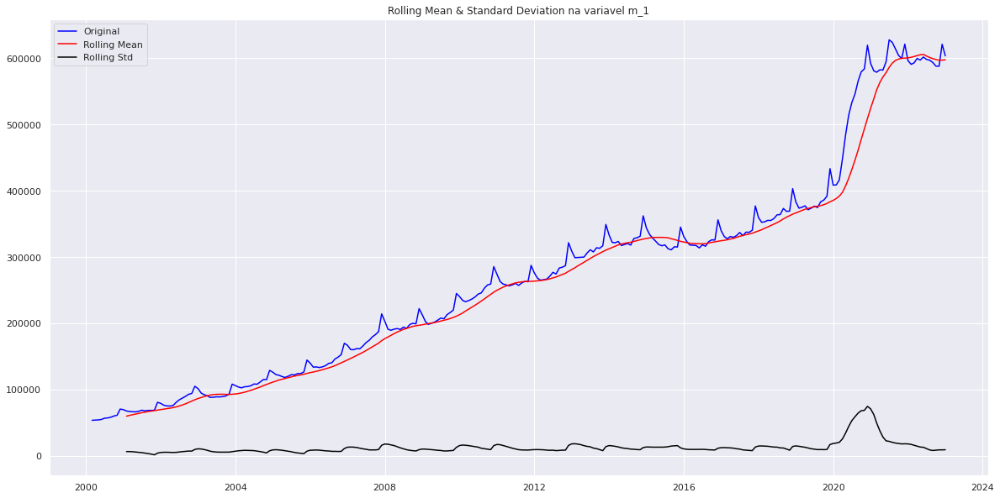

Results of Dickey-Fuller Test:Coluna m_1
Test Statistic                  1.18
p-value                         1.00
#Lags Used                     16.00
Number of Observations Used   258.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


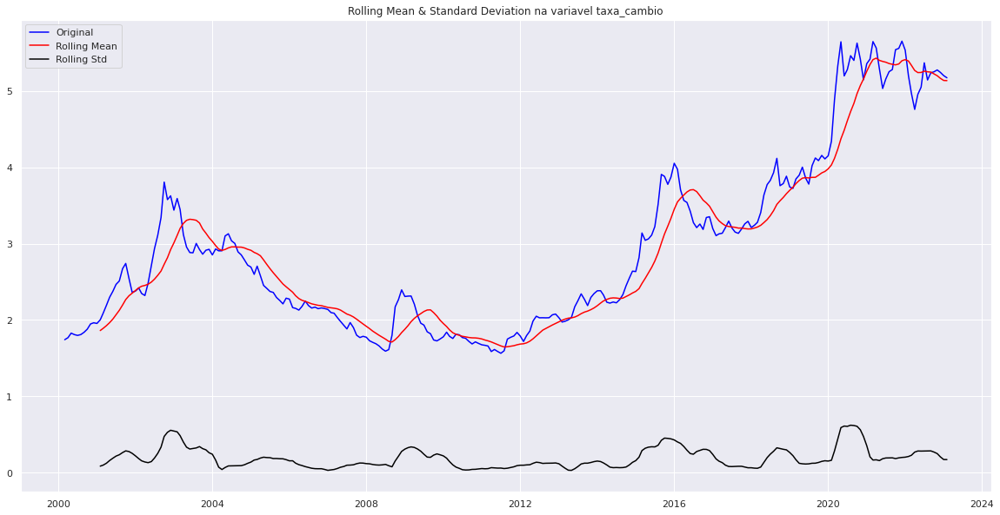

Results of Dickey-Fuller Test:Coluna taxa_cambio
Test Statistic                 -0.65
p-value                         0.86
#Lags Used                      1.00
Number of Observations Used   274.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


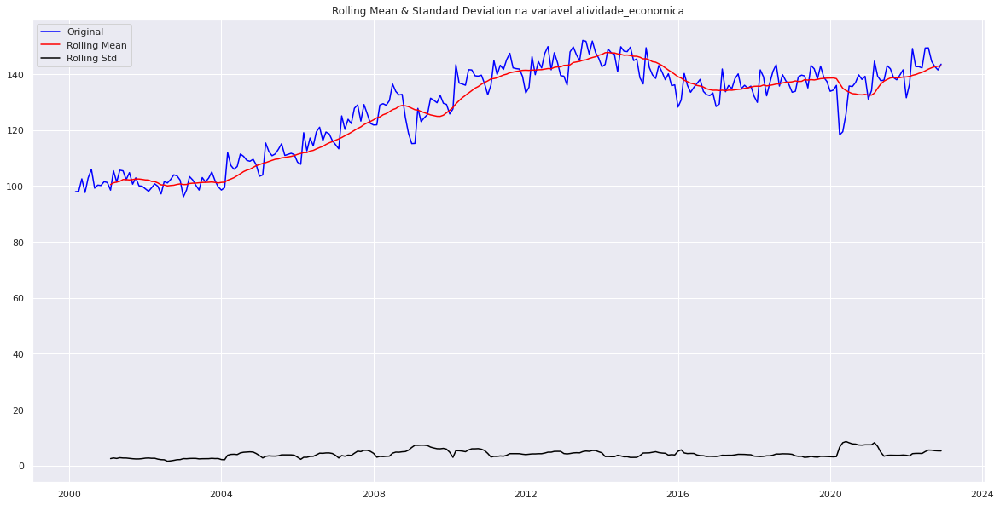

Results of Dickey-Fuller Test:Coluna atividade_economica
Test Statistic                 -1.28
p-value                         0.64
#Lags Used                     15.00
Number of Observations Used   258.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


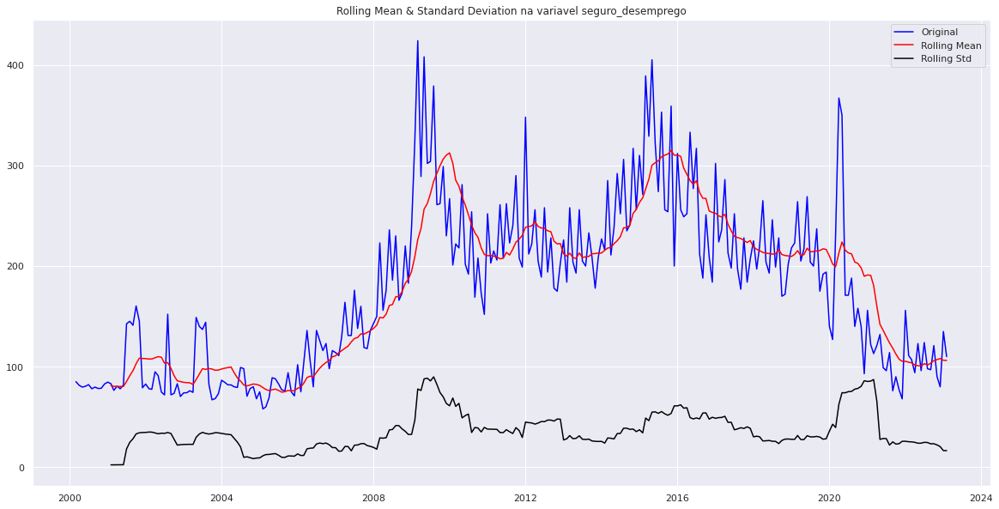

Results of Dickey-Fuller Test:Coluna seguro_desemprego
Test Statistic                 -1.98
p-value                         0.30
#Lags Used                     14.00
Number of Observations Used   261.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


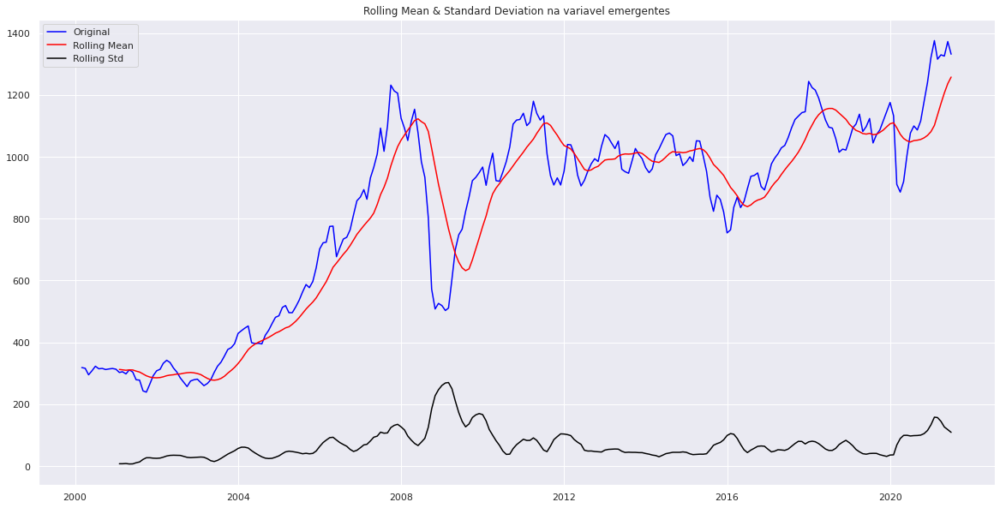

Results of Dickey-Fuller Test:Coluna emergentes
Test Statistic                 -1.64
p-value                         0.46
#Lags Used                      1.00
Number of Observations Used   255.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


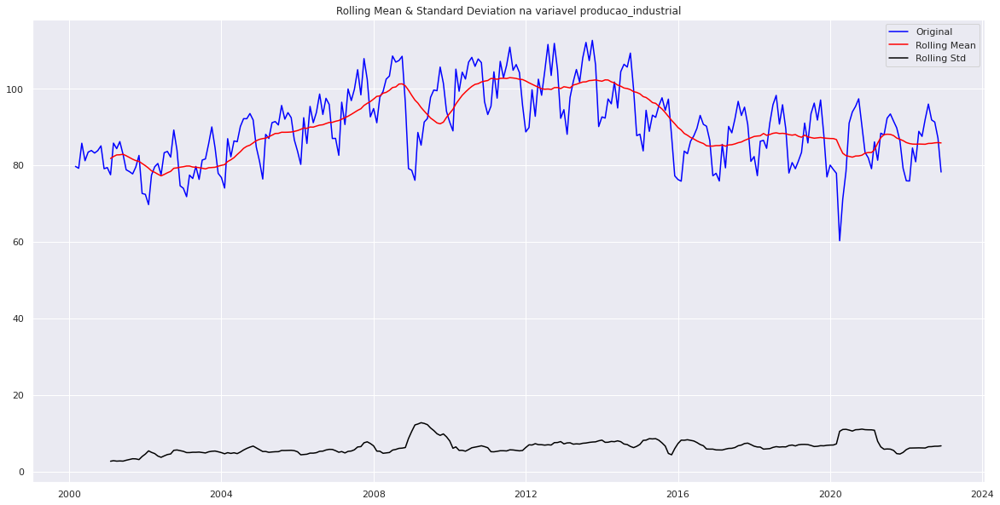

Results of Dickey-Fuller Test:Coluna producao_industrial
Test Statistic                 -1.68
p-value                         0.44
#Lags Used                     15.00
Number of Observations Used   258.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


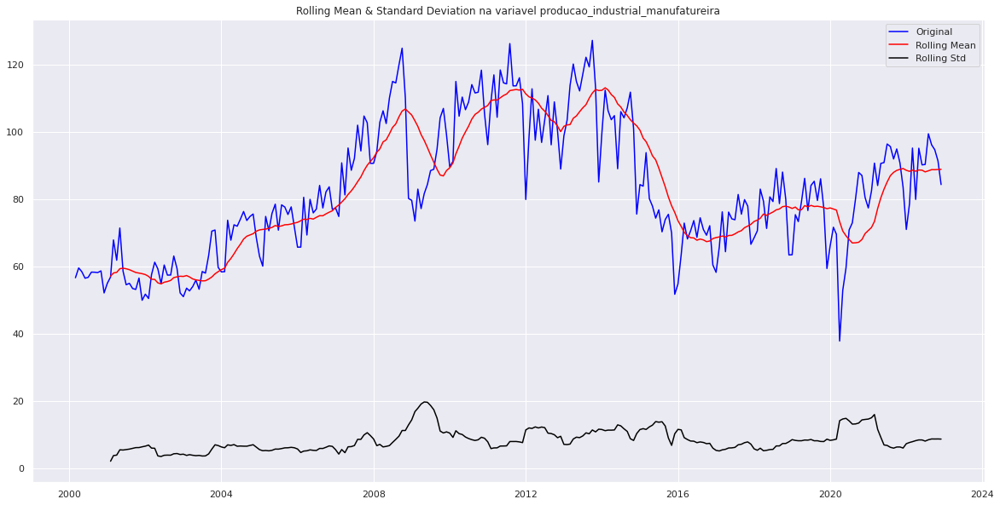

Results of Dickey-Fuller Test:Coluna producao_industrial_manufatureira
Test Statistic                 -1.86
p-value                         0.35
#Lags Used                     16.00
Number of Observations Used   257.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


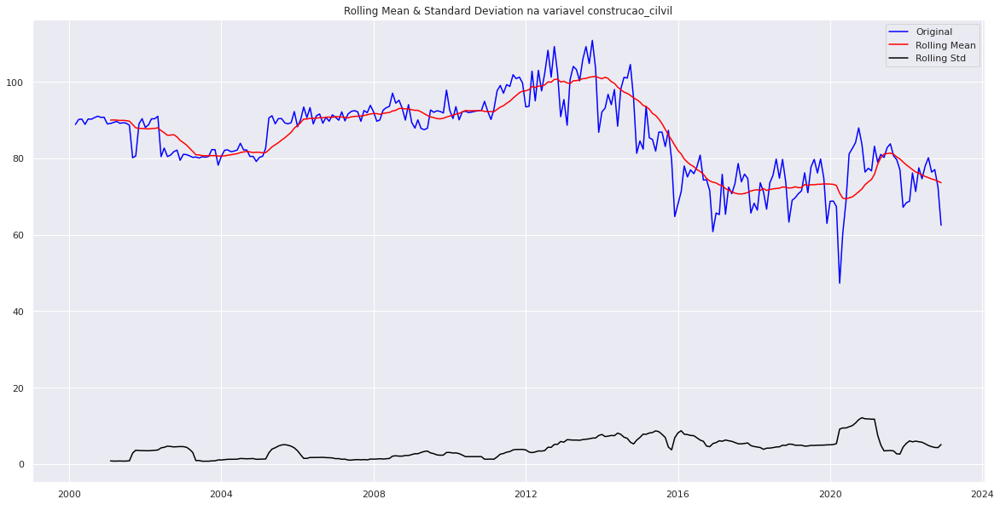

Results of Dickey-Fuller Test:Coluna construcao_cilvil
Test Statistic                 -1.22
p-value                         0.66
#Lags Used                     13.00
Number of Observations Used   260.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


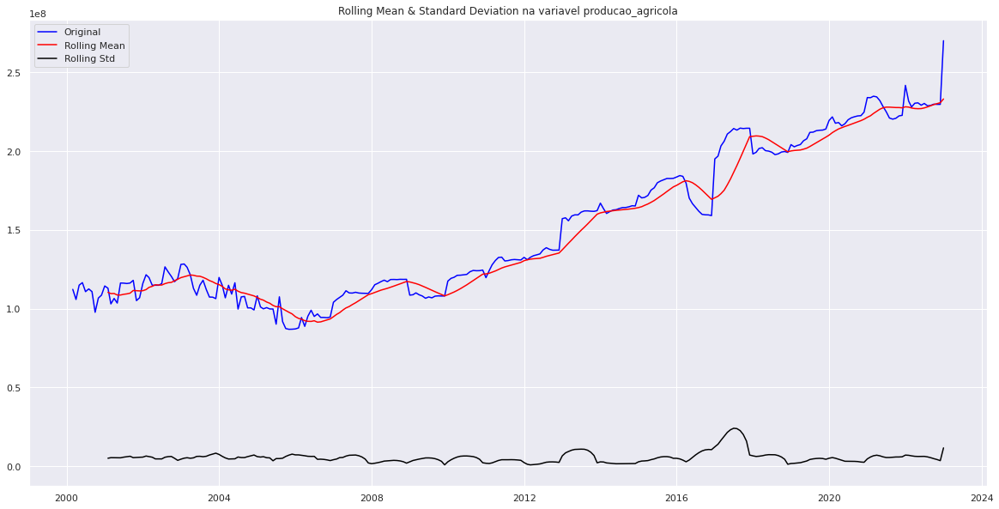

Results of Dickey-Fuller Test:Coluna producao_agricola
Test Statistic                  1.26
p-value                         1.00
#Lags Used                     12.00
Number of Observations Used   262.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


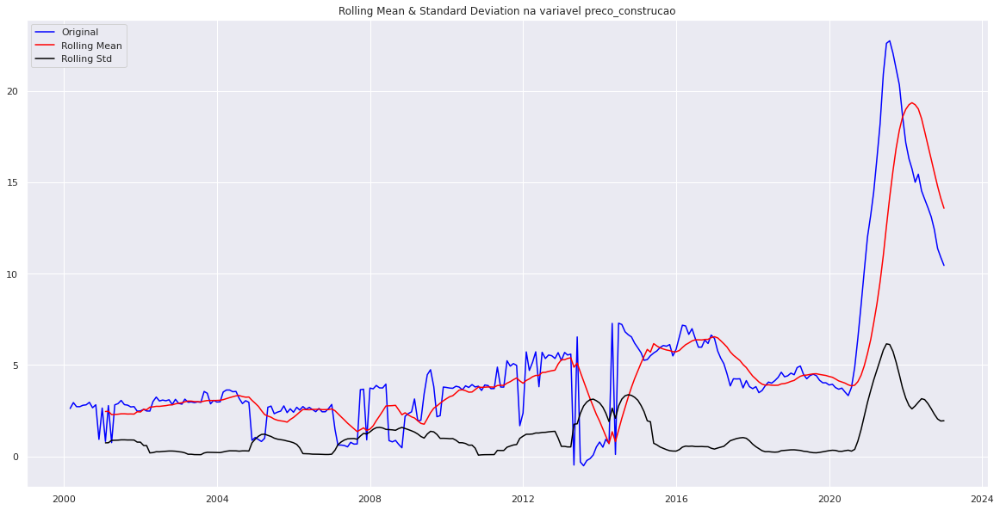

Results of Dickey-Fuller Test:Coluna preco_construcao
Test Statistic                 -1.66
p-value                         0.45
#Lags Used                     12.00
Number of Observations Used   262.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


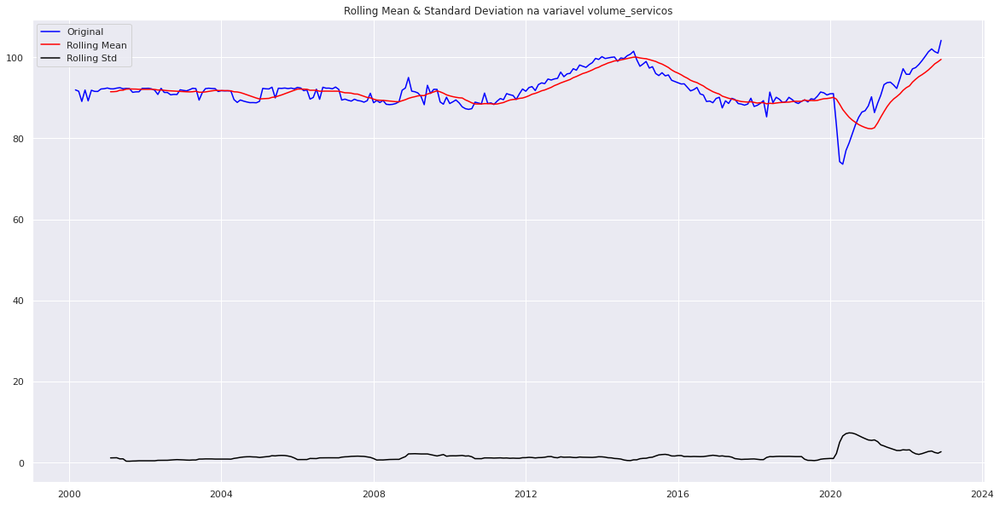

Results of Dickey-Fuller Test:Coluna volume_servicos
Test Statistic                 -2.24
p-value                         0.19
#Lags Used                      0.00
Number of Observations Used   273.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


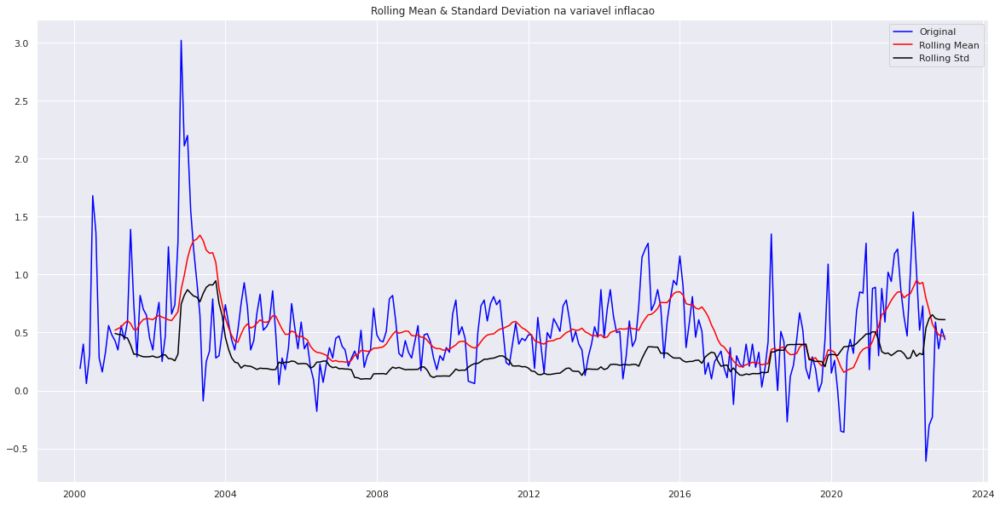

Results of Dickey-Fuller Test:Coluna inflacao
Test Statistic                 -8.11
p-value                         0.00
#Lags Used                      0.00
Number of Observations Used   274.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


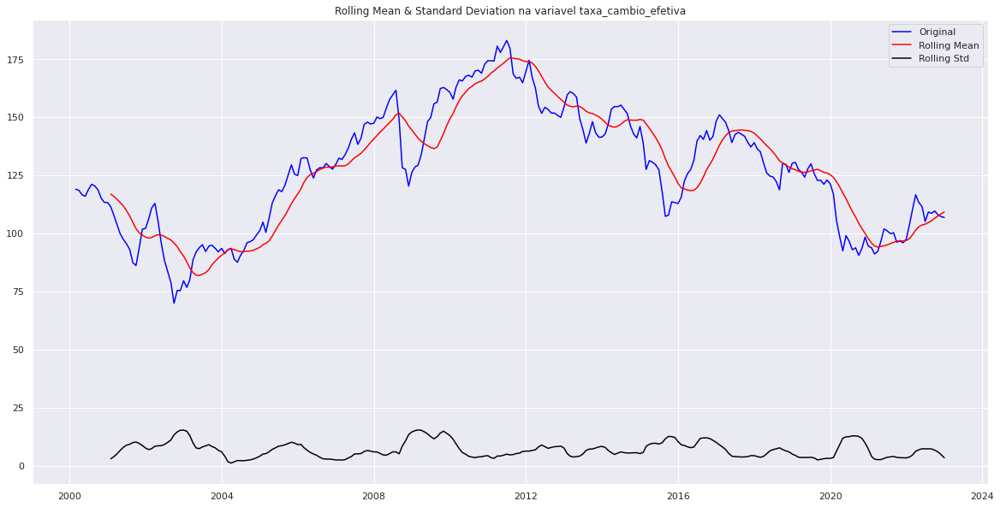

Results of Dickey-Fuller Test:Coluna taxa_cambio_efetiva
Test Statistic                 -1.80
p-value                         0.38
#Lags Used                      1.00
Number of Observations Used   273.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


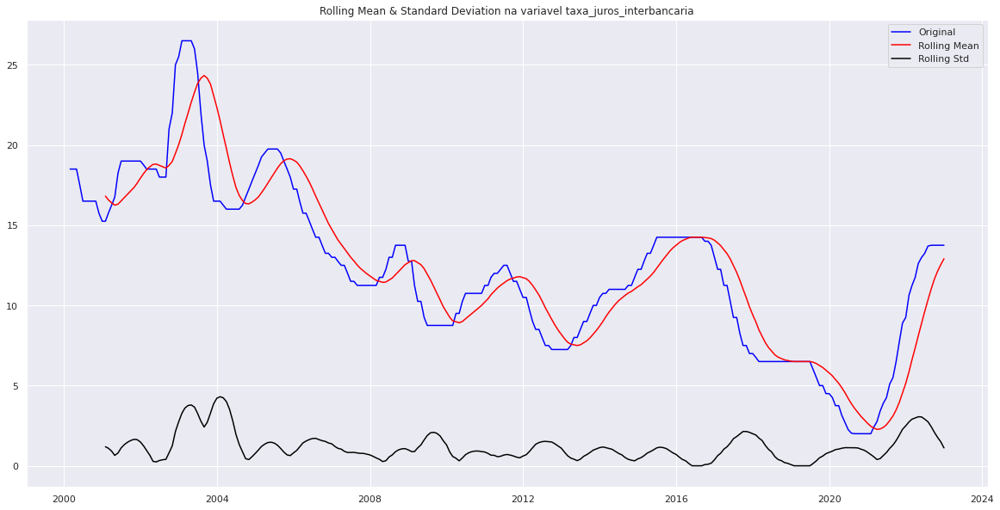

Results of Dickey-Fuller Test:Coluna taxa_juros_interbancaria
Test Statistic                 -2.17
p-value                         0.22
#Lags Used                      4.00
Number of Observations Used   270.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


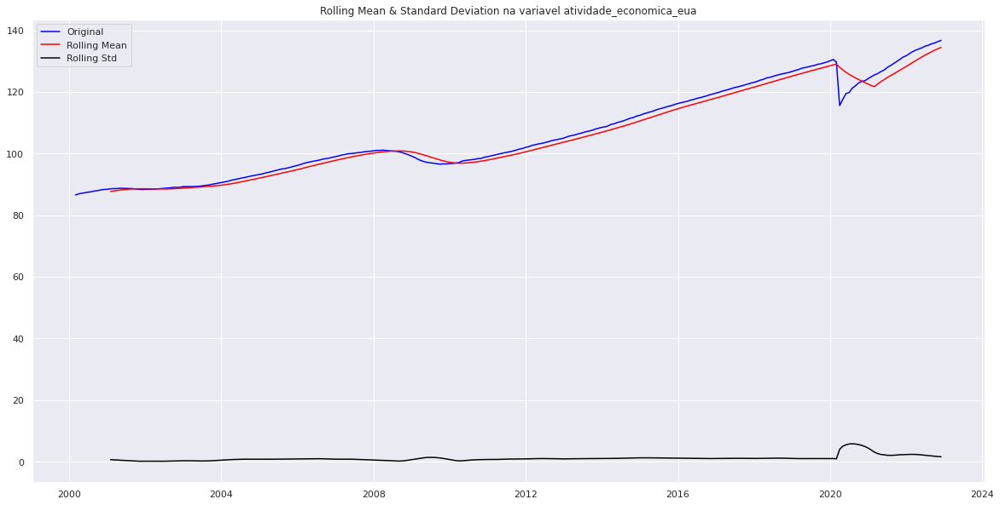

Results of Dickey-Fuller Test:Coluna atividade_economica_eua
Test Statistic                  0.69
p-value                         0.99
#Lags Used                      0.00
Number of Observations Used   273.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


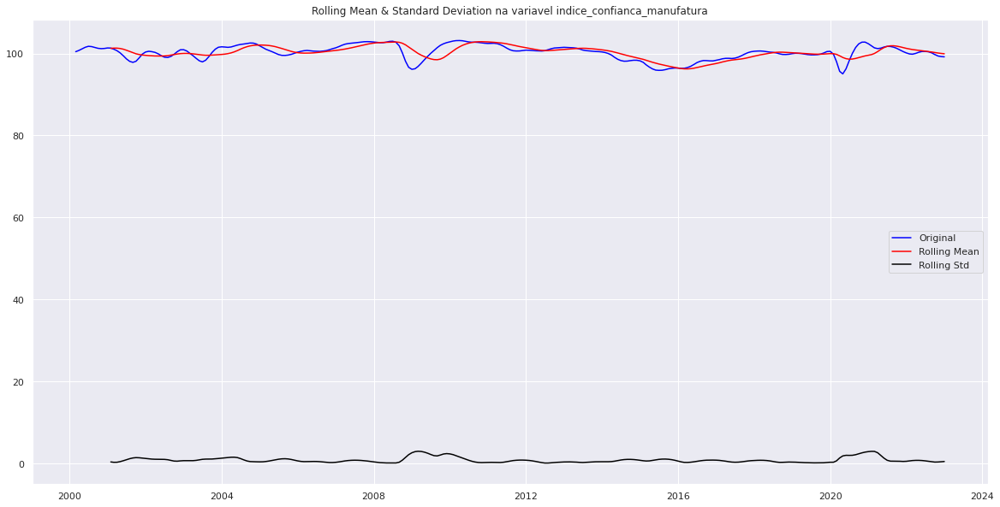

Results of Dickey-Fuller Test:Coluna indice_confianca_manufatura
Test Statistic                 -3.00
p-value                         0.03
#Lags Used                      4.00
Number of Observations Used   270.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


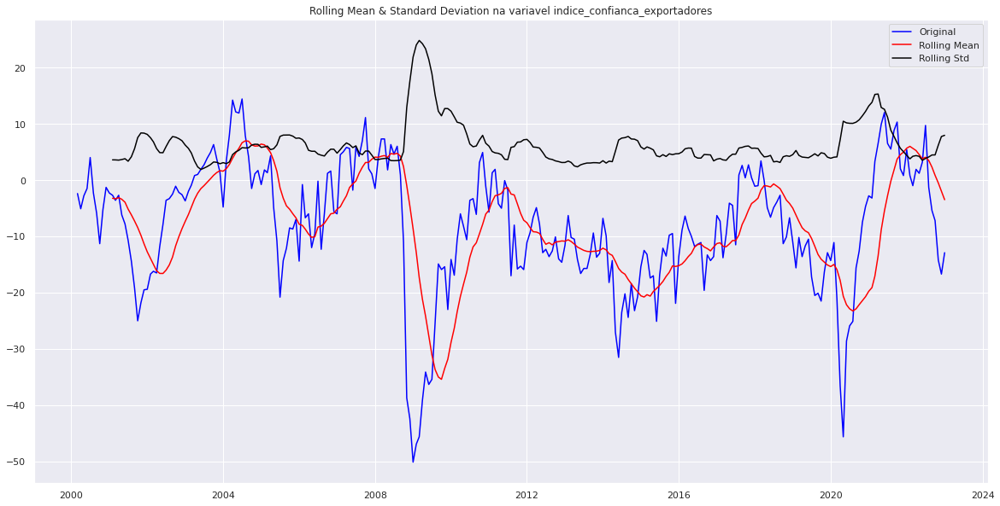

Results of Dickey-Fuller Test:Coluna indice_confianca_exportadores
Test Statistic                 -4.00
p-value                         0.00
#Lags Used                      0.00
Number of Observations Used   274.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


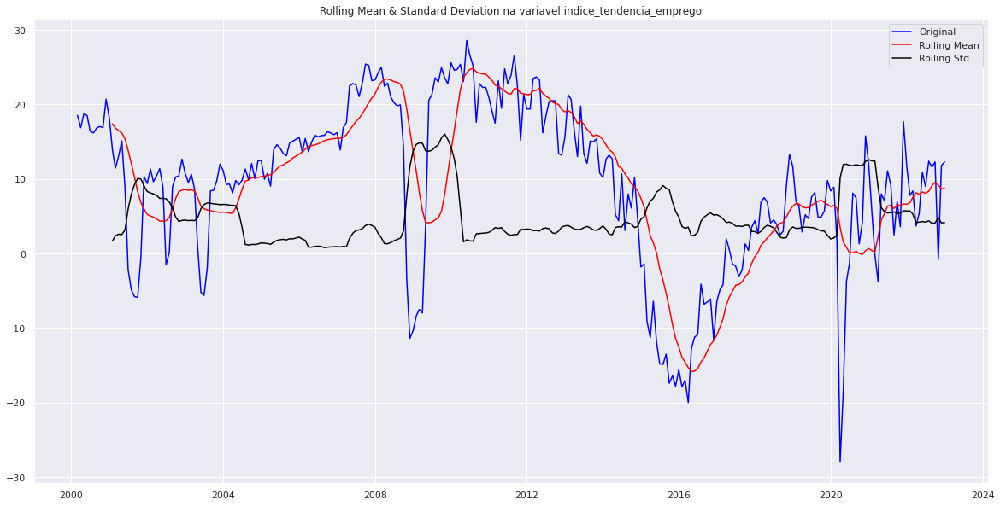

Results of Dickey-Fuller Test:Coluna indice_tendencia_emprego
Test Statistic                 -2.66
p-value                         0.08
#Lags Used                     12.00
Number of Observations Used   262.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


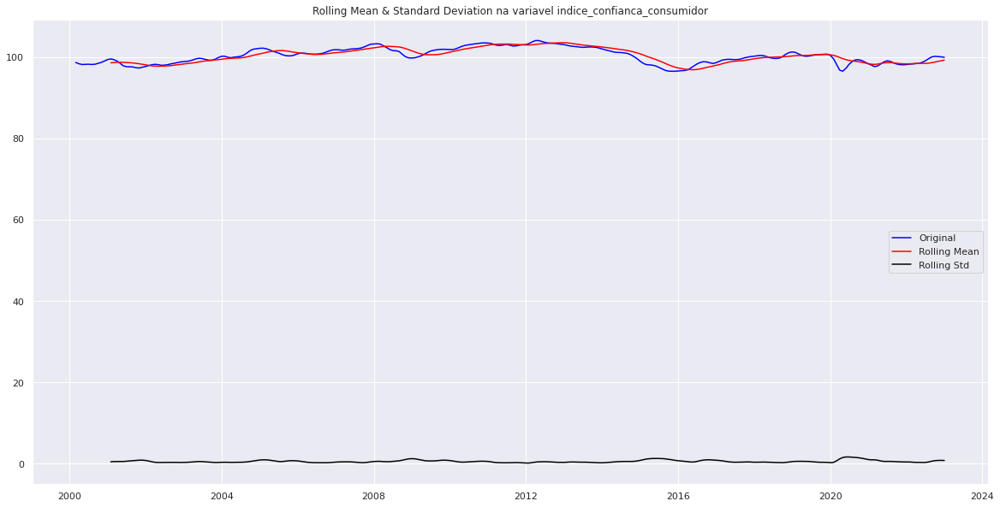

Results of Dickey-Fuller Test:Coluna indice_confianca_consumidor
Test Statistic                 -2.19
p-value                         0.21
#Lags Used                      3.00
Number of Observations Used   271.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


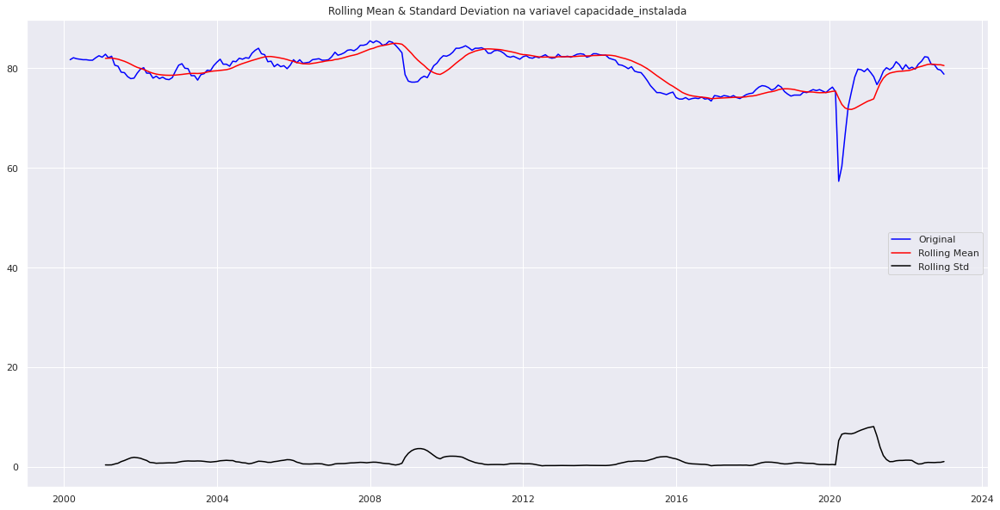

Results of Dickey-Fuller Test:Coluna capacidade_instalada
Test Statistic                 -2.88
p-value                         0.05
#Lags Used                      3.00
Number of Observations Used   271.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


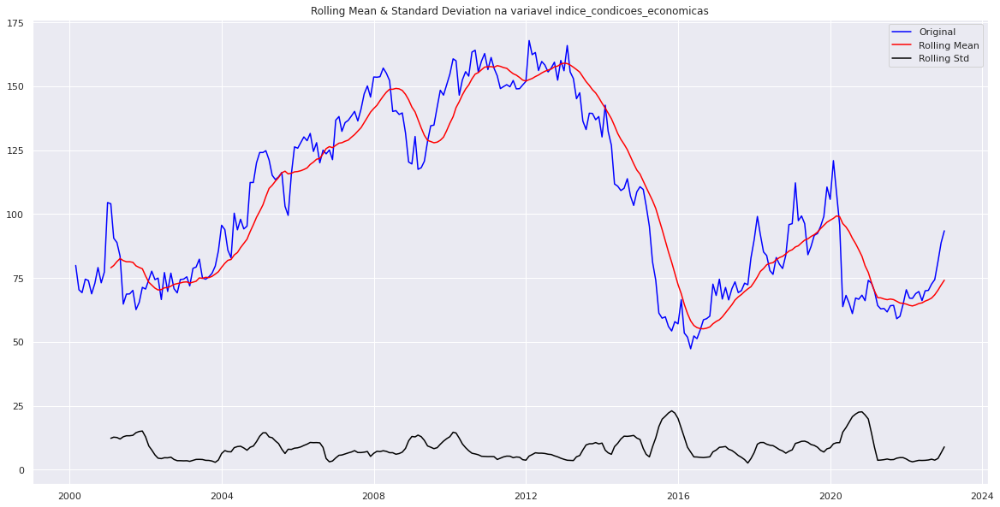

Results of Dickey-Fuller Test:Coluna indice_condicoes_economicas
Test Statistic                 -1.90
p-value                         0.33
#Lags Used                     16.00
Number of Observations Used   258.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


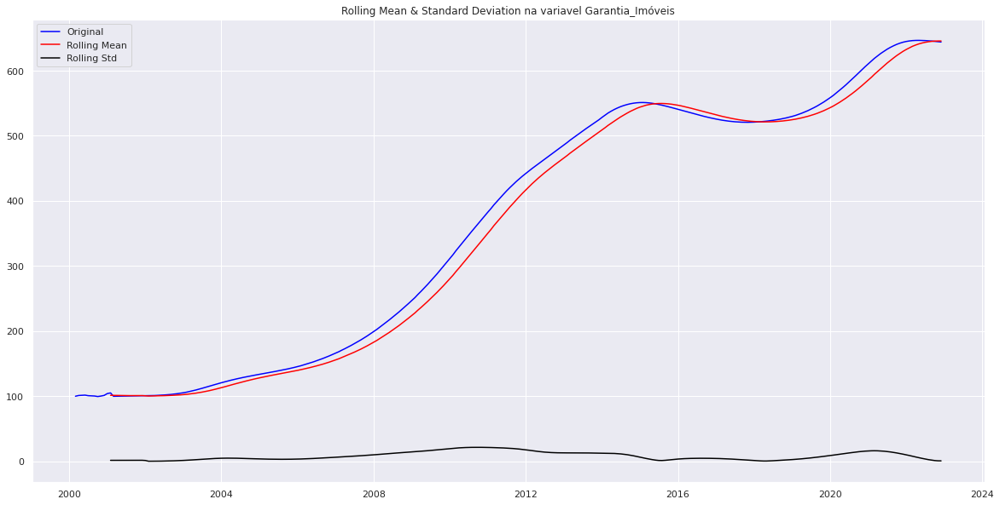

Results of Dickey-Fuller Test:Coluna Garantia_Imóveis
Test Statistic                 -2.45
p-value                         0.13
#Lags Used                      4.00
Number of Observations Used   269.00
Critical Value (1%)            -3.45
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


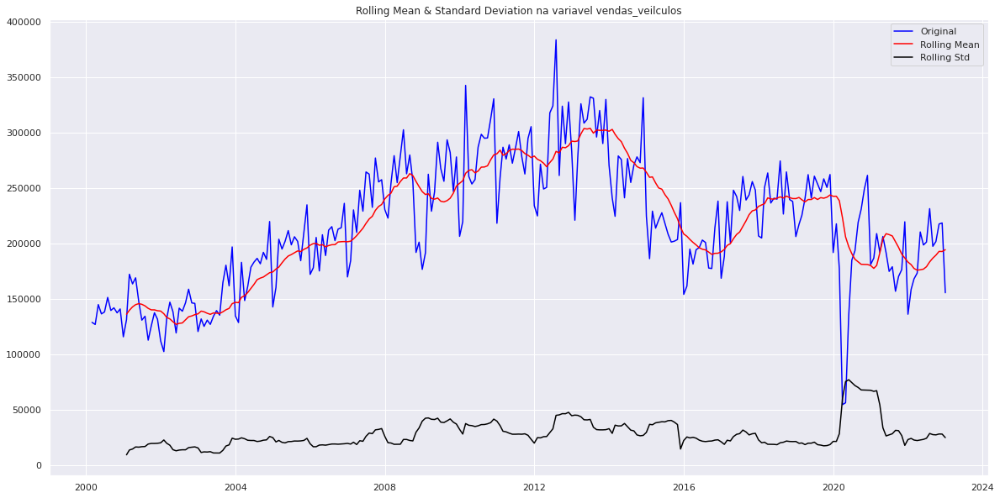

Results of Dickey-Fuller Test:Coluna vendas_veilculos
Test Statistic                 -1.68
p-value                         0.44
#Lags Used                     12.00
Number of Observations Used   262.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


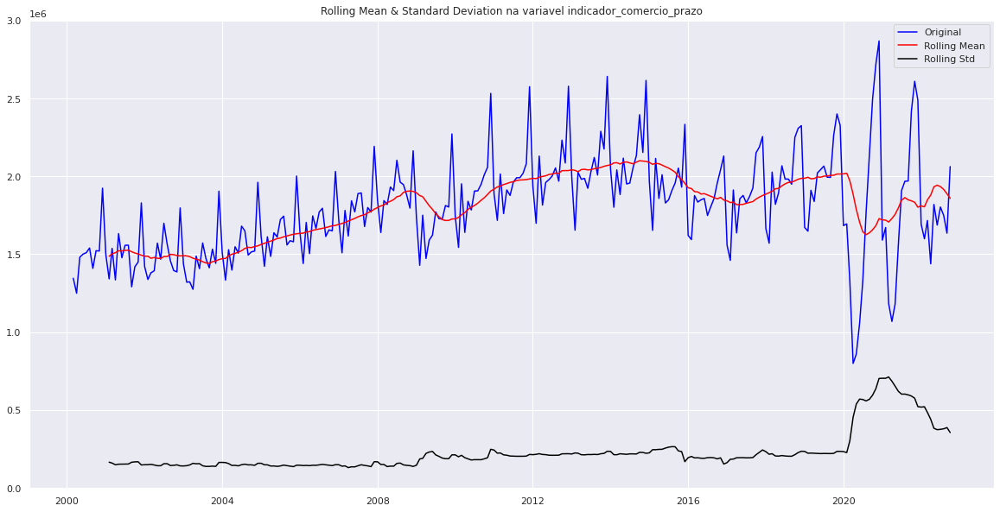

Results of Dickey-Fuller Test:Coluna indicador_comercio_prazo
Test Statistic                 -1.68
p-value                         0.44
#Lags Used                     14.00
Number of Observations Used   257.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


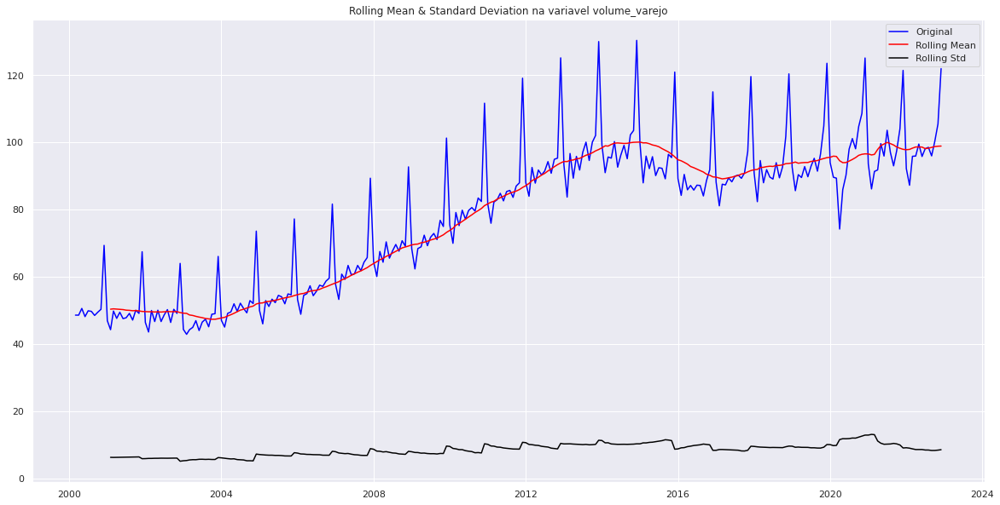

Results of Dickey-Fuller Test:Coluna volume_varejo
Test Statistic                 -1.21
p-value                         0.67
#Lags Used                     16.00
Number of Observations Used   257.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


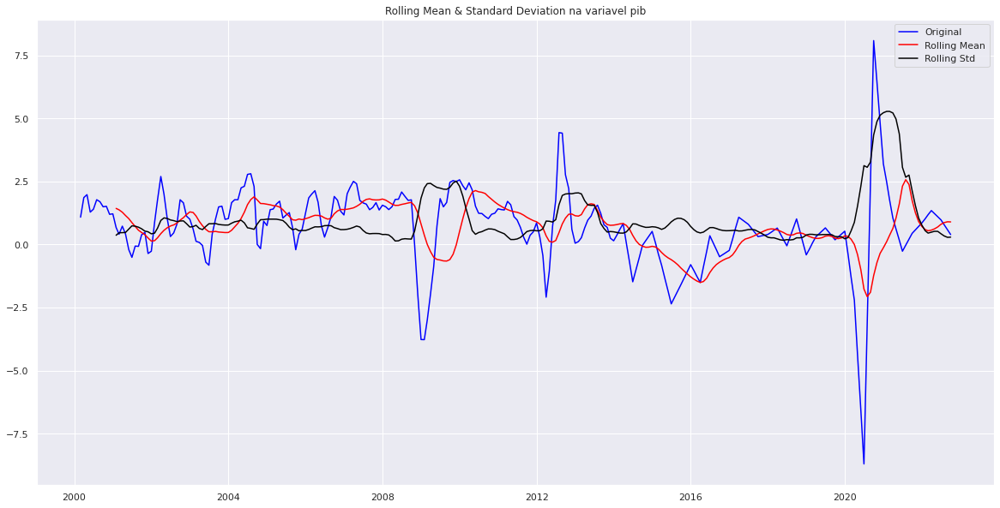

Results of Dickey-Fuller Test:Coluna pib
Test Statistic                 -6.03
p-value                         0.00
#Lags Used                      4.00
Number of Observations Used   267.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


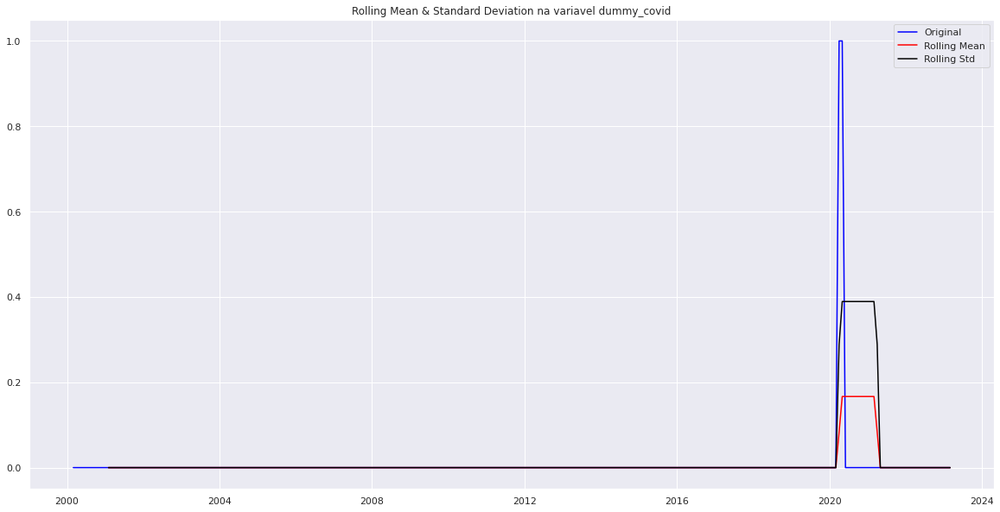

Results of Dickey-Fuller Test:Coluna dummy_covid
Test Statistic                 -5.18
p-value                         0.00
#Lags Used                      9.00
Number of Observations Used   267.00
Critical Value (1%)            -3.46
Critical Value (5%)            -2.87
Critical Value (10%)           -2.57
dtype: float64


/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(
/usr/local/lib/python3.8/dist-packages/statsmodels/tsa/stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-va

In [73]:
test = test_stationarity(dados_bac)

In [74]:
test

,Teste_kpss,Estacionaria_ou_nâo_kpss,Teste_adf,Estacionaria_ou_nâo_adf
rendimento_real_medio,0.01,Nâo estacionaria,0.04,Estacionaria
pessoas_forca_trabalho,0.01,Nâo estacionaria,0.76,Nâo estacionaria
taxa_desocupacao,0.01,Nâo estacionaria,0.46,Nâo estacionaria
caged,0.10,Estacionaria,0.08,Nâo estacionaria
ibovespa,0.10,Estacionaria,0.00,Estacionaria
ltn,0.01,Nâo estacionaria,0.47,Nâo estacionaria
exportacoes,0.01,Nâo estacionaria,0.64,Nâo estacionaria
importacoes,0.01,Nâo estacionaria,0.77,Nâo estacionaria
m_1,0.01,Nâo estacionaria,1.00,Nâo estacionaria
taxa_cambio,0.01,Nâo estacionaria,0.86,Nâo estacionaria


###Verificando a diferenca de estacionaridade
#http://alkaline-ml.com/pmdarima/1.5.1/modules/generated/pmdarima.arima.ndiffs.html

In [75]:
from pmdarima import arima

In [76]:
def report_ndiffs (dados,test=['kpss', 'adf', 'pp'],alpha=0.05):
  dat_ndifis = pd.DataFrame(index=dados.columns)
  for i in test:
    dat_n = []
    for j in dados.columns:
      dat_n.append(arima.ndiffs(dados[j].dropna(),alpha,test=i))
    dat_ndifis[i] = dat_n
  result = []
  for k in range(len(dat_ndifis)):
    result.append(np.where(dat_ndifis.iloc[k,0]==dat_ndifis.iloc[k,1],dat_ndifis.iloc[k,0],
         np.where(dat_ndifis.iloc[k,1]==dat_ndifis.iloc[k,2],dat_ndifis.iloc[k,1],
                  np.where(dat_ndifis.iloc[k,0]==dat_ndifis.iloc[k,2],dat_ndifis.iloc[k,2],''))))
  dat_ndifis['Ndifis'] = result
  dat_ndifis.sort_values(by='Ndifis',ascending=False,inplace=True)
  dat_ndifis['Ndifis'] = dat_ndifis['Ndifis'].astype(int)
  return dat_ndifis

In [77]:
n_difis = report_ndiffs(dados_bac)
n_difis

,kpss,adf,pp,Ndifis
Garantia_Imóveis,2,0,2,2
rendimento_real_medio,1,0,1,1
producao_agricola,1,1,1,1
volume_varejo,1,1,0,1
vendas_veilculos,1,1,0,1
indice_condicoes_economicas,1,1,1,1
capacidade_instalada,1,1,0,1
indice_confianca_consumidor,1,1,1,1
indice_tendencia_emprego,1,1,0,1
indice_confianca_manufatura,1,1,0,1


###Ajustando dados nao estacionarios metodo de diferenciacao

https://www.youtube.com/watch?v=JuG8hwVK5uQ

Modelagem de séries temporais frequentemente exige a aplicação de transformações nas variáveis, tal como a bem conhecida primeira diferença. Formalmente, podemos descrever essa transformação como:


Ou seja, dado uma série temporal regularmente espaçada, subtraímos do valor em t o valor anterior (t-1), obtendo a série dita "na primeira diferença" ou "nas diferenças".

A mudança de nível da série geralmente contorna diversas características "não desejadas" pelo analista como tendência, sazonalidade, etc., mas dificulta a interpretação dos valores - especialmente quando pretende-se comunicá-los para públicos não técnicos. Para este objetivo é de grande utilidade saber como diferenciar uma série temporal e, sobretudo, também como reverter a transformação.

In [78]:
"""
def corrigindo_nao_estacionaridade(base,n_difis,valor_predicao):
  dados_est = base.copy()
  for i in n_difis[n_difis['Ndifis'] >= 1].index:
    if i == valor_predicao:
      dados_est[i] = dados_est[i]
    else:
      dados_est[i] = dados_est[i].diff(periods=n_difis[n_difis.index.isin([i])]['Ndifis'])
  return dados_est"""

"\ndef corrigindo_nao_estacionaridade(base,n_difis,valor_predicao):\n  dados_est = base.copy()\n  for i in n_difis[n_difis['Ndifis'] >= 1].index:\n    if i == valor_predicao:\n      dados_est[i] = dados_est[i]\n    else:\n      dados_est[i] = dados_est[i].diff(periods=n_difis[n_difis.index.isin([i])]['Ndifis'])\n  return dados_est"

In [79]:
def corrigindo_nao_estacionaridade(base,n_difis,valor_predicao):
  dados_est = base.copy()
  for i in n_difis[n_difis['Ndifis'] >= 1].index:
    if i == valor_predicao:
      dados_est[i] = dados_est[i]
    else:
      j = 0
      while j < n_difis['Ndifis'][i]:
        dados_est[i] = dados_est[i].diff(periods=1)
        j = j+1
  return dados_est

In [80]:
dados_est = corrigindo_nao_estacionaridade(dados_bac,n_difis,'pib')[1:]
dados_est

,rendimento_real_medio,pessoas_forca_trabalho,taxa_desocupacao,caged,ibovespa,ltn,exportacoes,importacoes,m_1,taxa_cambio,...,indice_tendencia_emprego,indice_confianca_consumidor,capacidade_instalada,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo,pib,dummy_covid
2000-04-01,7.20,-1399.12,0.20,125071.00,-12.81,-3.23,-284.69,-457.04,294.07,0.03,...,-1.64,-0.30,0.40,-9.51,NaN,-1887.00,1249781.00,0.00,1.86,0
2000-05-01,0.50,-31.40,0.04,162837.00,-3.74,2.22,911.60,698.00,259.09,0.06,...,1.85,-0.19,-0.20,-1.13,-0.94,17932.00,1480989.00,1.99,1.98,0
2000-06-01,-2.57,35.81,-0.22,142884.00,11.84,-2.14,-239.26,-94.57,675.54,-0.02,...,-0.20,0.02,-0.10,5.29,0.15,-8403.00,1501091.00,-2.43,1.29,0
2000-07-01,-9.80,4.61,0.05,105842.00,-1.63,-1.25,227.30,278.71,1931.15,-0.01,...,-2.12,0.04,-0.10,-0.57,-1.20,1775.00,1510096.00,1.73,1.40,0
2000-08-01,15.28,116.61,0.12,78845.00,5.42,-1.04,461.87,541.56,341.59,0.01,...,-0.23,-0.06,0.00,-5.18,0.61,13087.00,1540235.00,-0.17,1.78,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-01,27.00,-250.00,-0.20,135495.00,-3.06,0.72,818.07,-1841.24,-150.37,0.02,...,-13.10,-0.07,-0.90,7.04,-0.03,15815.00,NaN,5.25,NaN,0
2022-12-01,6.00,-492.00,-0.20,-431011.00,0.50,-0.09,-1316.72,441.03,33197.69,-0.03,...,12.60,-0.05,-0.20,7.34,-0.03,941.00,NaN,16.46,NaN,0
2023-01-01,NaN,NaN,NaN,NaN,NaN,-0.28,-3787.85,-2085.36,-17582.09,-0.04,...,0.50,-0.12,-0.80,4.69,NaN,-62929.00,NaN,NaN,NaN,0
2023-02-01,NaN,NaN,NaN,NaN,NaN,-0.10,-2712.29,NaN,NaN,-0.03,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0


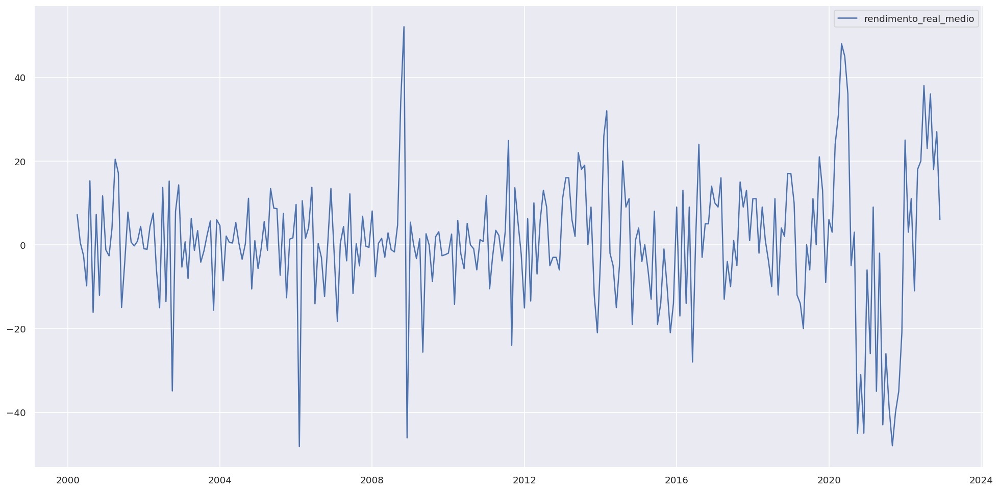

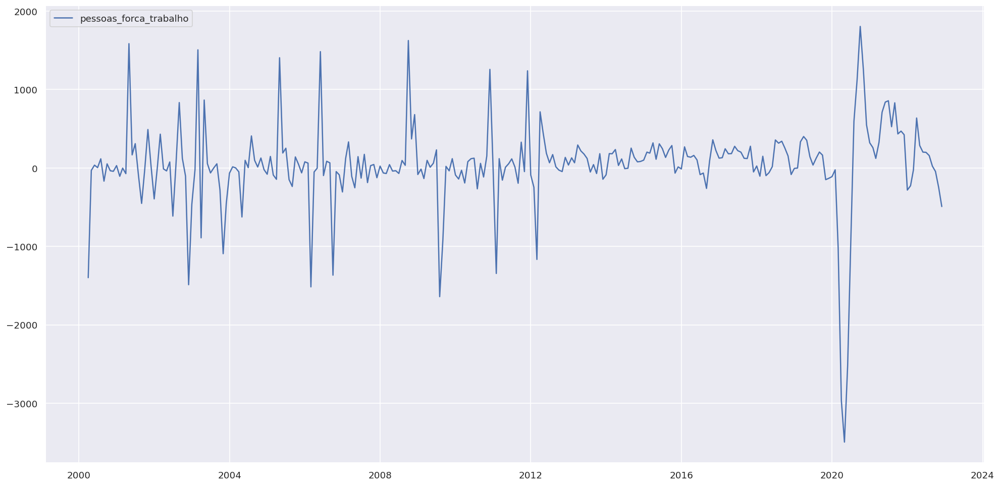

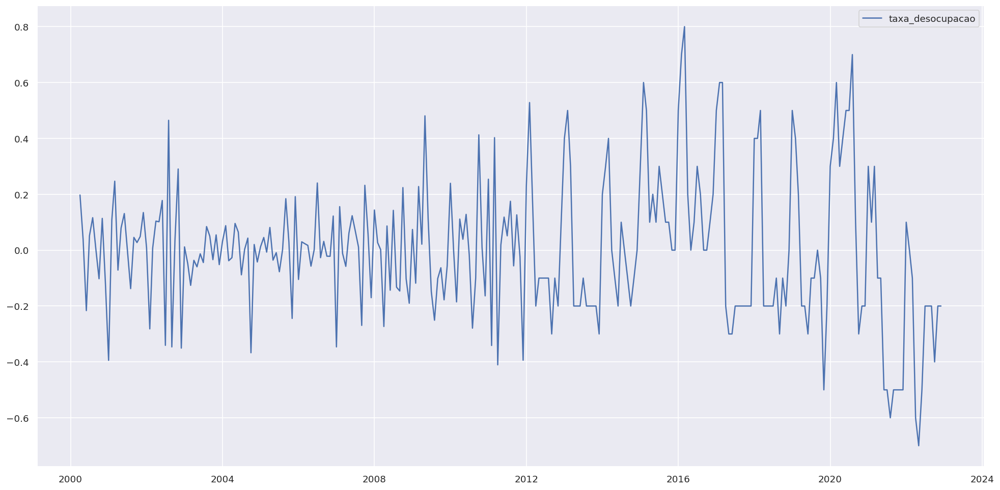

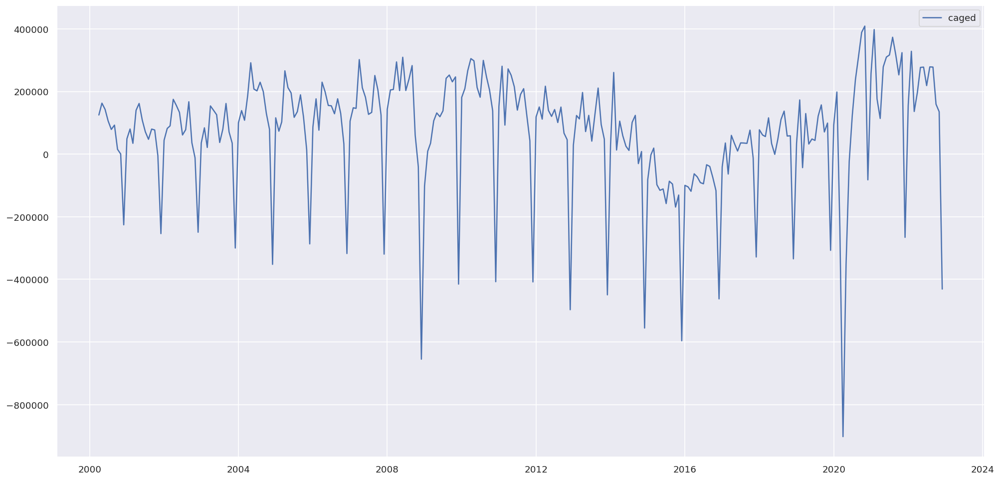

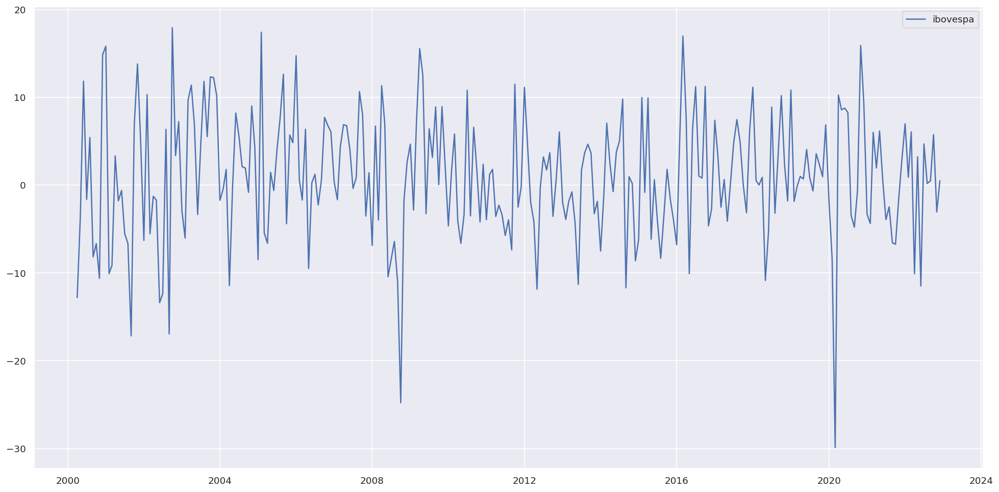

...

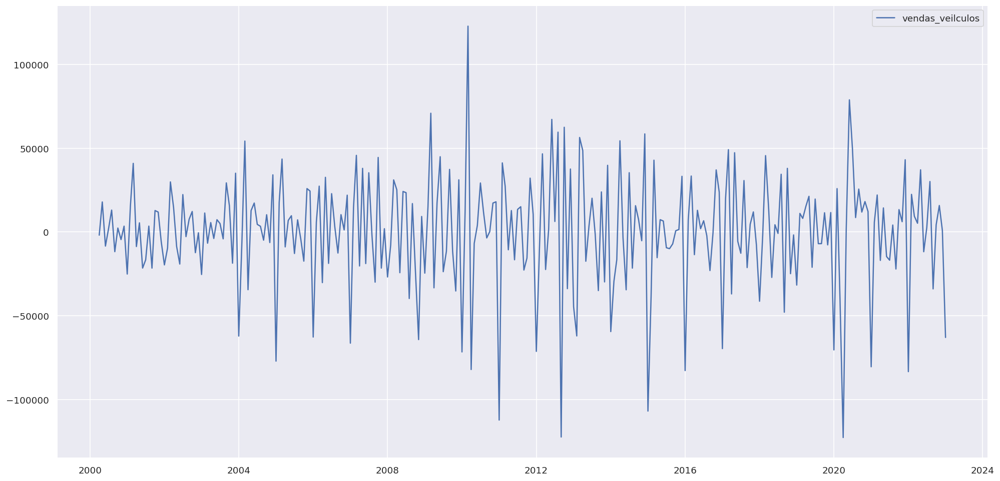

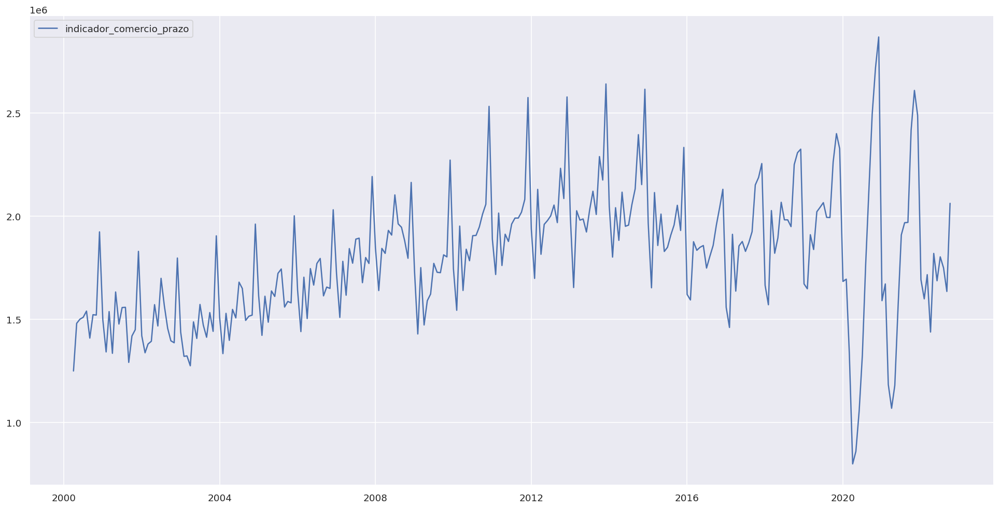

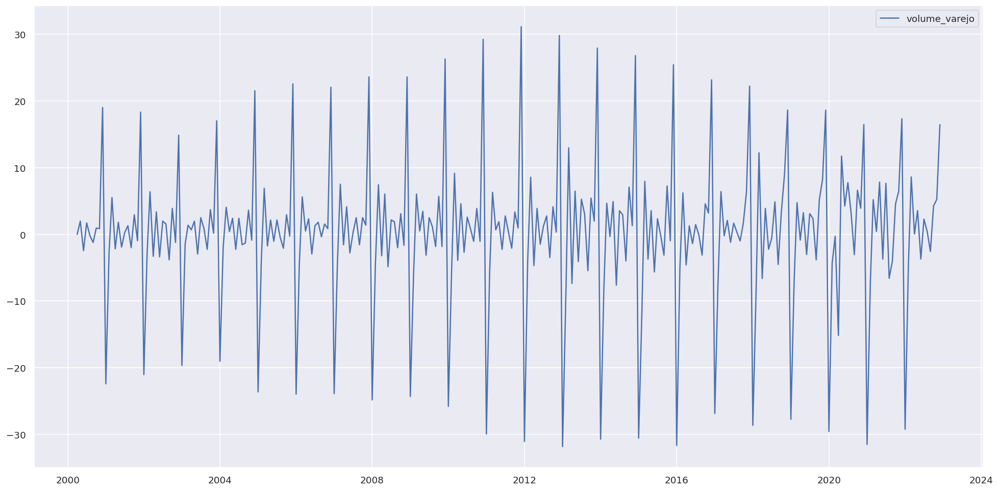

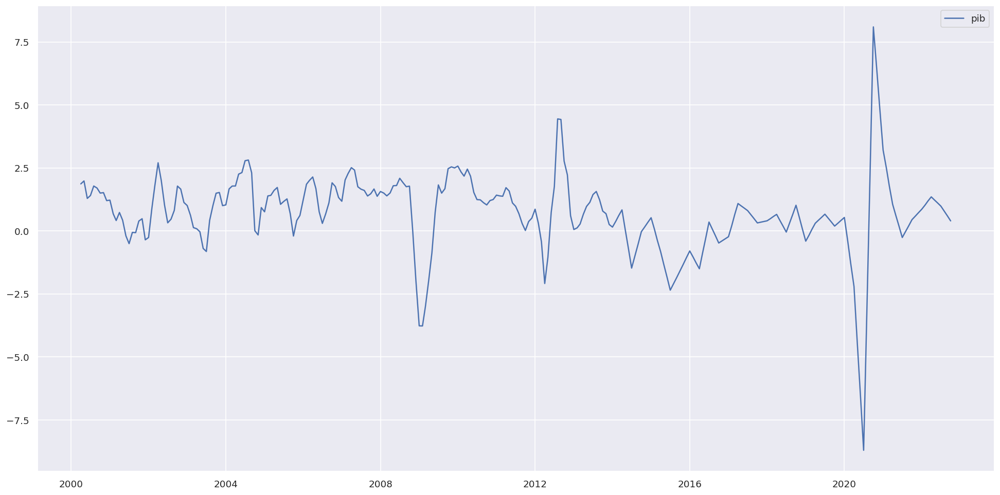

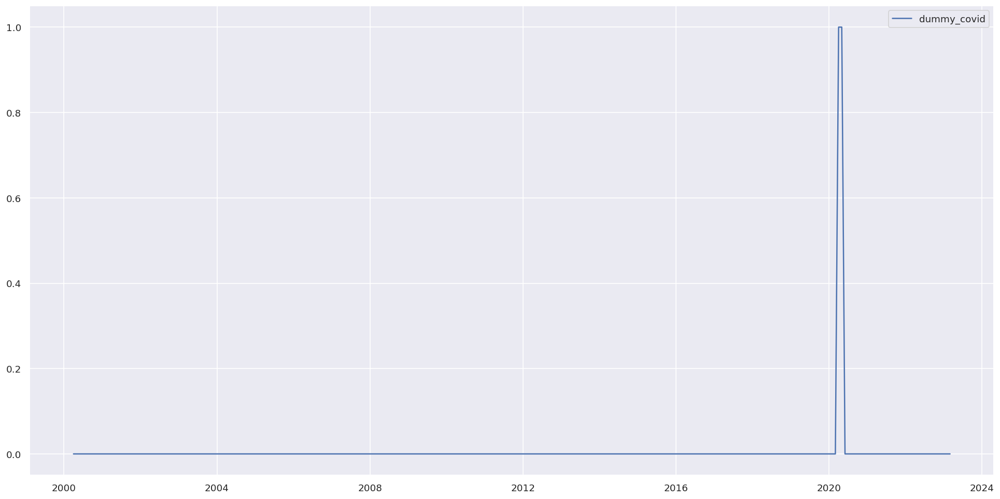

In [81]:
plotar(dados_est)

In [82]:
report_ndiffs(dados_est)

,kpss,adf,pp,Ndifis
rendimento_real_medio,0,0,0,0
indice_confianca_consumidor,0,0,0,0
taxa_cambio_efetiva,0,0,0,0
taxa_juros_interbancaria,0,0,0,0
atividade_economica_eua,0,0,0,0
indice_confianca_manufatura,0,0,0,0
indice_confianca_exportadores,0,0,0,0
indice_tendencia_emprego,0,0,0,0
capacidade_instalada,0,0,0,0
volume_servicos,0,0,0,0


##Corrigir atrasos de publicacao 

In [83]:
dados_est

,rendimento_real_medio,pessoas_forca_trabalho,taxa_desocupacao,caged,ibovespa,ltn,exportacoes,importacoes,m_1,taxa_cambio,...,indice_tendencia_emprego,indice_confianca_consumidor,capacidade_instalada,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo,pib,dummy_covid
2000-04-01,7.20,-1399.12,0.20,125071.00,-12.81,-3.23,-284.69,-457.04,294.07,0.03,...,-1.64,-0.30,0.40,-9.51,NaN,-1887.00,1249781.00,0.00,1.86,0
2000-05-01,0.50,-31.40,0.04,162837.00,-3.74,2.22,911.60,698.00,259.09,0.06,...,1.85,-0.19,-0.20,-1.13,-0.94,17932.00,1480989.00,1.99,1.98,0
2000-06-01,-2.57,35.81,-0.22,142884.00,11.84,-2.14,-239.26,-94.57,675.54,-0.02,...,-0.20,0.02,-0.10,5.29,0.15,-8403.00,1501091.00,-2.43,1.29,0
2000-07-01,-9.80,4.61,0.05,105842.00,-1.63,-1.25,227.30,278.71,1931.15,-0.01,...,-2.12,0.04,-0.10,-0.57,-1.20,1775.00,1510096.00,1.73,1.40,0
2000-08-01,15.28,116.61,0.12,78845.00,5.42,-1.04,461.87,541.56,341.59,0.01,...,-0.23,-0.06,0.00,-5.18,0.61,13087.00,1540235.00,-0.17,1.78,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-01,27.00,-250.00,-0.20,135495.00,-3.06,0.72,818.07,-1841.24,-150.37,0.02,...,-13.10,-0.07,-0.90,7.04,-0.03,15815.00,NaN,5.25,NaN,0
2022-12-01,6.00,-492.00,-0.20,-431011.00,0.50,-0.09,-1316.72,441.03,33197.69,-0.03,...,12.60,-0.05,-0.20,7.34,-0.03,941.00,NaN,16.46,NaN,0
2023-01-01,NaN,NaN,NaN,NaN,NaN,-0.28,-3787.85,-2085.36,-17582.09,-0.04,...,0.50,-0.12,-0.80,4.69,NaN,-62929.00,NaN,NaN,NaN,0
2023-02-01,NaN,NaN,NaN,NaN,NaN,-0.10,-2712.29,NaN,NaN,-0.03,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0


In [84]:
##Substituindo os ultimos valores pelos anterires
#dad = dados_est.fillna(method='ffill')

In [85]:
dados_sem = dados_est.loc[:,dados_est.columns != 'pib'].copy()
for k in dados_est.loc[:,dados_est.columns != 'pib'].columns[dados_sem.isnull().sum() > 0]:
  model_arima = arima.auto_arima(dados_sem[k].dropna().values, start_p=1, start_q=1,
                      test='adf',       # use adftest to find optimal 'd'
                      max_p=3, max_q=3, # maximum p and q
                      m=1,              # frequency of series
                      d=None,           # let model determine 'd'
                      seasonal=False,   # No Seasonality
                      start_P=0, 
                      D=0, 
                      trace=True,
                      error_action='ignore',  
                      suppress_warnings=True, 
                      stepwise=True)
  model_arima.fit(dados_sem[k].values)
  a = model_arima.predict(n_periods=int(dados_sem[k].isnull().sum()))
  for i in a:
    dados_sem[k] = dados_sem[k].fillna(i,limit=1)

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=2234.193, Time=0.12 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=2264.662, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=2245.787, Time=0.05 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=2253.813, Time=0.07 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=2225.627, Time=0.11 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=2224.684, Time=0.05 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=2225.882, Time=0.08 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=2227.369, Time=0.21 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=2226.555, Time=0.14 sec

Best model:  ARIMA(2,0,0)(0,0,0)[0]          
Total fit time: 0.875 seconds
Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=4162.343, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4220.958, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=4160.529, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=417

In [86]:
dados_sem = dados_sem.join(dados_bac['pib'])
dados_sem

,rendimento_real_medio,pessoas_forca_trabalho,taxa_desocupacao,caged,ibovespa,ltn,exportacoes,importacoes,m_1,taxa_cambio,...,indice_tendencia_emprego,indice_confianca_consumidor,capacidade_instalada,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo,dummy_covid,pib
2000-04-01,7.20,-1399.12,0.20,125071.00,-12.81,-3.23,-284.69,-457.04,294.07,0.03,...,-1.64,-0.30,0.40,-9.51,0.03,-1887.00,1249781.00,0.00,0,1.86
2000-05-01,0.50,-31.40,0.04,162837.00,-3.74,2.22,911.60,698.00,259.09,0.06,...,1.85,-0.19,-0.20,-1.13,-0.94,17932.00,1480989.00,1.99,0,1.98
2000-06-01,-2.57,35.81,-0.22,142884.00,11.84,-2.14,-239.26,-94.57,675.54,-0.02,...,-0.20,0.02,-0.10,5.29,0.15,-8403.00,1501091.00,-2.43,0,1.29
2000-07-01,-9.80,4.61,0.05,105842.00,-1.63,-1.25,227.30,278.71,1931.15,-0.01,...,-2.12,0.04,-0.10,-0.57,-1.20,1775.00,1510096.00,1.73,0,1.40
2000-08-01,15.28,116.61,0.12,78845.00,5.42,-1.04,461.87,541.56,341.59,0.01,...,-0.23,-0.06,0.00,-5.18,0.61,13087.00,1540235.00,-0.17,0,1.78
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-01,27.00,-250.00,-0.20,135495.00,-3.06,0.72,818.07,-1841.24,-150.37,0.02,...,-13.10,-0.07,-0.90,7.04,-0.03,15815.00,1847706.93,5.25,0,NaN
2022-12-01,6.00,-492.00,-0.20,-431011.00,0.50,-0.09,-1316.72,441.03,33197.69,-0.03,...,12.60,-0.05,-0.20,7.34,-0.03,941.00,1845577.44,16.46,0,NaN
2023-01-01,1.60,-21.56,-0.01,85823.44,0.91,-0.28,-3787.85,-2085.36,-17582.09,-0.04,...,0.50,-0.12,-0.80,4.69,0.02,-62929.00,1844394.01,-1.13,0,NaN
2023-02-01,1.22,-9.87,-0.00,88091.51,0.91,-0.10,-2712.29,-117.76,2008.14,-0.03,...,-0.38,-0.05,0.23,0.16,0.02,3265.77,1843696.39,0.92,0,NaN


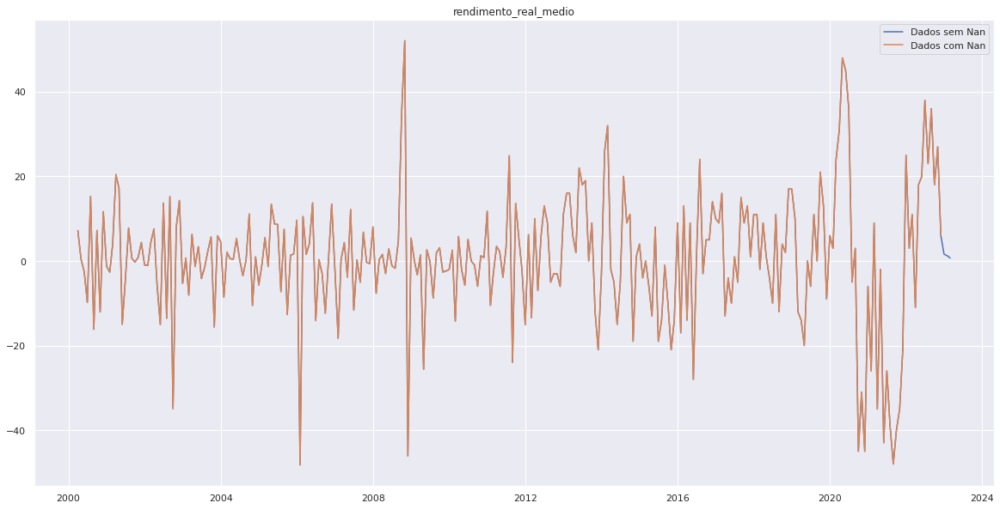

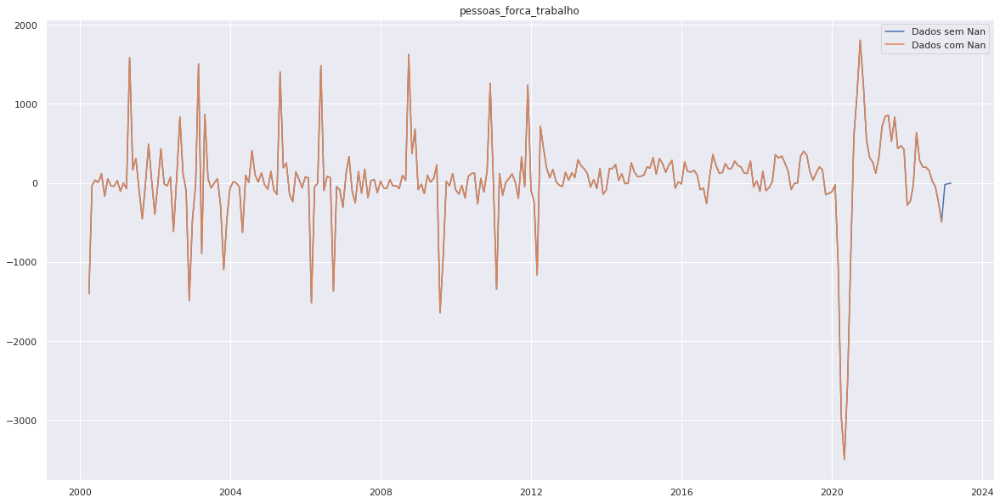

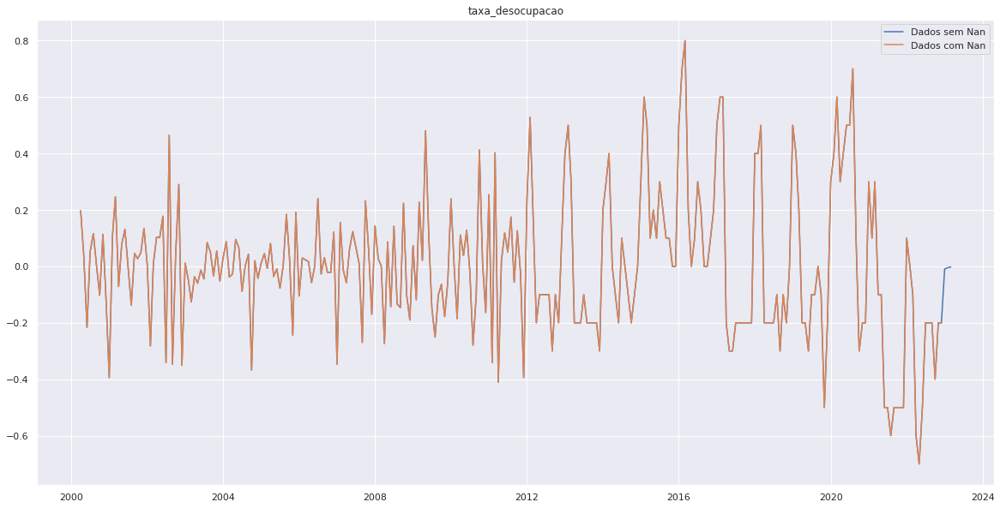

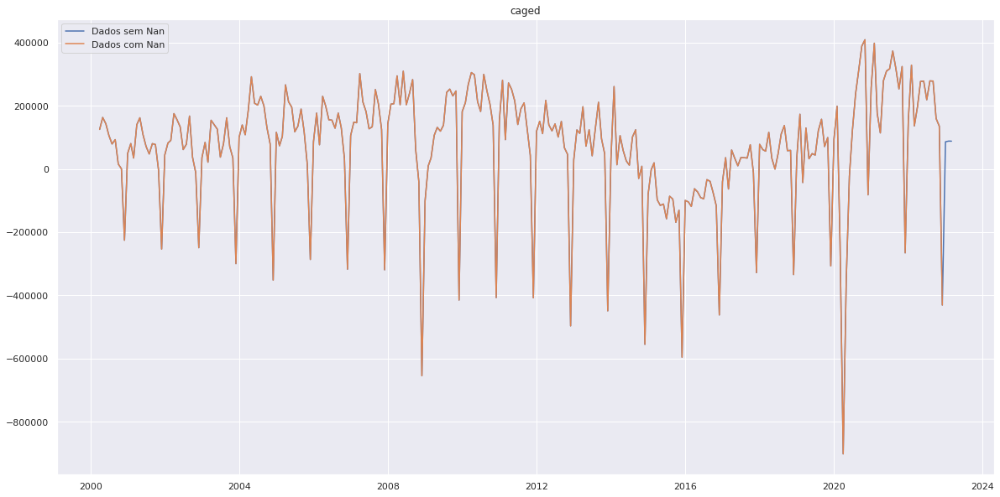

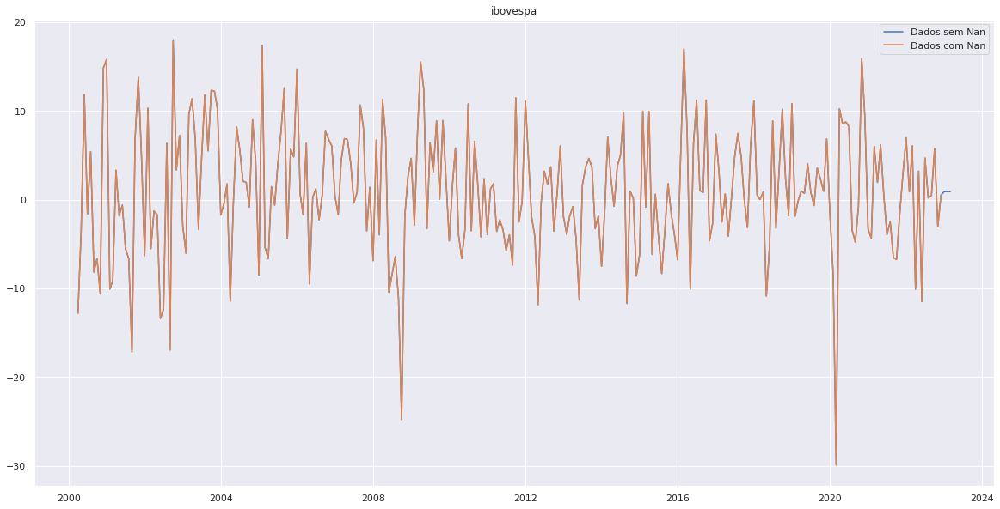

...

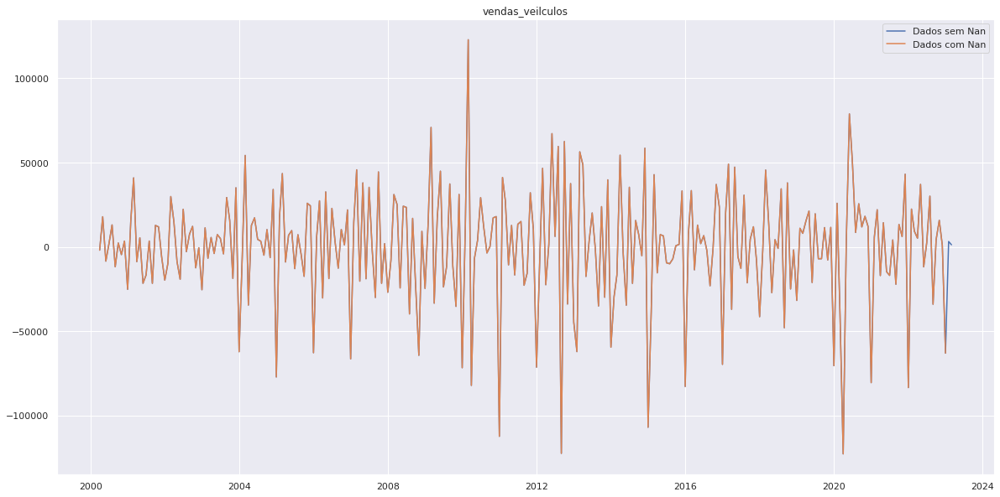

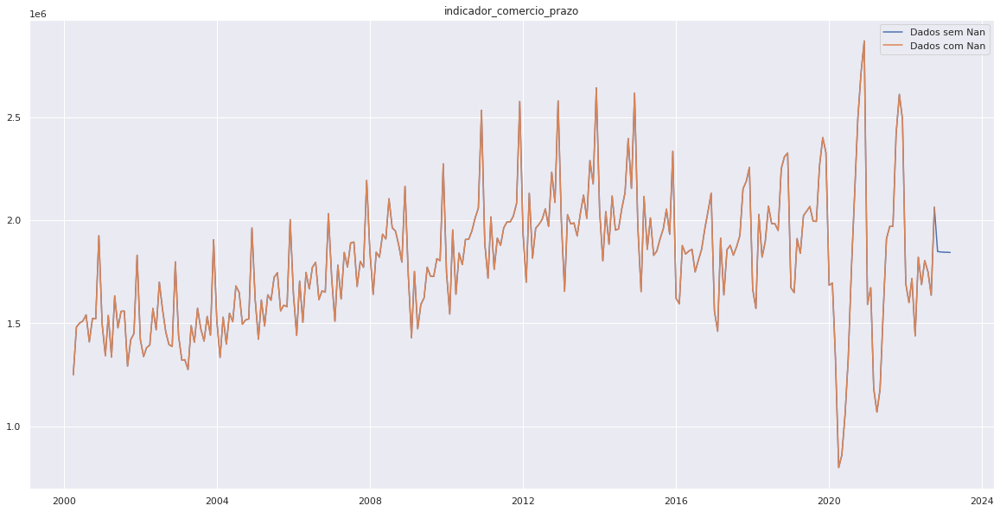

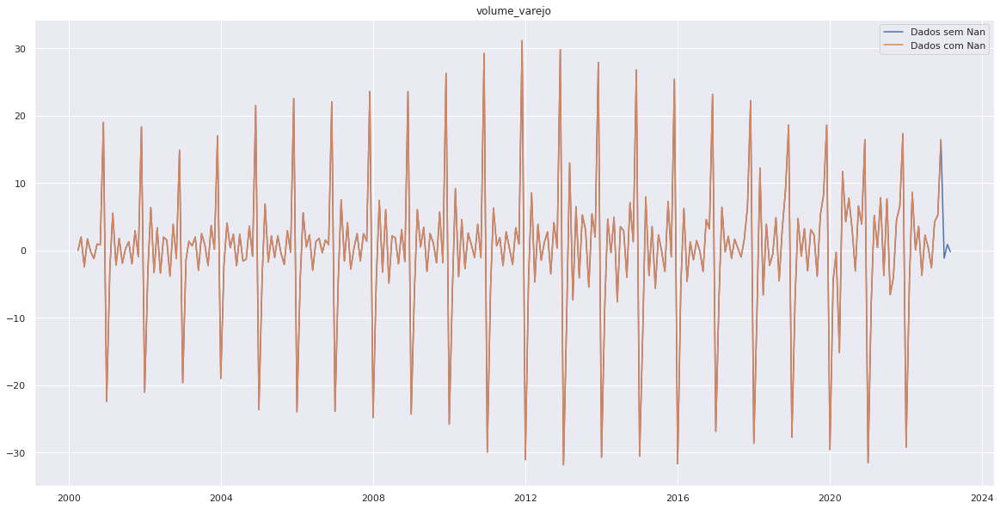

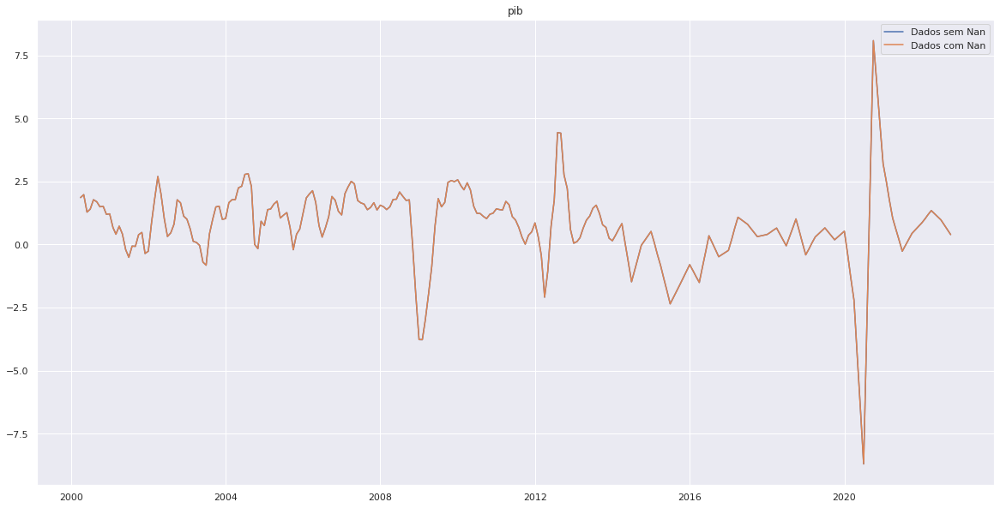

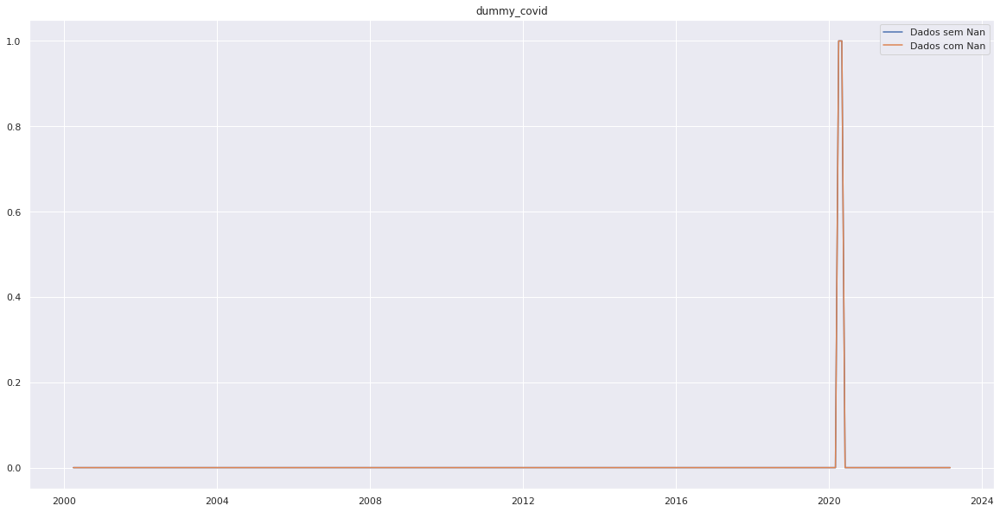

In [87]:
for i in dados_bac.columns:
  plt.plot(dados_sem[i], label= 'Dados sem Nan')
  plt.plot(dados_est[i], label = 'Dados com Nan')
  plt.title(i)
  plt.legend()
  plt.show()

In [88]:
dados_sem.to_csv('dados_pib.csv')

##Dividindo os dados em treino e teste

In [89]:
dados_sem

,rendimento_real_medio,pessoas_forca_trabalho,taxa_desocupacao,caged,ibovespa,ltn,exportacoes,importacoes,m_1,taxa_cambio,...,indice_tendencia_emprego,indice_confianca_consumidor,capacidade_instalada,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo,dummy_covid,pib
2000-04-01,7.20,-1399.12,0.20,125071.00,-12.81,-3.23,-284.69,-457.04,294.07,0.03,...,-1.64,-0.30,0.40,-9.51,0.03,-1887.00,1249781.00,0.00,0,1.86
2000-05-01,0.50,-31.40,0.04,162837.00,-3.74,2.22,911.60,698.00,259.09,0.06,...,1.85,-0.19,-0.20,-1.13,-0.94,17932.00,1480989.00,1.99,0,1.98
2000-06-01,-2.57,35.81,-0.22,142884.00,11.84,-2.14,-239.26,-94.57,675.54,-0.02,...,-0.20,0.02,-0.10,5.29,0.15,-8403.00,1501091.00,-2.43,0,1.29
2000-07-01,-9.80,4.61,0.05,105842.00,-1.63,-1.25,227.30,278.71,1931.15,-0.01,...,-2.12,0.04,-0.10,-0.57,-1.20,1775.00,1510096.00,1.73,0,1.40
2000-08-01,15.28,116.61,0.12,78845.00,5.42,-1.04,461.87,541.56,341.59,0.01,...,-0.23,-0.06,0.00,-5.18,0.61,13087.00,1540235.00,-0.17,0,1.78
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-01,27.00,-250.00,-0.20,135495.00,-3.06,0.72,818.07,-1841.24,-150.37,0.02,...,-13.10,-0.07,-0.90,7.04,-0.03,15815.00,1847706.93,5.25,0,NaN
2022-12-01,6.00,-492.00,-0.20,-431011.00,0.50,-0.09,-1316.72,441.03,33197.69,-0.03,...,12.60,-0.05,-0.20,7.34,-0.03,941.00,1845577.44,16.46,0,NaN
2023-01-01,1.60,-21.56,-0.01,85823.44,0.91,-0.28,-3787.85,-2085.36,-17582.09,-0.04,...,0.50,-0.12,-0.80,4.69,0.02,-62929.00,1844394.01,-1.13,0,NaN
2023-02-01,1.22,-9.87,-0.00,88091.51,0.91,-0.10,-2712.29,-117.76,2008.14,-0.03,...,-0.38,-0.05,0.23,0.16,0.02,3265.77,1843696.39,0.92,0,NaN


In [90]:
treino = dados_sem[dados_sem.index < pd.to_datetime('2021-01-01')]

In [91]:
treino

,rendimento_real_medio,pessoas_forca_trabalho,taxa_desocupacao,caged,ibovespa,ltn,exportacoes,importacoes,m_1,taxa_cambio,...,indice_tendencia_emprego,indice_confianca_consumidor,capacidade_instalada,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo,dummy_covid,pib
2000-04-01,7.20,-1399.12,0.20,125071.00,-12.81,-3.23,-284.69,-457.04,294.07,0.03,...,-1.64,-0.30,0.40,-9.51,0.03,-1887.00,1249781.00,0.00,0,1.86
2000-05-01,0.50,-31.40,0.04,162837.00,-3.74,2.22,911.60,698.00,259.09,0.06,...,1.85,-0.19,-0.20,-1.13,-0.94,17932.00,1480989.00,1.99,0,1.98
2000-06-01,-2.57,35.81,-0.22,142884.00,11.84,-2.14,-239.26,-94.57,675.54,-0.02,...,-0.20,0.02,-0.10,5.29,0.15,-8403.00,1501091.00,-2.43,0,1.29
2000-07-01,-9.80,4.61,0.05,105842.00,-1.63,-1.25,227.30,278.71,1931.15,-0.01,...,-2.12,0.04,-0.10,-0.57,-1.20,1775.00,1510096.00,1.73,0,1.40
2000-08-01,15.28,116.61,0.12,78845.00,5.42,-1.04,461.87,541.56,341.59,0.01,...,-0.23,-0.06,0.00,-5.18,0.61,13087.00,1540235.00,-0.17,0,1.78
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-08-01,-5.00,594.00,0.70,238125.00,-3.44,-0.03,-1989.18,-398.17,13048.41,0.18,...,9.30,0.70,3.00,-4.04,0.13,8603.00,1768346.00,3.15,0,-3.11
2020-09-01,3.00,1129.00,0.10,313564.00,-4.80,0.20,737.59,1318.87,19683.98,-0.06,...,-0.60,0.38,2.90,6.08,0.08,25612.00,2139736.00,-3.04,0,2.49
2020-10-01,-45.00,1805.00,-0.30,388938.00,-0.69,0.47,-480.56,200.60,13708.15,0.23,...,-6.20,0.02,1.60,-0.47,0.03,11894.00,2494920.00,6.63,0,8.10
2020-11-01,-31.00,1245.00,-0.20,408948.00,15.90,0.12,-282.54,1715.90,4629.20,-0.21,...,2.90,-0.22,-0.10,1.59,-0.03,18177.00,2719643.00,3.92,0,6.47


In [92]:
y_treino = treino['pib'].values
x_treino = treino.loc[:,treino.columns != 'pib'].values

In [93]:
teste = dados_sem[dados_sem.index >= pd.to_datetime('2021-01-01')]

In [94]:
##Criando os dados de validacao com os dados que nao tem ainda
dados_predicao = teste[teste['pib'].isnull()]
dados_predicao.drop('pib',axis=1,inplace=True)
dados_predicao

<ipython-input-94-1f0ad8baf15a>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dados_predicao.drop('pib',axis=1,inplace=True)


,rendimento_real_medio,pessoas_forca_trabalho,taxa_desocupacao,caged,ibovespa,ltn,exportacoes,importacoes,m_1,taxa_cambio,...,indice_confianca_exportadores,indice_tendencia_emprego,indice_confianca_consumidor,capacidade_instalada,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo,dummy_covid
2022-11-01,27.00,-250.00,-0.20,135495.00,-3.06,0.72,818.07,-1841.24,-150.37,0.02,...,-14.20,-13.10,-0.07,-0.90,7.04,-0.03,15815.00,1847706.93,5.25,0
2022-12-01,6.00,-492.00,-0.20,-431011.00,0.50,-0.09,-1316.72,441.03,33197.69,-0.03,...,-16.70,12.60,-0.05,-0.20,7.34,-0.03,941.00,1845577.44,16.46,0
2023-01-01,1.60,-21.56,-0.01,85823.44,0.91,-0.28,-3787.85,-2085.36,-17582.09,-0.04,...,-12.90,0.50,-0.12,-0.80,4.69,0.02,-62929.00,1844394.01,-1.13,0
2023-02-01,1.22,-9.87,-0.00,88091.51,0.91,-0.10,-2712.29,-117.76,2008.14,-0.03,...,-11.47,-0.38,-0.05,0.23,0.16,0.02,3265.77,1843696.39,0.92,0
2023-03-01,0.69,-4.51,-0.00,87875.48,0.91,-0.03,-1747.41,1450.39,2008.14,-0.00,...,-11.10,-0.28,0.01,0.14,-0.15,0.02,1294.93,1843248.26,-0.18,0


In [95]:
teste = teste.drop(dados_predicao.index)
y_teste = teste['pib'].values
x_teste= teste.loc[:,teste.columns != 'pib'].values

In [96]:
print('O tamanho do y_treino e ',y_treino.shape)
print('O tamanho do x_treino e ',x_treino.shape)
print('--------------------')
print('O tamanho do y_teste e ',y_teste.shape)
print('O tamanho do x_teste e ',x_teste.shape)
print('--------------------')
print('O tamanho dos dados para predicao sao ',dados_predicao.shape)

O tamanho do y_treino e  (249,)
O tamanho do x_treino e  (249, 34)
--------------------
O tamanho do y_teste e  (22,)
O tamanho do x_teste e  (22, 34)
--------------------
O tamanho dos dados para predicao sao  (5, 34)


#Treinando os modelos

#Aplicando Grid Search


##Treinando o RandomForestRegressor

In [ ]:
from scipy.stats import randint as sp_randint

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint as sp_randint
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, make_scorer
# definindo os hiperparâmetros
param_grid = {
  "n_estimators": [10, 20,50,60,100],
  "max_depth": [1,2,30,70,100],
  "min_samples_split": [2, 6,8,11],
  "min_samples_leaf": [1,4,9,11],
  "max_features": [1, 3,10,15,23],
  'criterion':['squared_error','absolute_error','friedman_mse']
}

# definição do RMSE como métrica de avaliação



# instanciando o modelo de random forest
rf = RandomForestRegressor()

# instanciando o randomized search
#random_search = RandomizedSearchCV(estimator=rf, param_distributions=param_grid, scoring= ['neg_root_mean_squared_error','neg_mean_absolute_percentage_error','neg_mean_absolute_error'], refit=False, cv=5, verbose=3)

search = GridSearchCV(estimator=rf, param_grid=param_grid, scoring= 'neg_root_mean_squared_error', cv=5, verbose=3)


# fit no modelo
search.fit(x_treino, y_treino)

# print dos melhores hiperparâmetros



In [ ]:
search.best_estimator_

##Treinando o Reggressao lasso

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor

models = [LinearRegression(), Ridge(), Lasso()]
param_grid = [
    {'fit_intercept': [True, False]},
    {'alpha': np.logspace(-3, 3, 1000)},
    {'alpha': np.logspace(-3, 3, 1020)}]
for model, param_grid_model in zip(models, param_grid):
    grid_search = GridSearchCV(model, param_grid_model, scoring='neg_mean_squared_error', cv=5, return_train_score=True)
    grid_search.fit(x_treino, y_treino)
    print(f"Model: {type(model).__name__}")
    print(f"Best parameters: {grid_search.best_params_}")
    print(f"Best cross-validation score: {grid_search.best_score_}")
    print("")


## Treinando gradiente Bosting 

In [ ]:
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV
# instanciar o modelo de Gradient Boosting
model = GradientBoostingRegressor()

# definir os hiperparâmetros a serem testados
param_grid = {
    "loss":["ls", "lad", "huber", "quantile"],
    "learning_rate":[0.1, 0.05, 0.01],
    "n_estimators":[100, 250, 500],
    "max_depth":[3, 5, 7, 9],
    "min_samples_split":[2, 4, 8],
    "min_samples_leaf":[1, 2, 4]
}

# instanciar o GridSearchCV
grid_search = GridSearchCV(model, param_grid, cv=5, scoring='neg_mean_squared_error',verbose=3)

# fit no modelo
grid_search.fit(x_treino, y_treino)

# print dos melhores hiperparâmetros
print("Melhores hiperparâmetros: ", grid_search.best_params_)

# prever com os melhores hiperparâmetros
y_pred = grid_search.predict(x_teste)


In [ ]:
grid_search.best_params_

In [ ]:
grid_search.best_score_

#Treinando os modelos com os melhores paramentros

In [97]:
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def evaluate_regression(y_true, y_pred, algorithm):
    metrics = {}
    metrics['MAE'] = mean_absolute_error(y_true, y_pred)
    metrics['MSE'] = mean_squared_error(y_true, y_pred)
    metrics['RMSE'] = np.sqrt(metrics['MSE'])
    metrics['R²'] = r2_score(y_true, y_pred)
    metrics_df = pd.DataFrame(metrics, index=[algorithm])
    return metrics_df


In [98]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso
lasso = Lasso(random_state=0,alpha=1.4518557013543454)
lasso.fit(x_treino, y_treino)

Lasso(alpha=1.4518557013543454, random_state=0)

In [99]:
from sklearn.ensemble import RandomForestRegressor
rfr = RandomForestRegressor(random_state=0,criterion='friedman_mse', max_depth=30, max_features=23,
                      min_samples_leaf=11, min_samples_split=11,
                      n_estimators=20)
rfr.fit(x_treino, y_treino)

RandomForestRegressor(criterion='friedman_mse', max_depth=30, max_features=23,
                      min_samples_leaf=11, min_samples_split=11,
                      n_estimators=20, random_state=0)

In [100]:
melhores_parametros = {'learning_rate': 0.1,
 'loss': 'absolute_error',
 'max_depth': 3,
 'min_samples_leaf': 2,
 'min_samples_split': 4,
 'n_estimators': 250}

In [102]:
from sklearn.ensemble import GradientBoostingRegressor
grad_bost = GradientBoostingRegressor(random_state=0, learning_rate= 0.1,loss='absolute_error',max_depth=3, min_samples_leaf= 2,min_samples_split=4,n_estimators=250)
grad_bost.fit(x_treino, y_treino)

GradientBoostingRegressor(loss='absolute_error', min_samples_leaf=2,
                          min_samples_split=4, n_estimators=250,
                          random_state=0)

In [103]:
import tensorflow as tf

model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Dense(units=40,activation='relu',input_shape=(x_treino.shape[1],),activity_regularizer='l1'))
model.add(tf.keras.layers.Dropout(0.11))
model.add(tf.keras.layers.Dense(units=40,activation='relu',activity_regularizer='l1'))
model.add(tf.keras.layers.Dropout(0.11))
model.add(tf.keras.layers.Dense(units=40,activation='relu',activity_regularizer='l1'))
model.add(tf.keras.layers.Dropout(0.11))
model.add(tf.keras.layers.Dense(units=40,activation='relu',activity_regularizer='l1'))
model.add(tf.keras.layers.Dropout(0.10))
model.add(tf.keras.layers.Dense(units=30,activation='relu',activity_regularizer='l1'))
model.add(tf.keras.layers.Dropout(0.10))
model.add(tf.keras.layers.Dense(units=25,activation='relu',activity_regularizer='l1'))
model.add(tf.keras.layers.Dropout(0.10))
model.add(tf.keras.layers.Dense(units=20,activation='relu',activity_regularizer='l1'))
model.add(tf.keras.layers.Dropout(0.10))
model.add(tf.keras.layers.Dense(units=10,activation='relu',activity_regularizer='l1'))
model.add(tf.keras.layers.Dropout(0.20))
model.add(tf.keras.layers.Dense(units=1,activation='linear'))
model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mean_absolute_error'])
model.fit(x_treino, y_treino, epochs=1000,batch_size=100)

Epoch 1/1000
3/3 [==============================] - 10s 21ms/step - loss: 4131779072.0000 - mean_absolute_error: 37054.0195
Epoch 2/1000
3/3 [==============================] - 0s 26ms/step - loss: 2102355968.0000 - mean_absolute_error: 24897.7207
Epoch 3/1000
3/3 [==============================] - 0s 15ms/step - loss: 1360711168.0000 - mean_absolute_error: 18334.9473
Epoch 4/1000
3/3 [==============================] - 0s 11ms/step - loss: 1129895168.0000 - mean_absolute_error: 14726.1309
Epoch 5/1000
3/3 [==============================] - 0s 13ms/step - loss: 604828160.0000 - mean_absolute_error: 11903.9023
Epoch 6/1000
3/3 [==============================] - 0s 10ms/step - loss: 361506464.0000 - mean_absolute_error: 8842.1895
Epoch 7/1000
3/3 [==============================] - 0s 9ms/step - loss: 106585632.0000 - mean_absolute_error: 6090.0103
Epoch 8/1000
3/3 [==============================] - 0s 9ms/step - loss: 237175696.0000 - mean_absolute_error: 7681.4790
Epoch 9/1000
3/3 [======

##Avaliando os residuos dos medelos

https://medium.com/@krzysztofdrelczuk/acf-autocorrelation-function-simple-explanation-with-python-example-492484c32711

###Regressao lasso
Model: Lasso
Best parameters: {'alpha': 84.79322206477522}
Best cross-validation score: -240.0006812727942

In [104]:
predic_treino_lasso = lasso.predict(x_treino)

In [105]:
residuo_lasso = y_treino - predic_treino_lasso

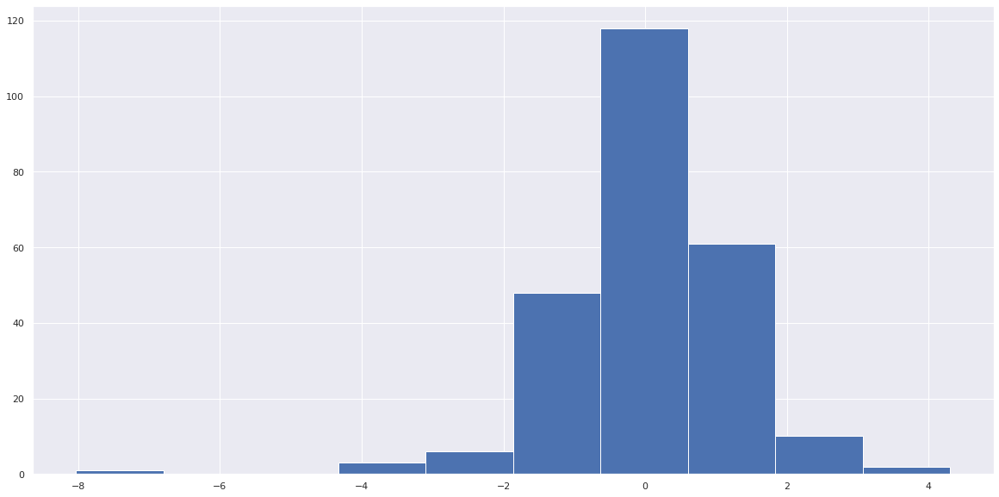

In [106]:
plt.hist(residuo_lasso);

In [107]:
import statsmodels.api as sm

Gráfico ACF de resíduos
Com dados de séries temporais, é altamente provável que o valor de uma variável observada no período de tempo atual seja semelhante ao seu valor no período anterior, ou mesmo no período anterior a esse, e assim por diante. Portanto, ao ajustar um modelo de regressão a dados de séries temporais, é comum encontrar autocorrelação nos resíduos. Nesse caso, o modelo estimado viola a suposição de não haver autocorrelação nos erros, e nossas previsões podem ser ineficientes — sobra alguma informação que deve ser contabilizada no modelo para obter melhores previsões. As previsões de um modelo com erros autocorrelacionados ainda não são viesadas e, portanto, não estão “erradas”, mas geralmente terão intervalos de previsão maiores do que o necessário. Portanto, devemos sempre olhar para um gráfico ACF dos resíduos.

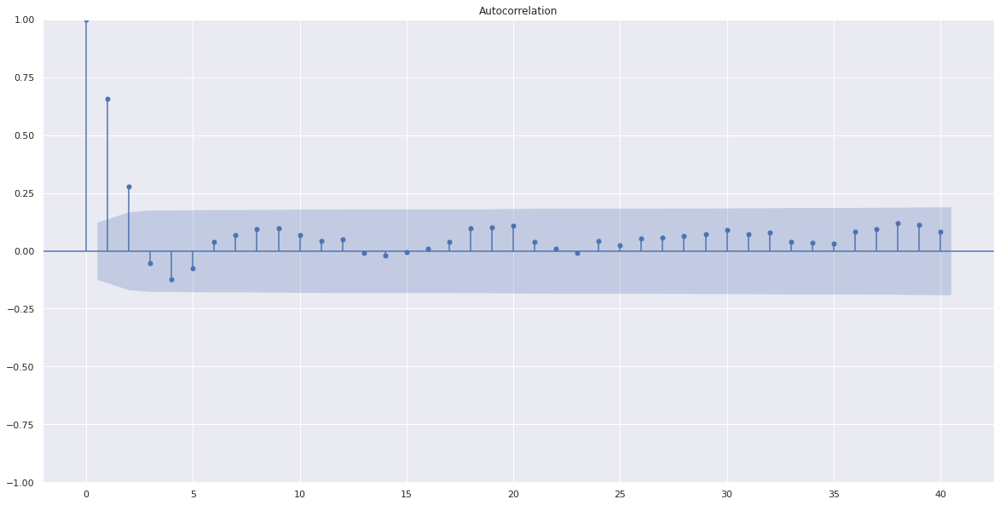

In [108]:
sm.graphics.tsa.plot_acf(residuo_lasso,lags=40)
plt.show()

###Random forest
RandomForestRegressor(max_depth=100, max_features=15, min_samples_leaf=4,
                      min_samples_split=8, n_estimators=20)

In [109]:
predic_rando_treino = rfr.predict(x_treino)

In [110]:
residuo_random = y_treino-predic_rando_treino

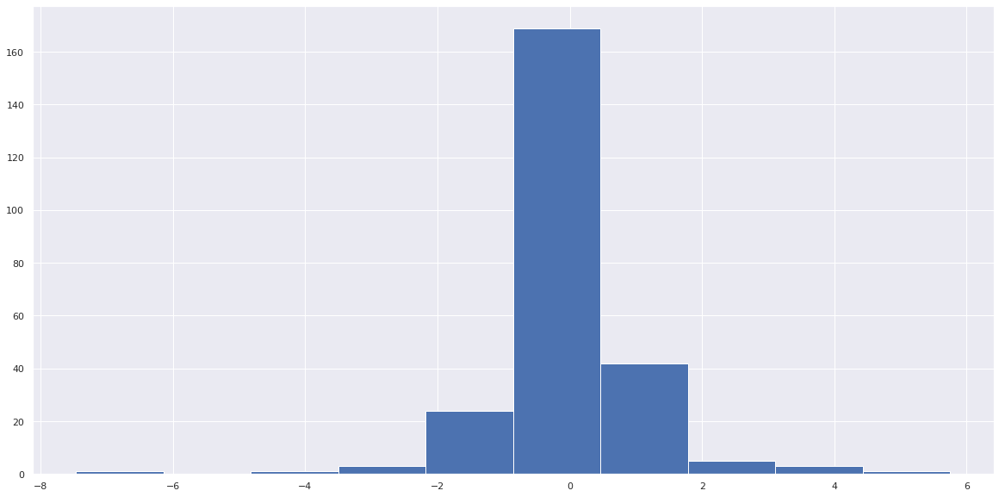

In [111]:
plt.hist(residuo_random);

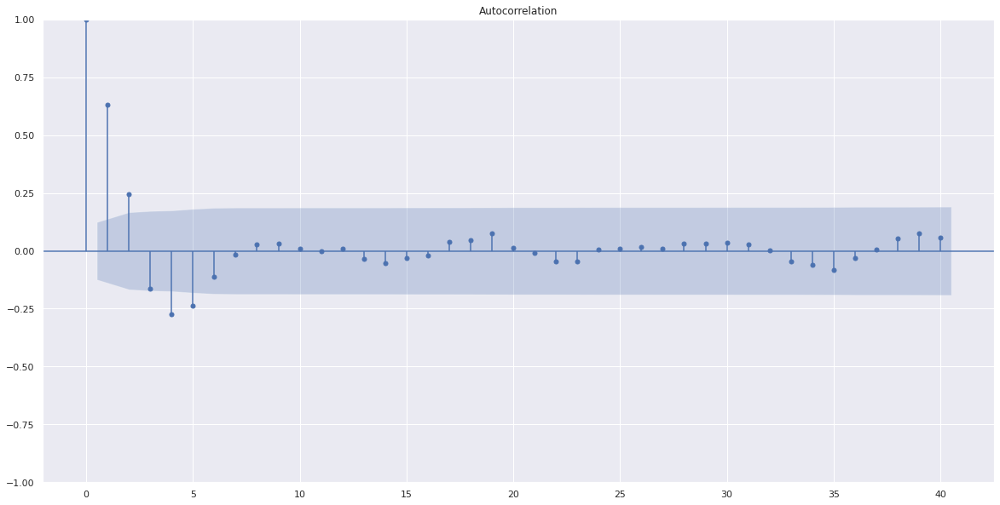

In [112]:
sm.graphics.tsa.plot_acf(residuo_random,lags=40)
plt.show()

###Gradiente Boosting


In [113]:
predict_grad_treino = grad_bost.predict(x_treino)

In [114]:
residuo_grad = y_treino - predict_grad_treino

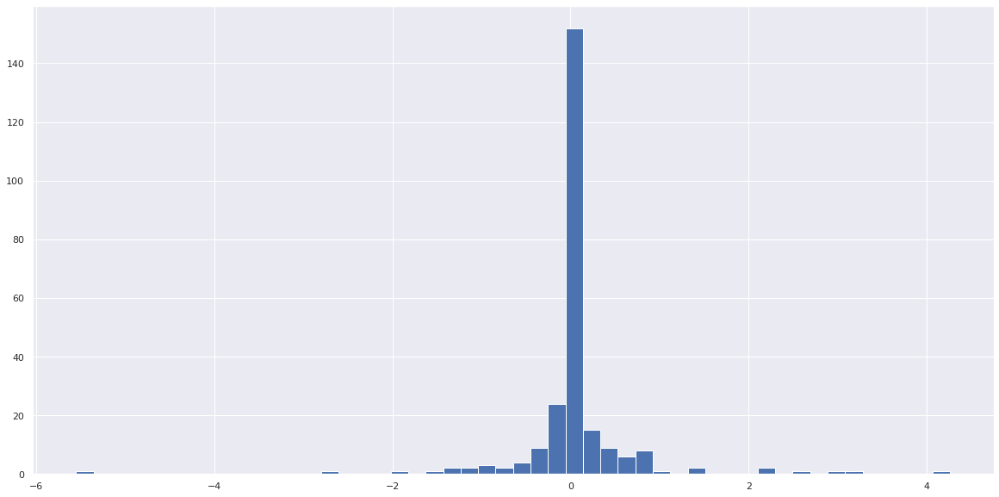

In [115]:
plt.hist(residuo_grad,bins=50);

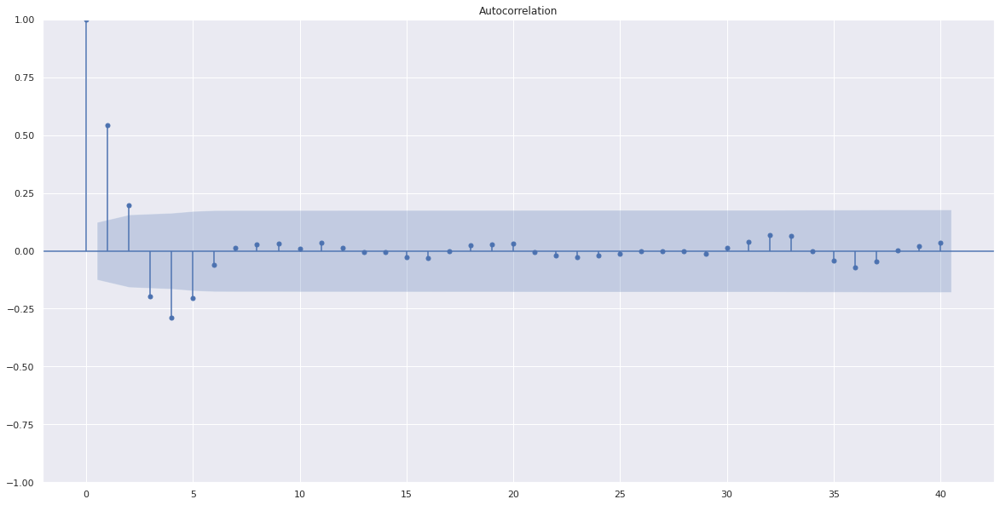

In [116]:
sm.graphics.tsa.plot_acf(residuo_grad,lags=40)
plt.show()

###Redes neurais

In [117]:
predict_redes_treino = model.predict(x_treino)

8/8 [==============================] - 0s 3ms/step


In [118]:
#Retirando um dimensao do array
predict_redes_treino = np.squeeze(predict_redes_treino)
predict_redes_treino

array([-4.2529063 , -3.0754015 , -0.8011629 , -4.1019382 , -0.839912  ,
       -3.2979887 , -7.709221  , -3.2167377 , -0.78638726, -2.3526177 ,
       -2.684624  , -6.0245667 , -1.4875801 , -3.8870077 , -3.9159963 ,
       -0.8654601 , -1.0620496 , -0.33091828, -0.8060618 , -7.598723  ,
       -0.81628174, -3.160628  , -2.253751  , -3.2688148 , -3.5412428 ,
       -0.6503508 , -0.66780335, -0.51232016, -3.5847902 , -3.4289064 ,
       -3.2042482 , -3.206662  , -0.8398773 , -3.167883  , -0.31913418,
       -3.3240635 , -3.4821098 , -5.4645147 , -3.4523418 , -2.5654213 ,
       -1.342724  , -4.04383   , -3.7797296 , -0.8380161 , -2.0011866 ,
       -4.1030626 , -3.6226249 , -5.0558686 , -2.8934689 , -4.0105267 ,
       -2.7645802 , -9.959777  , -2.966594  , -0.35855824, -4.850847  ,
       -0.73622495, -2.5280523 , -3.3348613 , -4.6766186 , -2.0162773 ,
       -0.46360713, -1.6192752 , -0.6712915 , -6.227114  , -4.826421  ,
       -9.427012  , -3.7204354 , -1.4184645 , -1.0562366 , -0.57

In [119]:
residuo_neurais = y_treino - predict_redes_treino

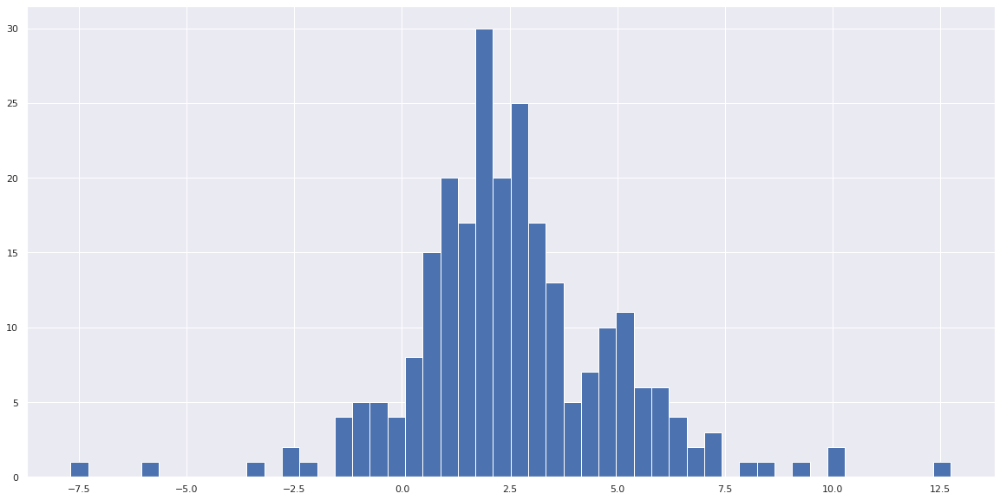

In [120]:
plt.hist(residuo_neurais,bins=50);

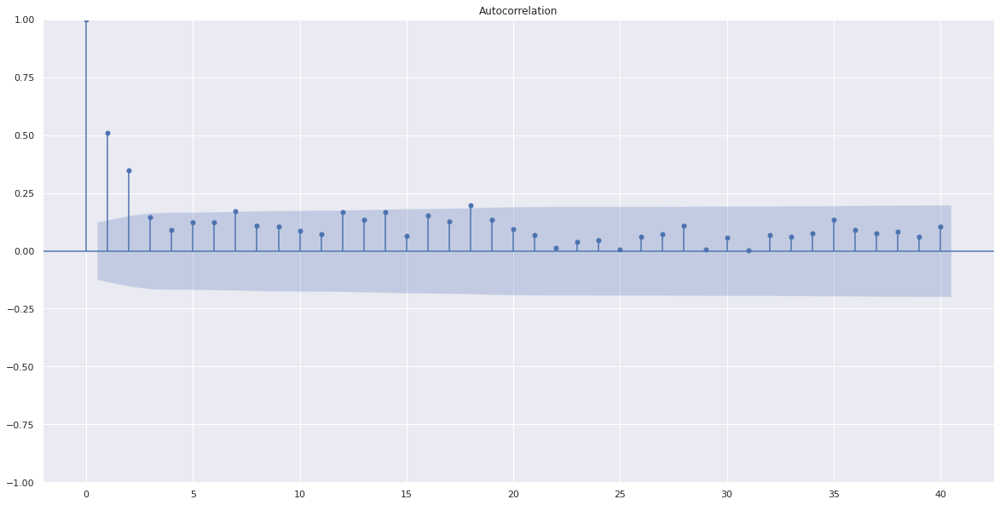

In [121]:
sm.graphics.tsa.plot_acf(residuo_neurais,lags=40)
plt.show()


##Avaliando os dados de treino

In [122]:
metrics_random_treino = evaluate_regression(y_treino,predic_rando_treino, 'Random Forest Regression')
metrics_linear_treino = evaluate_regression(y_treino,predic_treino_lasso, 'Linear Regression')
metrics_grad_treino = evaluate_regression(y_treino,predict_grad_treino, 'Gradiente Boosting Regression')
metrics_redes_treino = evaluate_regression(y_treino,predict_redes_treino, 'Redes Neurais')
metrics_treino = pd.concat([metrics_random_treino, metrics_linear_treino,metrics_grad_treino,metrics_redes_treino])
metrics_treino

,MAE,MSE,RMSE,R²
Random Forest Regression,0.64,1.17,1.08,0.55
Linear Regression,0.84,1.47,1.21,0.43
Gradiente Boosting Regression,0.29,0.50,0.71,0.80
Redes Neurais,2.85,12.30,3.51,-3.77


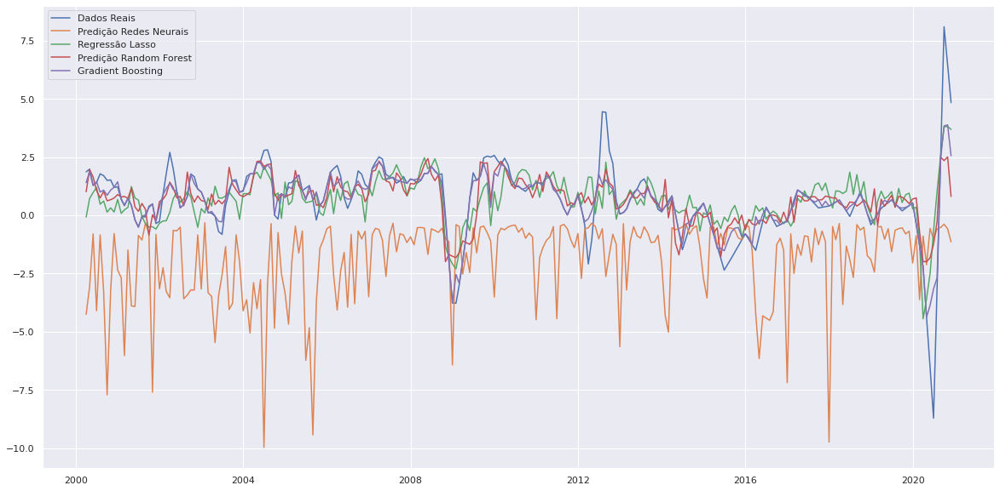

In [123]:
#Plotando as predicoes
plt.plot(treino.index,y_treino,label='Dados Reais')
plt.plot(treino.index,predict_redes_treino,label='Predição Redes Neurais')
plt.plot(treino.index,predic_treino_lasso,label='Regressão Lasso')
plt.plot(treino.index,predic_rando_treino,label='Predição Random Forest')
plt.plot(treino.index,predict_grad_treino,label='Gradient Boosting')
plt.legend();

##Avaliando nos dados de teste

In [124]:
predic_teste_lasso = lasso.predict(x_teste)

In [125]:
predic_rando_teste = rfr.predict(x_teste)

In [126]:
predict_grad_teste = grad_bost.predict(x_teste)

In [127]:
predict_redes_teste = model.predict(x_teste)
predict_redes_teste = np.squeeze(predict_redes_teste)

1/1 [==============================] - 0s 25ms/step


In [128]:
metrics_random_teste = evaluate_regression(y_teste,predic_rando_teste, 'Random Forest Regression')
metrics_linear_teste = evaluate_regression(y_teste,predic_teste_lasso, 'Linear Regression')
metrics_grad_teste = evaluate_regression(y_teste,predict_grad_teste, 'Gradiente Boosting Regression')
metrics_redes_teste = evaluate_regression(y_teste,predict_redes_teste, 'Redes Neurais')
metrics_teste = pd.concat([metrics_random_teste, metrics_linear_teste,metrics_grad_teste,metrics_redes_teste])
metrics_teste

,MAE,MSE,RMSE,R²
Random Forest Regression,1.00,1.51,1.23,-1.54
Linear Regression,1.28,3.19,1.79,-4.37
Gradiente Boosting Regression,1.05,2.12,1.45,-2.56
Redes Neurais,3.07,12.77,3.57,-20.50


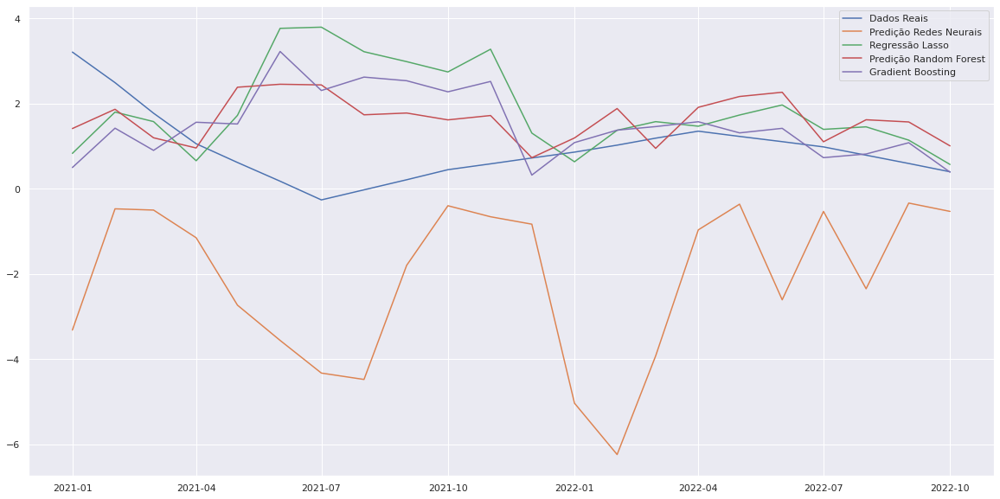

In [129]:
#Plotando as predicoes
plt.plot(teste.index,y_teste,label='Dados Reais')
plt.plot(teste.index,predict_redes_teste,label='Predição Redes Neurais')
plt.plot(teste.index,predic_teste_lasso,label='Regressão Lasso')
plt.plot(teste.index,predic_rando_teste,label='Predição Random Forest')
plt.plot(teste.index,predict_grad_teste,label='Gradient Boosting')
plt.legend();

##Intervalo de previsao

In [130]:
def intervalo_predicao_bootstraps(x_treino,y_treino,modelo_treinado,x_teste,index,predicao,nome_algoritimo,percentiles = [2.5, 97.5],n_bootstraps=1000):
  import numpy as np
  from sklearn.utils import resample

  # Bootstrap
  n_samples = len(x_treino)
  bootstrapped_predictions = np.zeros((n_bootstraps, len(x_teste)))
  
  if nome_algoritimo == 'Redes Neurais':
    for i in range(n_bootstraps):
      bootstrapped_data = resample(np.column_stack((x_treino, y_treino)), replace=True, n_samples=n_samples, random_state=i)
      bootstrapped_x_train, bootstrapped_y_train = bootstrapped_data[:, :-1], bootstrapped_data[:, -1]
      bootstrapped_model = modelo_treinado.fit(bootstrapped_x_train, bootstrapped_y_train, epochs=100,batch_size=100,verbose=0)
      bootstrapped_predictions[i] = np.squeeze(model.predict(x_teste))
  else:
    for i in range(n_bootstraps):
      bootstrapped_data = resample(np.column_stack((x_treino, y_treino)), replace=True, n_samples=n_samples, random_state=i)
      bootstrapped_x_train, bootstrapped_y_train = bootstrapped_data[:, :-1], bootstrapped_data[:, -1]
      bootstrapped_model = modelo_treinado.fit(bootstrapped_x_train, bootstrapped_y_train)
      bootstrapped_predictions[i] = bootstrapped_model.predict(x_teste)

  # Calcula intervalos de previsão
  lower = np.percentile(bootstrapped_predictions, percentiles[0], axis=0)
  upper = np.percentile(bootstrapped_predictions, percentiles[1], axis=0)

  intervalos = pd.DataFrame(index=index)
  intervalos['Predicao'] = predicao
  intervalos[f'lower({percentiles[0]})'] = lower
  intervalos[f'upper({percentiles[1]})'] = upper

  import matplotlib.pyplot as plt

  plt.plot(index,predicao,'*')
  plt.fill_between(index,lower, upper, color='gray', alpha=0.5, label=f'Intervalo de confiança de {percentiles[1]-percentiles[0]}%')
  plt.legend()
  plt.xlabel('Datas')
  plt.ylabel('Predição')
  plt.title('Previsões com intervalo de confiança para a'+' '+nome_algoritimo)
  plt.show()
  return intervalos

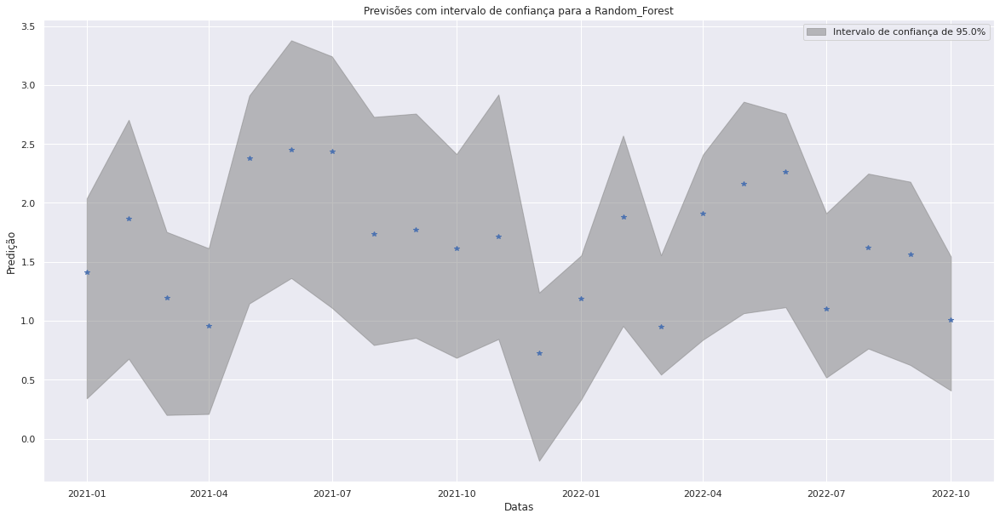

In [131]:
intervalo_random = intervalo_predicao_bootstraps(x_treino,y_treino,rfr,x_teste,teste.index,predic_rando_teste,'Random_Forest')

In [132]:
(intervalo_random['Predicao'] - intervalo_random['lower(2.5)']).mean()

0.9407877053372268

In [133]:
(intervalo_random['Predicao'] - intervalo_random['upper(97.5)']).mean()

-0.6992415839591513

In [134]:
intervalo_random

,Predicao,lower(2.5),upper(97.5)
2021-01-01,1.41,0.34,2.04
2021-02-01,1.86,0.68,2.70
2021-03-01,1.19,0.20,1.75
2021-04-01,0.95,0.21,1.62
2021-05-01,2.38,1.15,2.91
2021-06-01,2.45,1.36,3.38
2021-07-01,2.44,1.11,3.24
2021-08-01,1.73,0.79,2.73
2021-09-01,1.78,0.85,2.76
2021-10-01,1.61,0.69,2.41


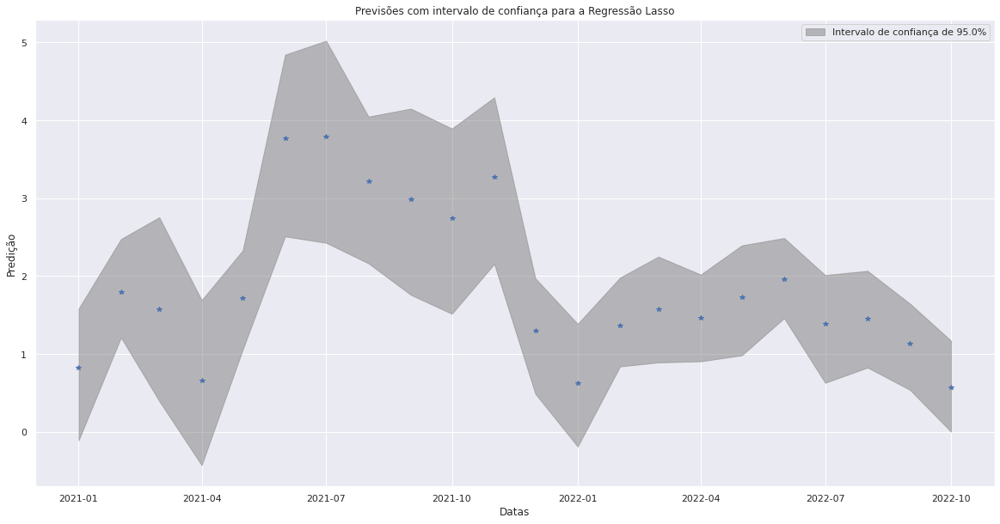

In [135]:
intervalo_lasso = intervalo_predicao_bootstraps(x_treino,y_treino,lasso,x_teste,teste.index,predic_teste_lasso,'Regressão Lasso')

In [136]:
intervalo_lasso

,Predicao,lower(2.5),upper(97.5)
2021-01-01,0.83,-0.11,1.58
2021-02-01,1.80,1.21,2.48
2021-03-01,1.57,0.40,2.76
2021-04-01,0.65,-0.43,1.69
2021-05-01,1.72,1.06,2.33
2021-06-01,3.76,2.51,4.84
2021-07-01,3.79,2.43,5.02
2021-08-01,3.22,2.16,4.05
2021-09-01,2.98,1.76,4.15
2021-10-01,2.74,1.52,3.89


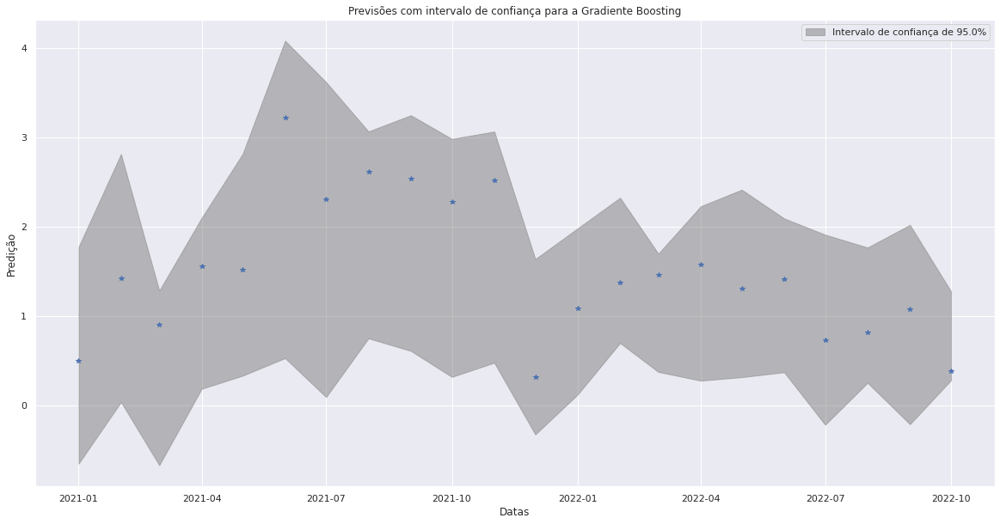

In [137]:
intervalo_grad = intervalo_predicao_bootstraps(x_treino,y_treino,grad_bost,x_teste,teste.index,predict_grad_teste,'Gradiente Boosting',n_bootstraps=100)

In [138]:
intervalo_grad

,Predicao,lower(2.5),upper(97.5)
2021-01-01,0.50,-0.65,1.78
2021-02-01,1.42,0.04,2.81
2021-03-01,0.90,-0.67,1.28
2021-04-01,1.56,0.18,2.10
2021-05-01,1.52,0.33,2.82
2021-06-01,3.22,0.53,4.08
2021-07-01,2.30,0.09,3.62
2021-08-01,2.62,0.75,3.07
2021-09-01,2.53,0.61,3.25
2021-10-01,2.27,0.32,2.98


1/1 [==============================] - 0s 23ms/step


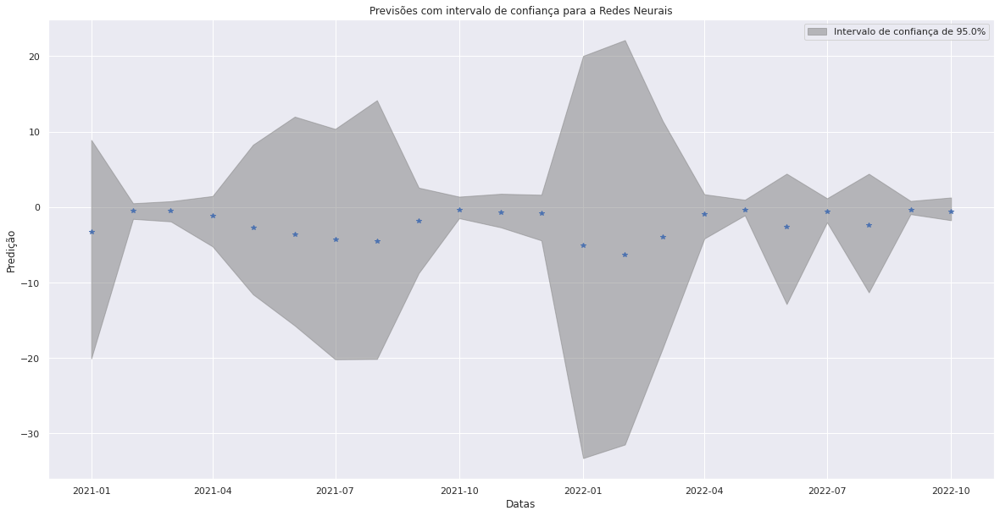

In [139]:
intervalo_redes = intervalo_predicao_bootstraps(x_treino,y_treino,model,x_teste,teste.index,predict_redes_teste,'Redes Neurais',n_bootstraps=10)

In [140]:
intervalo_redes

,Predicao,lower(2.5),upper(97.5)
2021-01-01,-3.32,-20.08,8.91
2021-02-01,-0.47,-1.56,0.51
2021-03-01,-0.50,-1.90,0.78
2021-04-01,-1.15,-5.21,1.46
2021-05-01,-2.74,-11.56,8.26
2021-06-01,-3.56,-15.71,11.99
2021-07-01,-4.33,-20.17,10.36
2021-08-01,-4.48,-20.13,14.17
2021-09-01,-1.80,-8.75,2.58
2021-10-01,-0.40,-1.47,1.38


##Predicao valores

In [141]:
dados_predicao

,rendimento_real_medio,pessoas_forca_trabalho,taxa_desocupacao,caged,ibovespa,ltn,exportacoes,importacoes,m_1,taxa_cambio,...,indice_confianca_exportadores,indice_tendencia_emprego,indice_confianca_consumidor,capacidade_instalada,indice_condicoes_economicas,Garantia_Imóveis,vendas_veilculos,indicador_comercio_prazo,volume_varejo,dummy_covid
2022-11-01,27.00,-250.00,-0.20,135495.00,-3.06,0.72,818.07,-1841.24,-150.37,0.02,...,-14.20,-13.10,-0.07,-0.90,7.04,-0.03,15815.00,1847706.93,5.25,0
2022-12-01,6.00,-492.00,-0.20,-431011.00,0.50,-0.09,-1316.72,441.03,33197.69,-0.03,...,-16.70,12.60,-0.05,-0.20,7.34,-0.03,941.00,1845577.44,16.46,0
2023-01-01,1.60,-21.56,-0.01,85823.44,0.91,-0.28,-3787.85,-2085.36,-17582.09,-0.04,...,-12.90,0.50,-0.12,-0.80,4.69,0.02,-62929.00,1844394.01,-1.13,0
2023-02-01,1.22,-9.87,-0.00,88091.51,0.91,-0.10,-2712.29,-117.76,2008.14,-0.03,...,-11.47,-0.38,-0.05,0.23,0.16,0.02,3265.77,1843696.39,0.92,0
2023-03-01,0.69,-4.51,-0.00,87875.48,0.91,-0.03,-1747.41,1450.39,2008.14,-0.00,...,-11.10,-0.28,0.01,0.14,-0.15,0.02,1294.93,1843248.26,-0.18,0


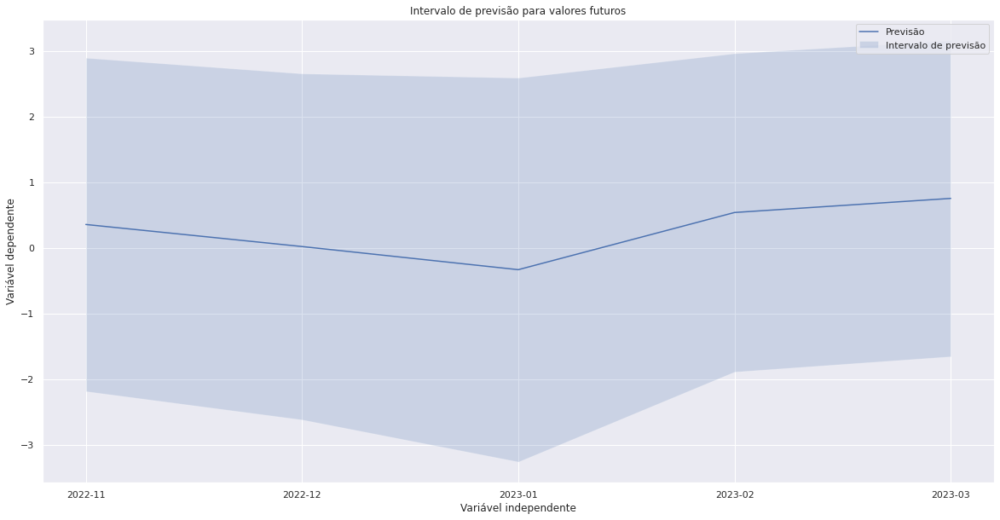

In [142]:
import numpy as np
import matplotlib.pyplot as plt

# gerar a faixa de valores de predição
X_pred = np.linspace(0, 10, 100).reshape(-1, 1) # aqui estamos gerando 100 pontos igualmente espaçados entre 0 e 10

# fazer as previsões para a faixa de valores
predicao_lasso = lasso.predict(dados_predicao.values)

# calcular o desvio padrão dos resíduos
desvio_padrao_residuos = np.std(residuo_lasso)

# calcular o intervalo de previsão para a faixa de valores
nivel_confianca = 0.95
z = 1.96 # valor crítico para um nível de confiança de 95%
intervalo_previsao = z * desvio_padrao_residuos * np.sqrt(1 + np.diag(np.dot(dados_predicao.values, np.dot(np.linalg.inv(np.dot(x_treino.T, x_treino)), dados_predicao.values.T))))

index = dados_predicao.index.strftime('%Y-%m')
intervalos = pd.DataFrame()
intervalos['predicao'] = predicao_lasso
intervalos['nivel_baixo'] = (predicao_lasso - intervalo_previsao)
intervalos['nivel_alto'] = (predicao_lasso + intervalo_previsao) 

index = dados_predicao.index.strftime('%Y-%m')
# plotar a faixa de valores e o intervalo de previsão correspondente
plt.plot(index, predicao_lasso, label='Previsão')
plt.fill_between(index,predicao_lasso - intervalo_previsao, predicao_lasso + intervalo_previsao, alpha=0.2, label='Intervalo de previsão')
plt.legend()
plt.xlabel('Variável independente')
plt.ylabel('Variável dependente')
plt.title('Intervalo de previsão para valores futuros')
plt.show()


In [143]:
intervalos

,predicao,nivel_baixo,nivel_alto
0,0.36,-2.19,2.90
1,0.02,-2.62,2.66
2,-0.33,-3.26,2.59
3,0.54,-1.89,2.96
4,0.75,-1.65,3.16


In [144]:
def intervalo_predicao(residuo,dados_predicao,x_treino,predicao,nivel_confianca):
  import numpy as np
  import matplotlib.pyplot as plt

  # gerar a faixa de valores de predição
  X_pred = np.linspace(0, 10, 100).reshape(-1, 1) # aqui estamos gerando 100 pontos igualmente espaçados entre 0 e 10

  # calcular o desvio padrão dos resíduos
  desvio_padrao_residuos = np.std(residuo)

  # calcular o intervalo de previsão para a faixa de valores
  # calcular o intervalo de previsão para a faixa de valores
  z = 0.0
  if nivel_confianca == 0.95:
    z = 1.96 # valor crítico para um nível de confiança de 95%
  elif nivel_confianca == 0.90:
    z = 1.645 # valor crítico para um nível de confiança de 90%
  else:
    z = 1.0 # valor crítico para um nível de confiança de 68%

  intervalo_previsao = z * desvio_padrao_residuos * np.sqrt(1 + np.diag(np.dot(dados_predicao.values, np.dot(np.linalg.inv(np.dot(x_treino.T, x_treino)), dados_predicao.values.T))))
  
  index = dados_predicao.index.strftime('%Y-%m')
  intervalos = pd.DataFrame()
  intervalos['predicao'] = predicao
  intervalos[f'nivel_baixo({nivel_confianca})'] = (predicao - intervalo_previsao)
  intervalos[f'nivel_alto({nivel_confianca})'] = (predicao + intervalo_previsao) 
    # plotar a faixa de valores e o intervalo de previsão correspondente
  plt.plot(index, predicao, label='Previsão')
  plt.fill_between(index,predicao - intervalo_previsao, predicao + intervalo_previsao, alpha=0.2, label='Intervalo de previsão')
  plt.legend()
  plt.xlabel('Variável independente')
  plt.ylabel('Variável dependente')
  plt.title(f'Intervalo de previsão para valores futuros de {nivel_confianca}')
  plt.show()

  return intervalos

/usr/local/lib/python3.8/dist-packages/sklearn/base.py:413: UserWarning: X has feature names, but Lasso was fitted without feature names
  warnings.warn(


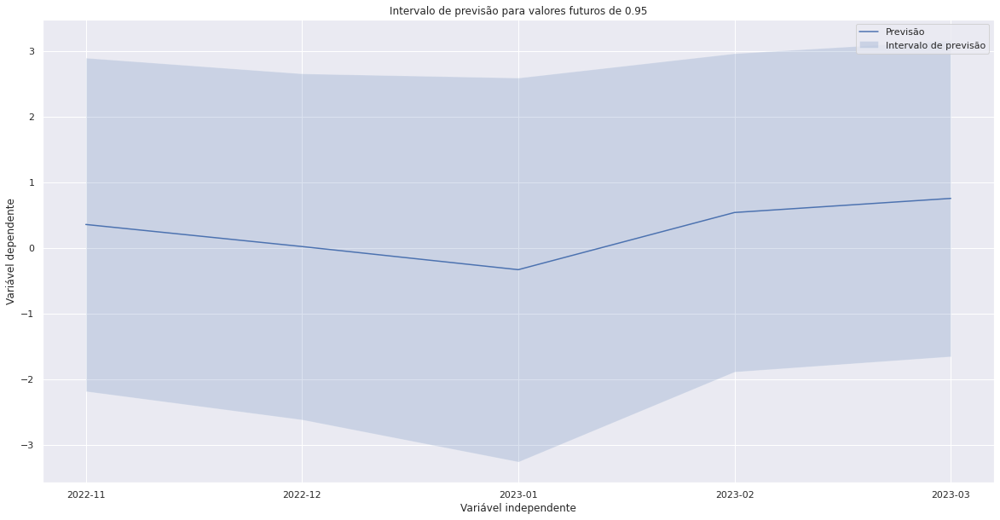

,predicao,nivel_baixo(0.95),nivel_alto(0.95)
0,0.36,-2.19,2.90
1,0.02,-2.62,2.66
2,-0.33,-3.26,2.59
3,0.54,-1.89,2.96
4,0.75,-1.65,3.16


In [145]:
predicao_lasso = lasso.predict(dados_predicao)
intervalos_lasso = intervalo_predicao(residuo_lasso,dados_predicao,x_treino,predicao_lasso,0.95)
intervalos_lasso

/usr/local/lib/python3.8/dist-packages/sklearn/base.py:413: UserWarning: X has feature names, but RandomForestRegressor was fitted without feature names
  warnings.warn(


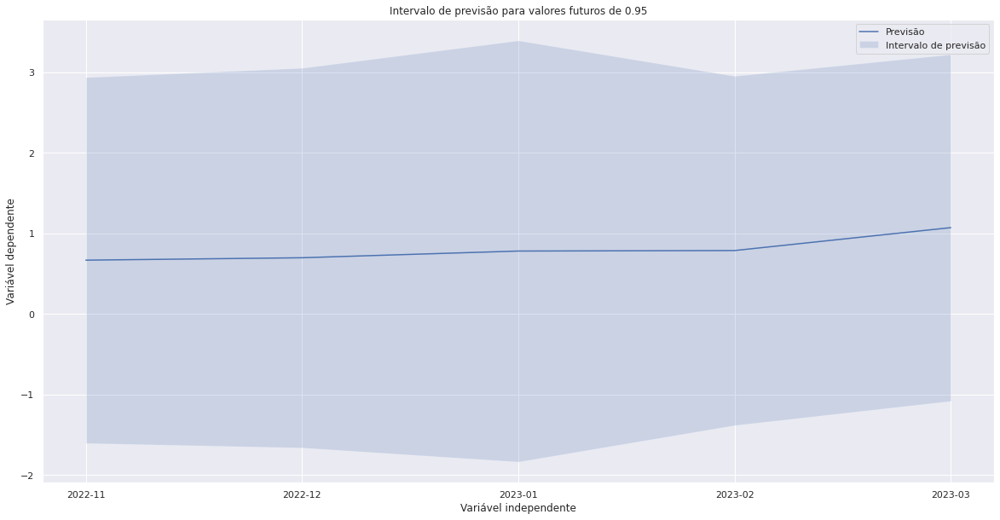

,predicao,nivel_baixo(0.95),nivel_alto(0.95)
0,0.67,-1.60,2.94
1,0.70,-1.66,3.05
2,0.78,-1.83,3.39
3,0.79,-1.38,2.95
4,1.07,-1.08,3.22


In [146]:
predicao_random = rfr.predict(dados_predicao)
intervalos_random = intervalo_predicao(residuo_random,dados_predicao,x_treino,predicao_random,0.95)
intervalos_random

/usr/local/lib/python3.8/dist-packages/sklearn/base.py:413: UserWarning: X has feature names, but GradientBoostingRegressor was fitted without feature names
  warnings.warn(


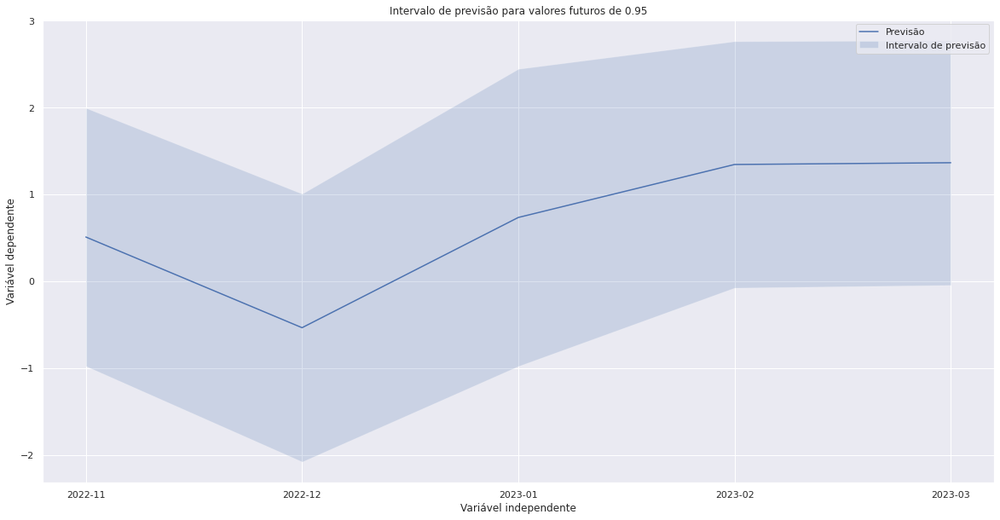

,predicao,nivel_baixo(0.95),nivel_alto(0.95)
0,0.51,-0.98,1.99
1,-0.53,-2.08,1.01
2,0.73,-0.98,2.44
3,1.34,-0.07,2.76
4,1.36,-0.04,2.77


In [147]:
predicao_boost = grad_bost.predict(dados_predicao)
intervalos_boost= intervalo_predicao(residuo_grad,dados_predicao,x_treino,predicao_boost,0.95)
intervalos_boost

1/1 [==============================] - 0s 360ms/step


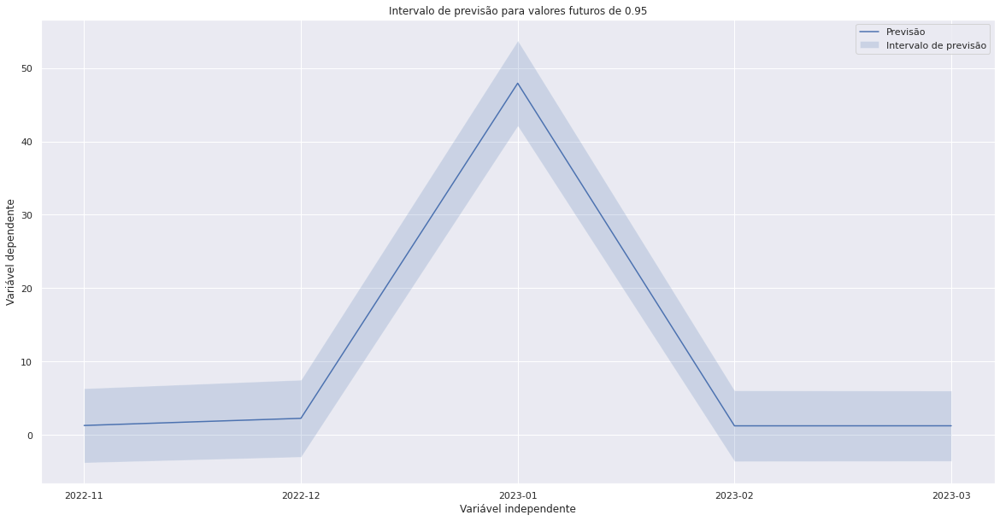

,predicao,nivel_baixo(0.95),nivel_alto(0.95)
0,1.29,-3.76,6.35
1,2.27,-2.98,7.52
2,47.93,42.11,53.75
3,1.25,-3.58,6.07
4,1.25,-3.54,6.04


In [148]:
predicao_redes = np.squeeze(model.predict(dados_predicao))
intervalos_redes= intervalo_predicao(residuo_neurais,dados_predicao,x_treino,predicao_redes,0.95)
intervalos_redes